In [8]:
import numpy as np
from aav_lipid_cluster import *
from aav_aavr_interaction import *
import MDAnalysis as mda
import matplotlib.pyplot as plt
%matplotlib inline


In [25]:
# For AAV2-AAVR system numbering
lipid_set_v2r = ["resname DPG3",
                 "resname POPE and resid 33645:37638",
                 "resname DOPE and resid 33645:37638",
                 "resname POPC and resid 33645:37638",
                 "resname DOPC and resid 33645:37638",
                 "resname CHOL and resid 33645:37638",
                 "resname POP2",
                 "resname POPS",
                 "resname DOPS",
                 "resname POPE and resid 37639:41681",
                 "resname DOPE and resid 37639:41681",
                 "resname POPC and resid 37639:41681",
                 "resname DOPC and resid 37639:41681",
                 "resname CHOL and resid 37639:41681"]
lipid_names_v2r = ["DPG3",
                   "POPE_Upper",
                   "DOPE_Upper",
                   "POPC_Upper",
                   "DOPC_Upper",
                   "CHOL_Upper",
                   "POP2",
                   "POPS",
                   "DOPS",
                   "POPE_Lower",
                   "DOPE_Lower",
                   "POPC_Lower",
                   "DOPC_Lower",
                   "CHOL_Lower"]

# For AAV2-only system numbering
lipid_set_v2m = ["resname DPG3",
                 "resname POPE and resid 31021:35243",
                 "resname DOPE and resid 31021:35243",
                 "resname POPC and resid 31021:35243",
                 "resname DOPC and resid 31021:35243",
                 "resname CHOL and resid 31021:35243",
                 "resname POP2",
                 "resname POPS",
                 "resname DOPS",
                 "resname POPE and resid 35244:39466",
                 "resname DOPE and resid 35244:39466",
                 "resname POPC and resid 35244:39466",
                 "resname DOPC and resid 35244:39466",
                 "resname CHOL and resid 35244:39466"]
lipid_names_v2m = ["DPG3",
                   "POPE_Upper",
                   "DOPE_Upper",
                   "POPC_Upper",
                   "DOPC_Upper",
                   "CHOL_Upper",
                   "POP2",
                   "POPS",
                   "DOPS",
                   "POPE_Lower",
                   "DOPE_Lower",
                   "POPC_Lower",
                   "DOPC_Lower",
                   "CHOL_Lower"]

# For AAVR-only system numbering
lipid_set_r4m = ["resname DPG3",
                 "resname POPE and resid 2625:6590",
                 "resname DOPE and resid 2625:6590",
                 "resname POPC and resid 2625:6590",
                 "resname DOPC and resid 2625:6590",
                 "resname CHOL and resid 2625:6590",
                 "resname POP2",
                 "resname POPS",
                 "resname DOPS",
                 "resname POPE and resid 6591:10618",
                 "resname DOPE and resid 6591:10618",
                 "resname POPC and resid 6591:10618",
                 "resname DOPC and resid 6591:10618",
                 "resname CHOL and resid 6591:10618"]
lipid_names_r4m = ["DPG3",
                   "POPE_Upper",
                   "DOPE_Upper",
                   "POPC_Upper",
                   "DOPC_Upper",
                   "CHOL_Upper",
                   "POP2",
                   "POPS",
                   "DOPS",
                   "POPE_Lower",
                   "DOPE_Lower",
                   "POPC_Lower",
                   "DOPC_Lower",
                   "CHOL_Lower"]

## AAV-AAVR Repeat 1

In [15]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r1/v2r1_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r1/v2r1_nosolv.xtc')
Repeat = 1
System = "v2r"

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

In [39]:
## Modified version of CCF_plot function so it doesn't save plot immediately.
def CCF_plot2(xcorr_matrix, name):
    plt.plot(np.arange(0,10.001,0.001),xcorr_matrix,color='purple')
    plt.xlabel("Time ($\mu$s)")
    plt.ylabel(f"Cross-Correlation Coefficient\nbetween $\Delta$z and {name} lipid beads count")

    CC_rollingav = []
    for i in range(len(xcorr_matrix)):
        rollingav = xcorr_matrix[i:i+50].mean()
        CC_rollingav.append(rollingav)
    CC_rollingav = np.array(CC_rollingav)

    plt.plot(np.arange(0,10.001,0.001), CC_rollingav,color='magenta')
    plt.ylim(-0.5,0.5)
    plt.show()

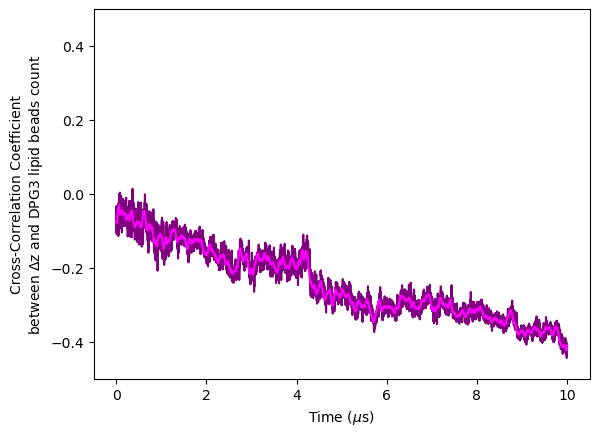

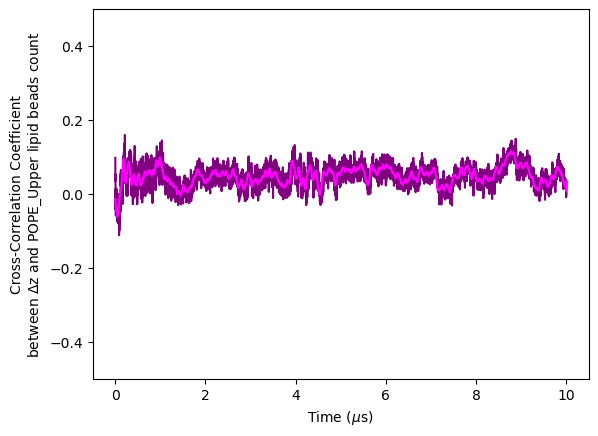

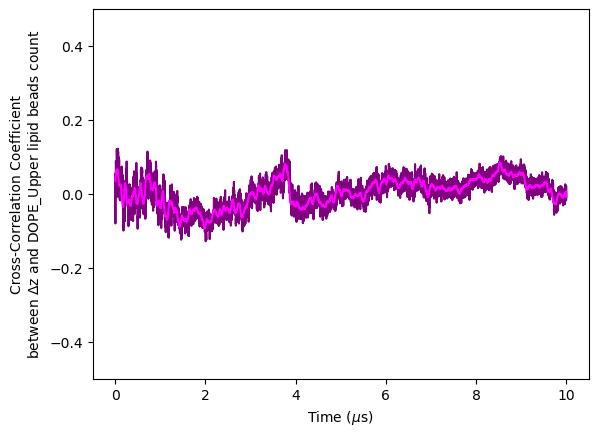

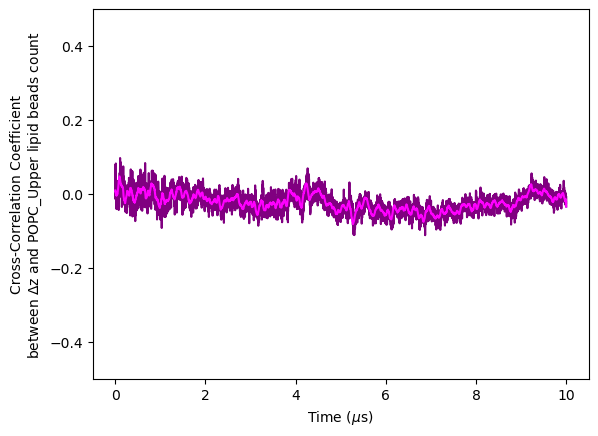

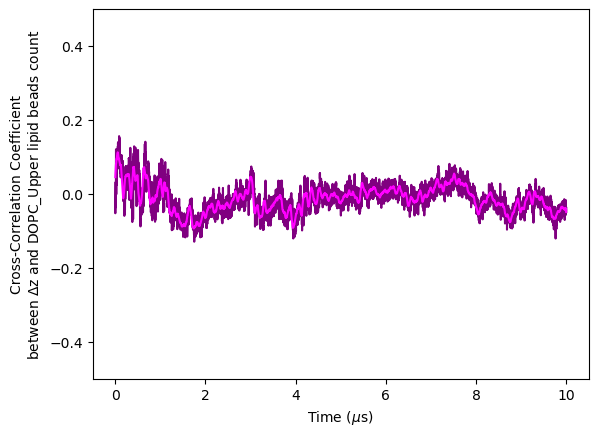

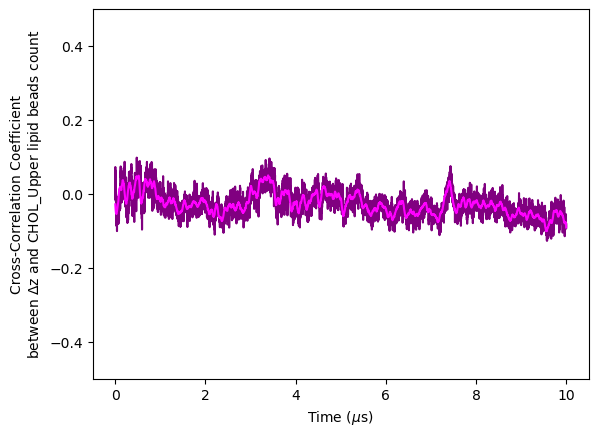

In [13]:
Layer_name = "Upper"
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 33645:37638")
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

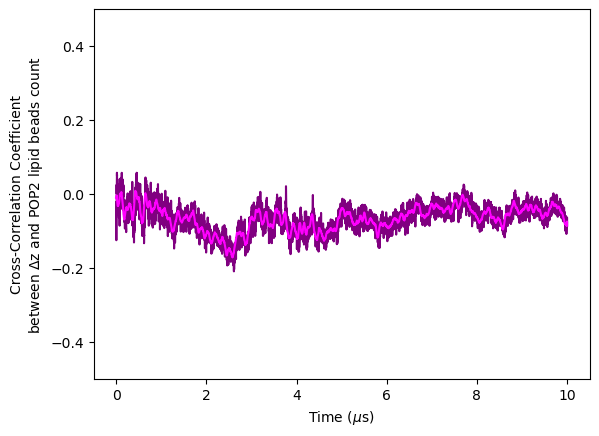

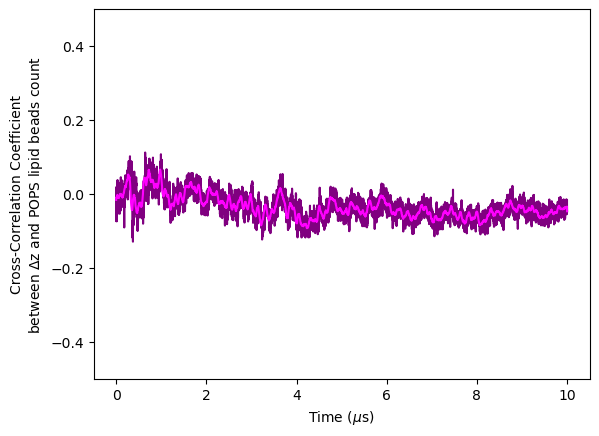

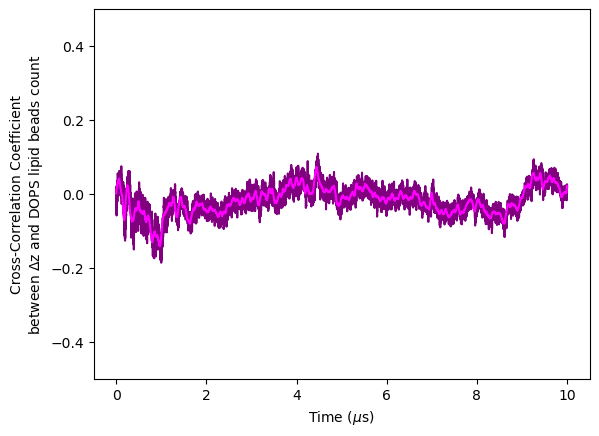

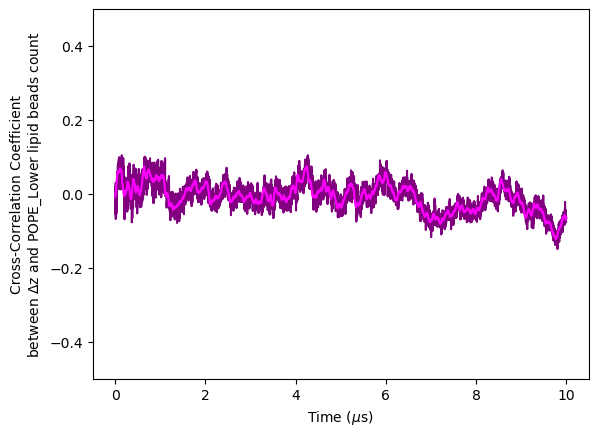

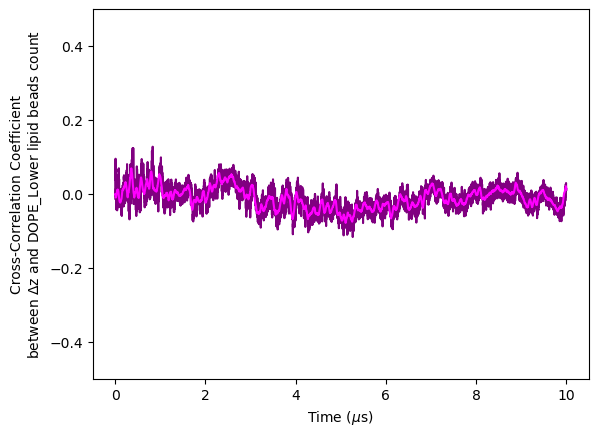

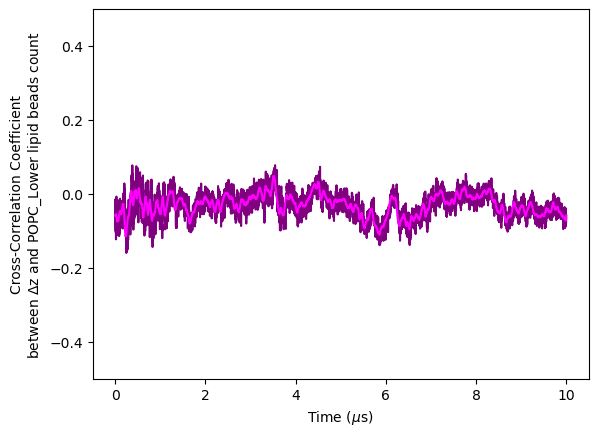

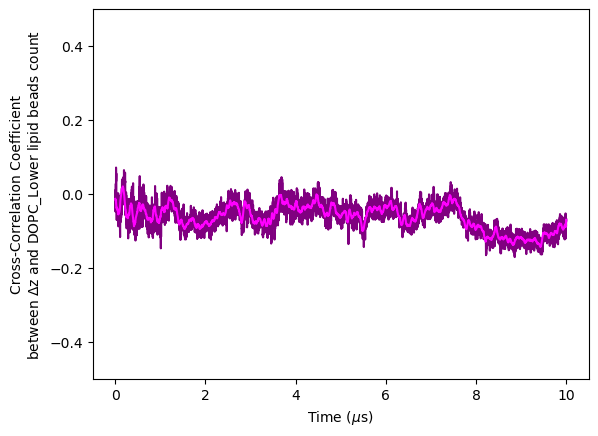

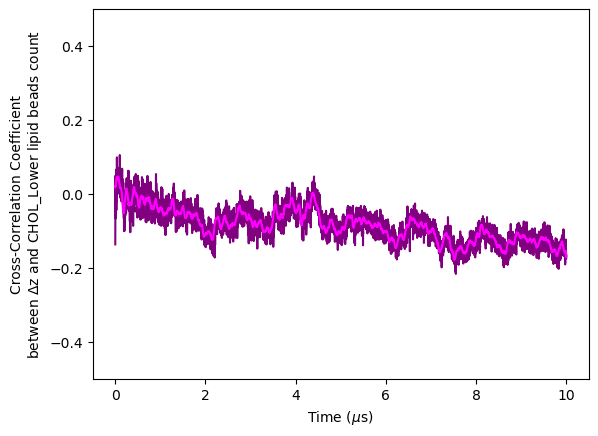

In [14]:
Layer_name = "Lower"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 37639:41681")
for i in range(6,14): 
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

In [23]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r2/v2r2_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r2/v2r2_nosolv.xtc')
Repeat = 2
System = "v2r"

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

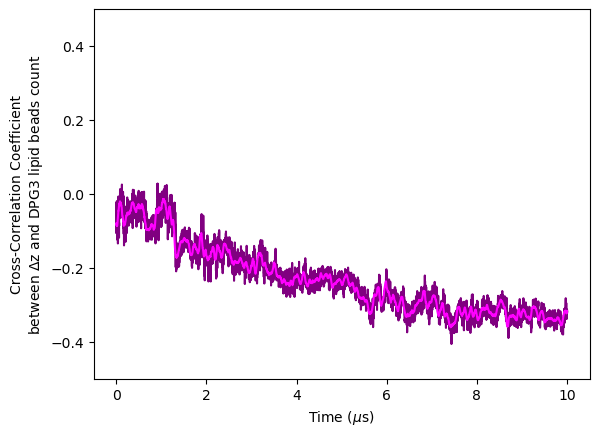

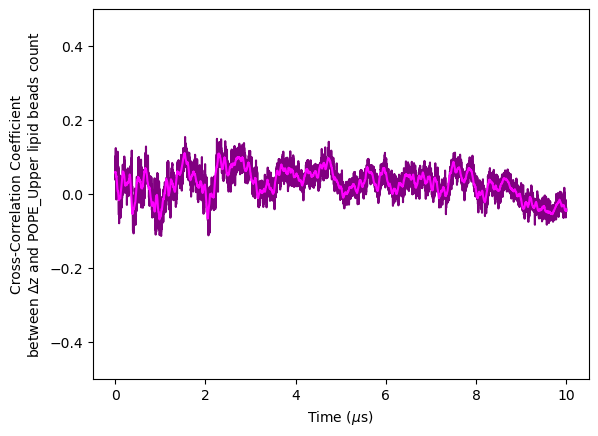

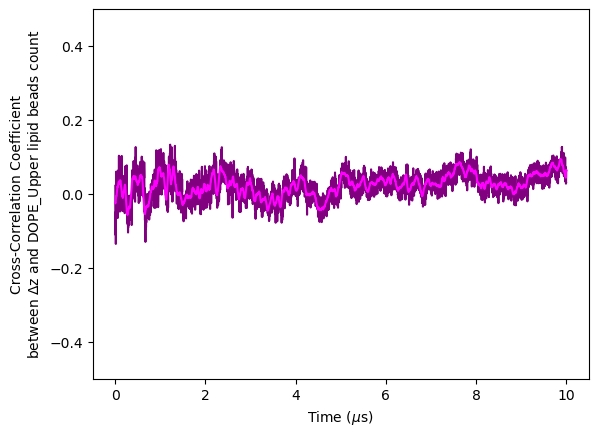

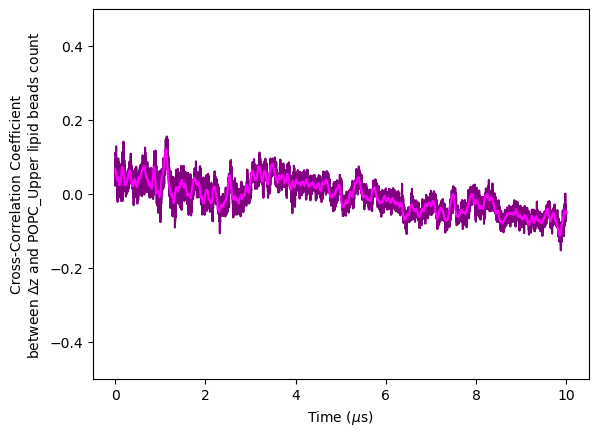

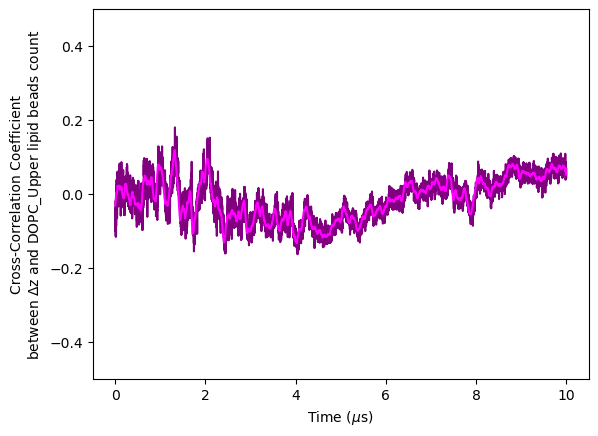

...

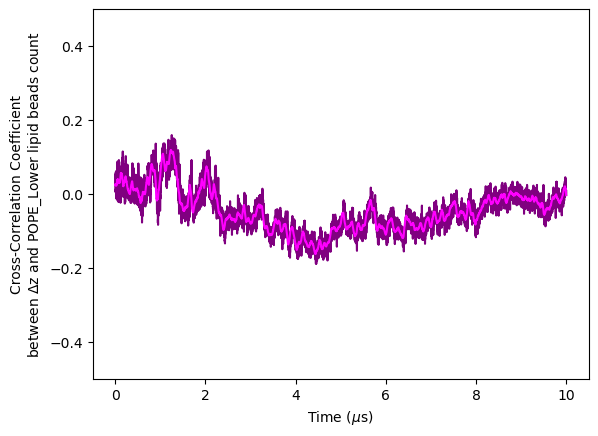

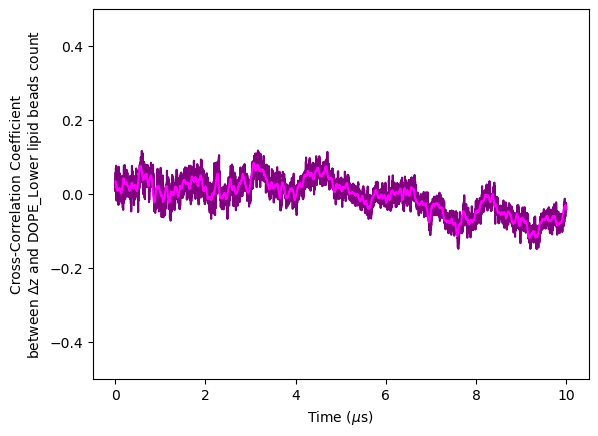

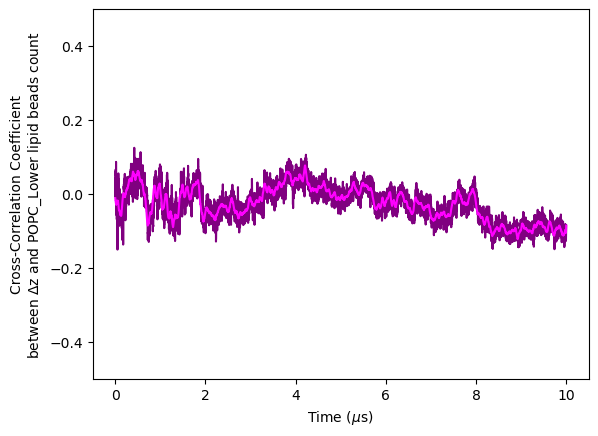

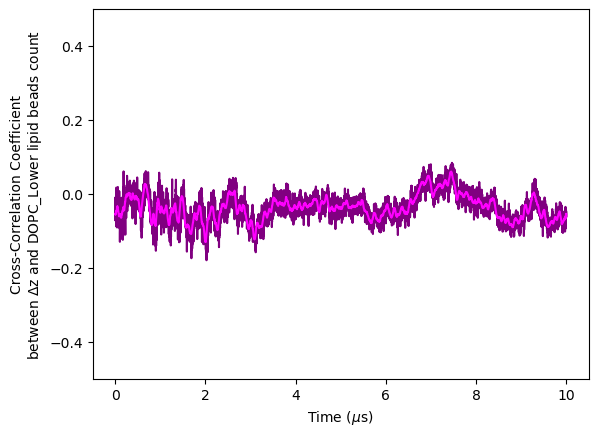

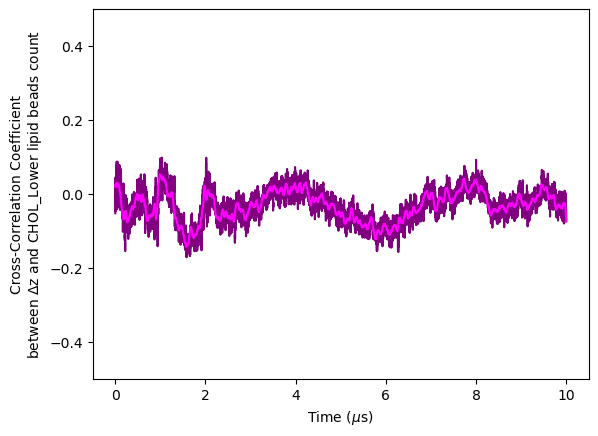

In [24]:
Layer_name = "Upper"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 33645:37638")
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

Layer_name = "Lower"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 37639:41681")
for i in range(6,14): 
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

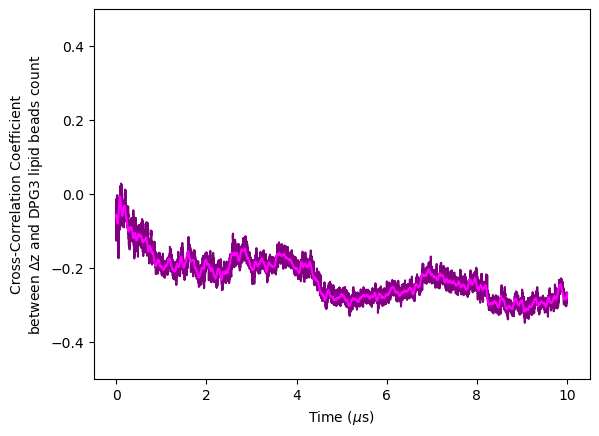

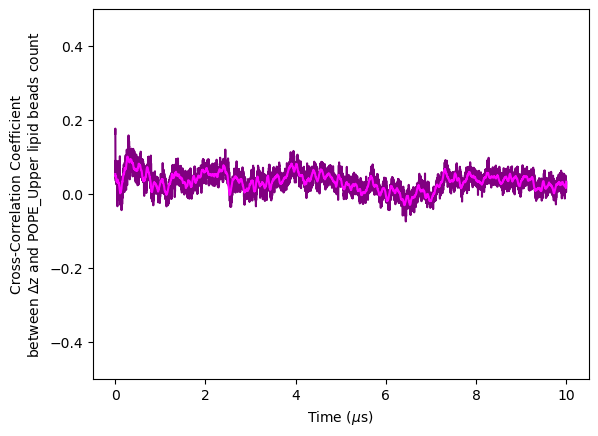

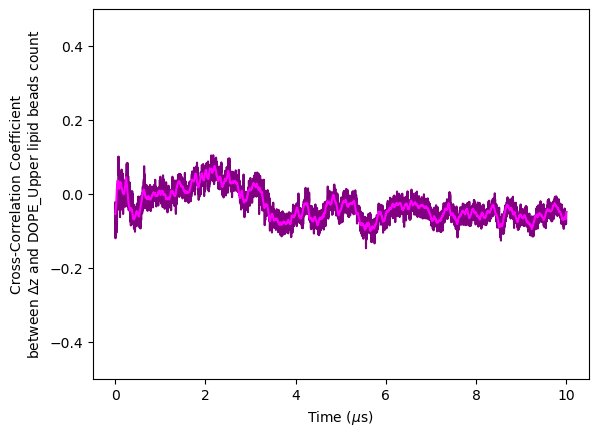

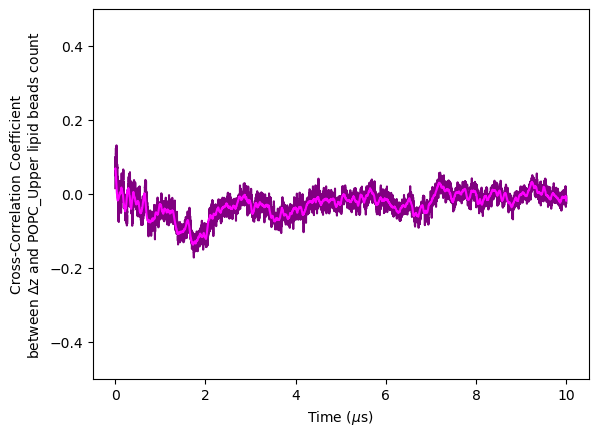

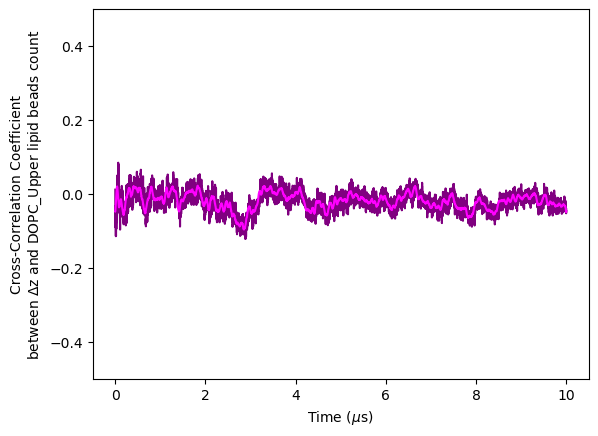

...

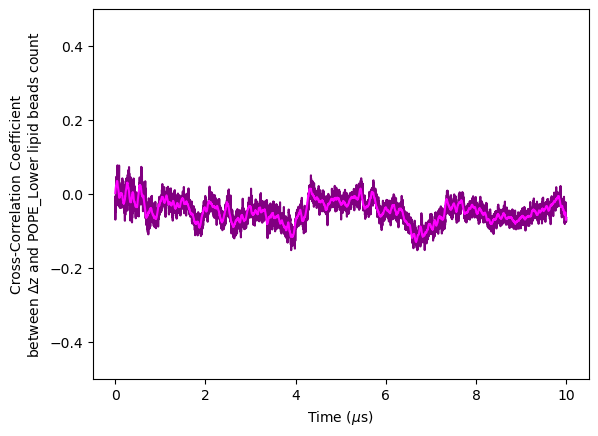

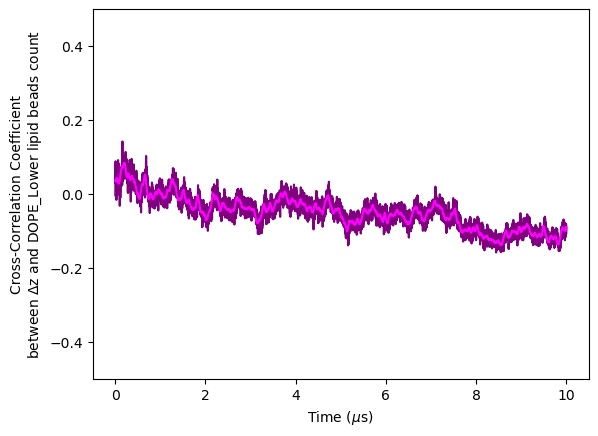

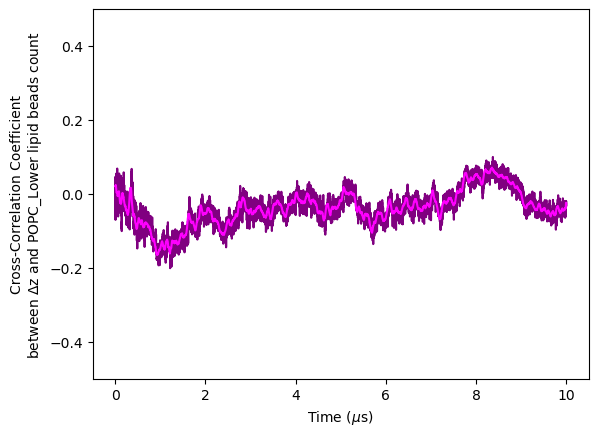

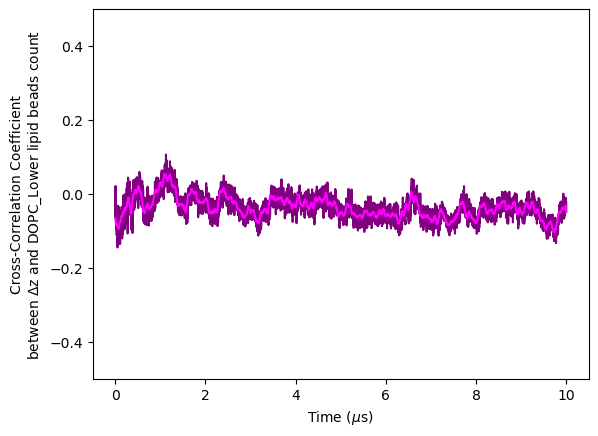

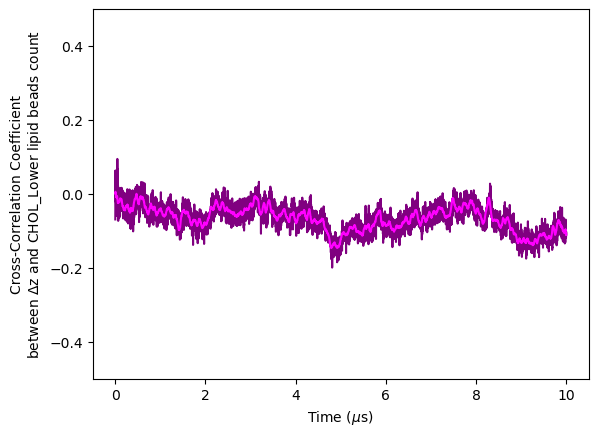

In [30]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r3/v2r3_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r3/v2r3_nosolv.xtc')
Repeat = 3
System = "v2r"

Layer_name = "Upper"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 33645:37638")
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

Layer_name = "Lower"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 37639:41681")
for i in range(6,14): 
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

# AAV2-only


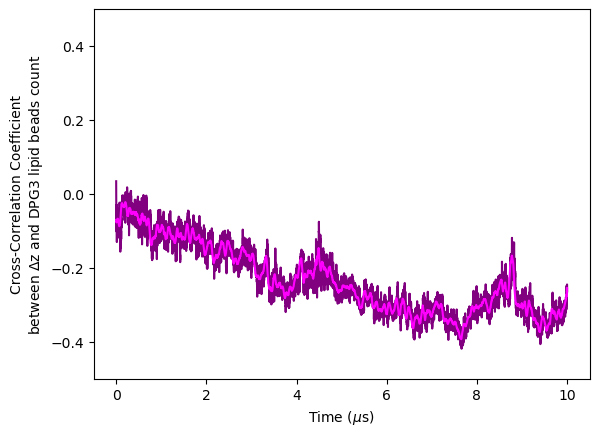

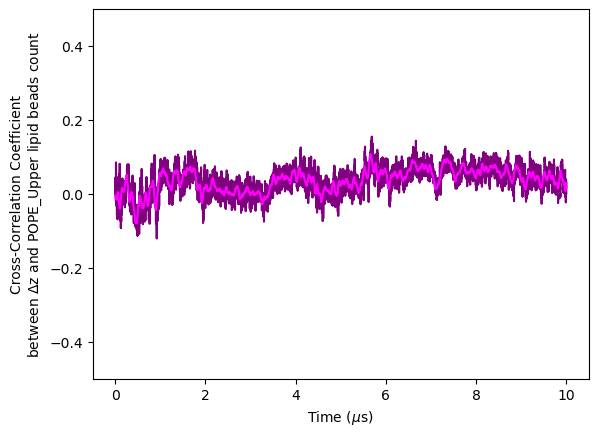

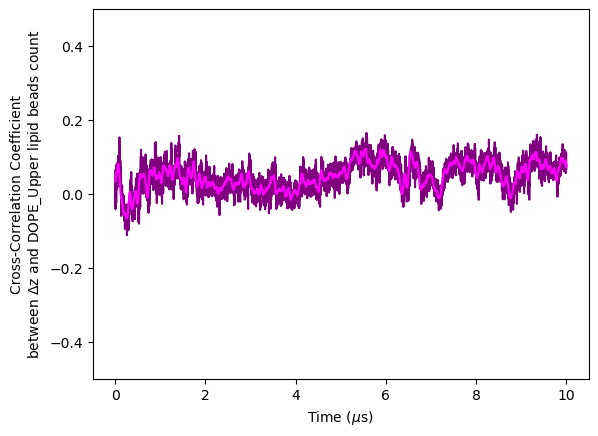

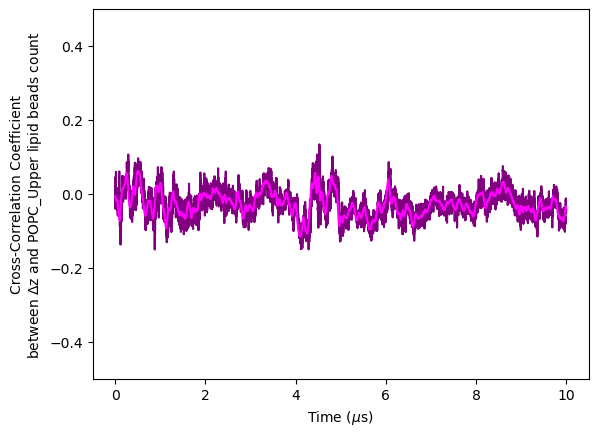

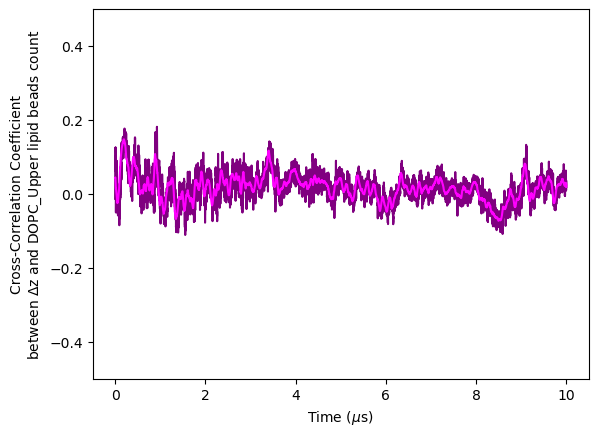

...

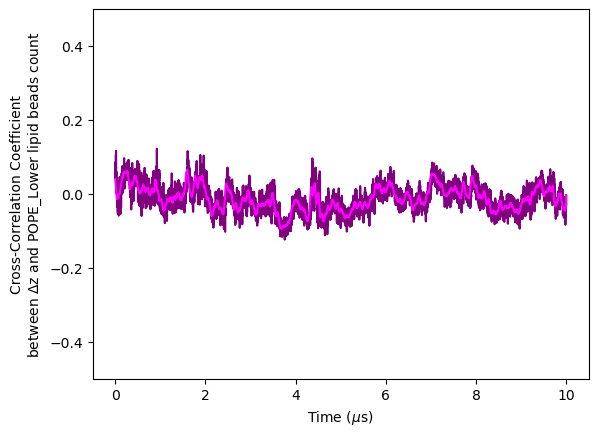

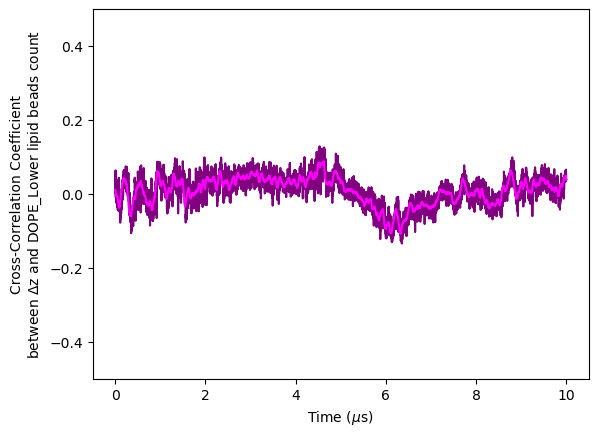

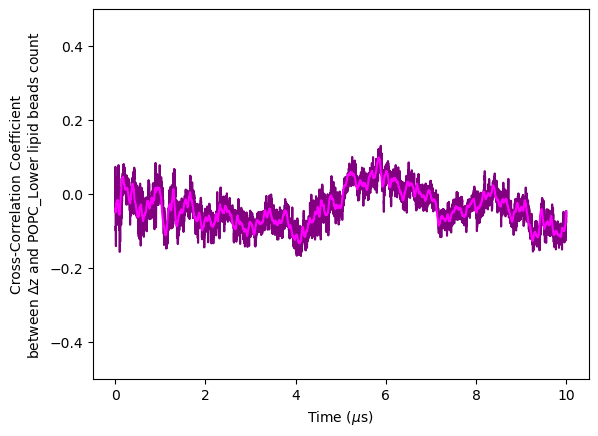

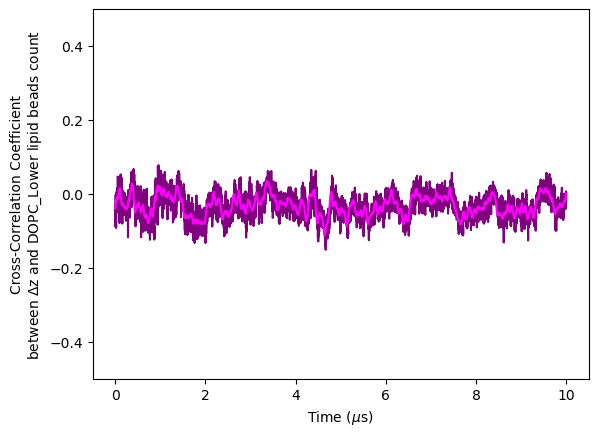

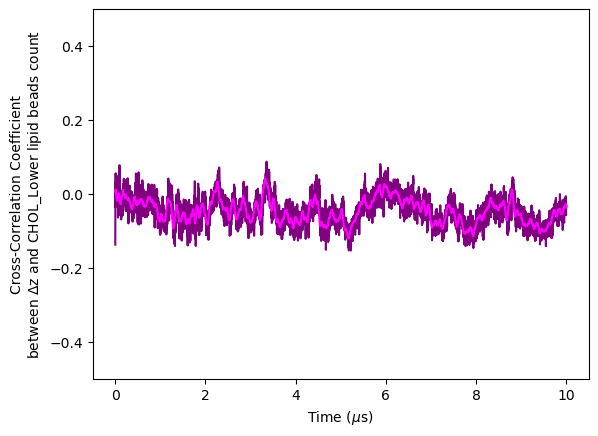

In [31]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m1/v2m1_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m1/v2m1_nosolv.xtc')
Repeat = 1
System = "v2m"

Layer_name = "Upper"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 31021:35243")
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

Layer_name = "Lower"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 35244:39466")
for i in range(6,14): 
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

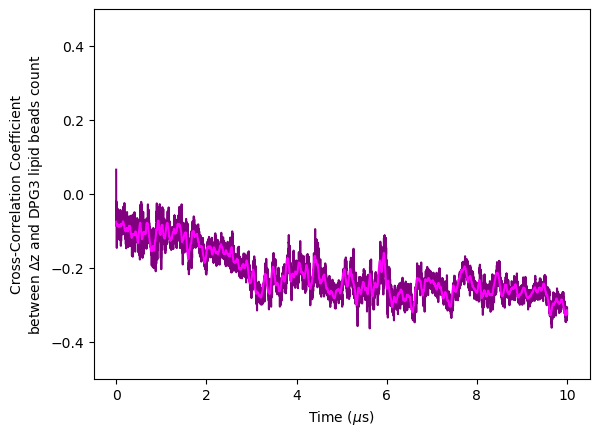

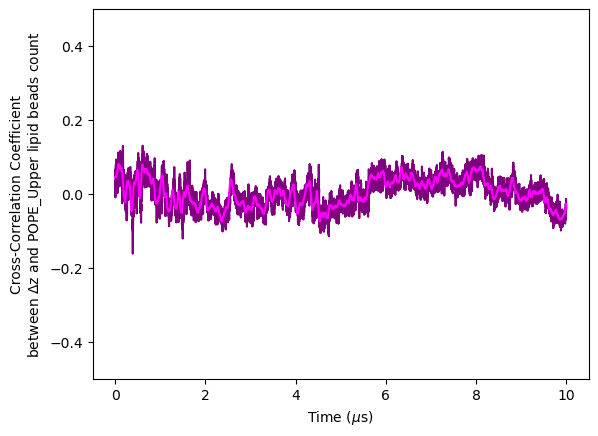

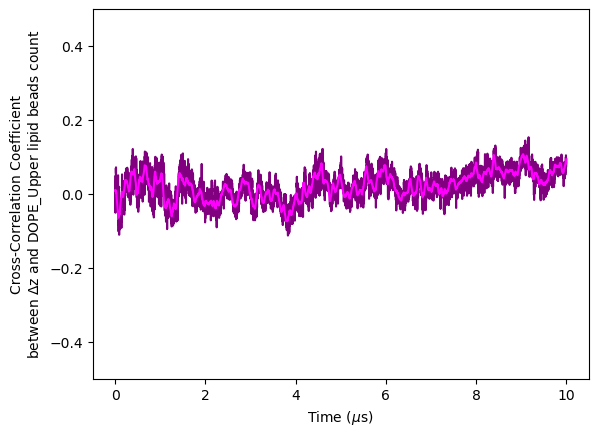

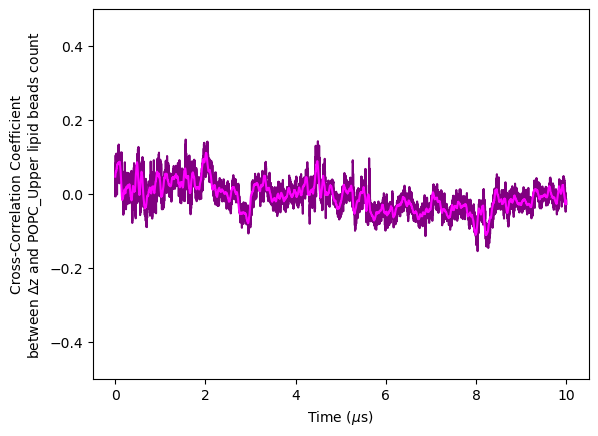

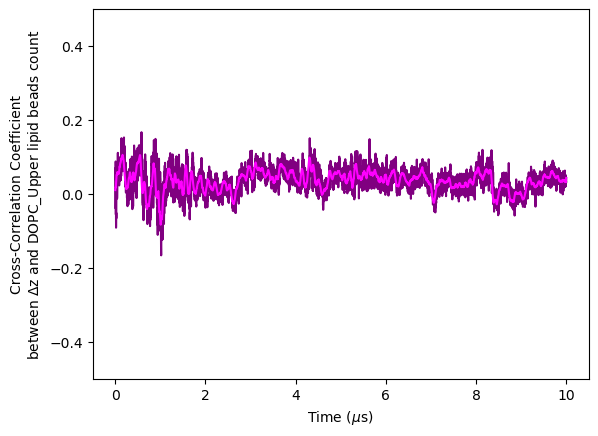

...

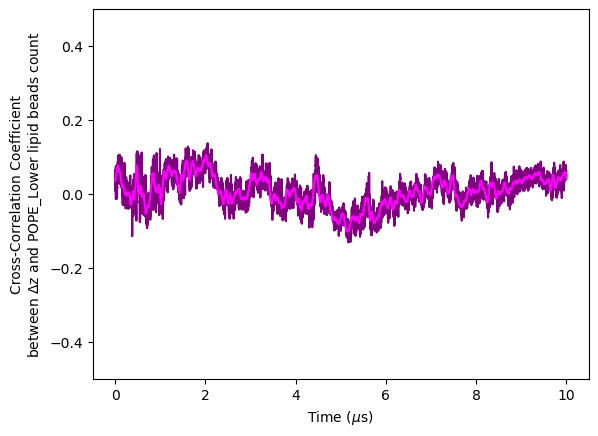

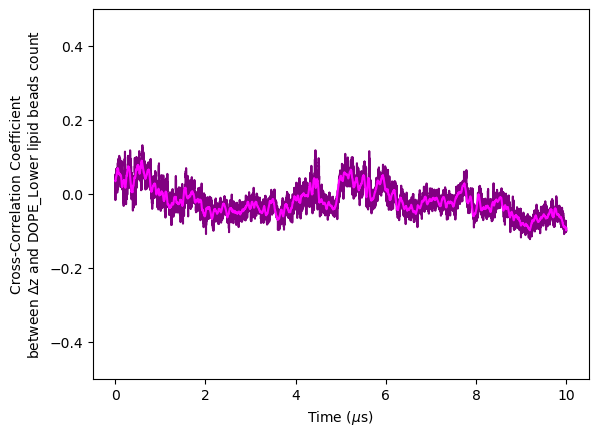

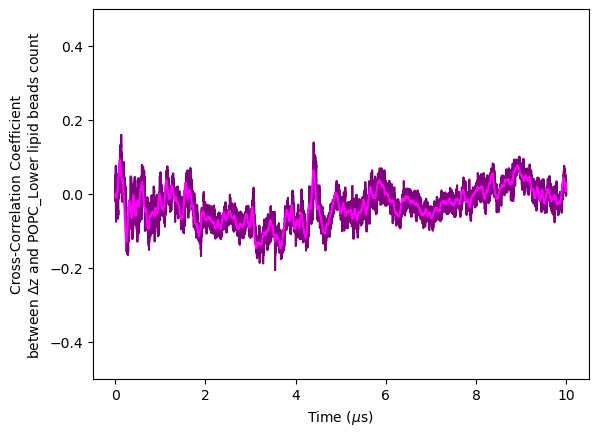

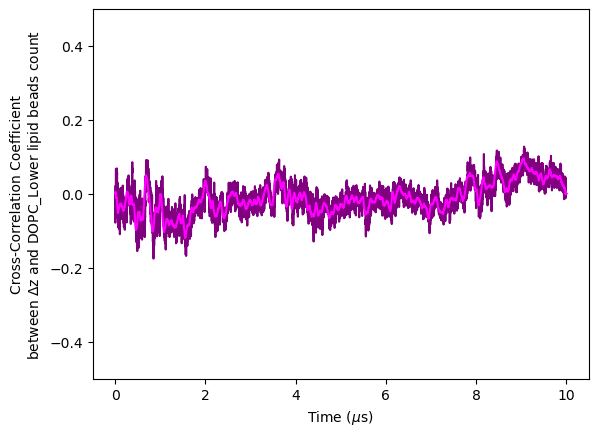

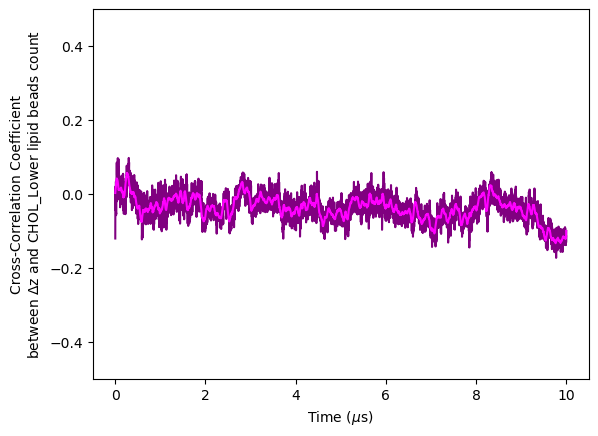

In [32]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m2/v2m2_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m2/v2m2_nosolv.xtc')
Repeat = 2
System = "v2m"

Layer_name = "Upper"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 31021:35243")
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

Layer_name = "Lower"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 35244:39466")
for i in range(6,14): 
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

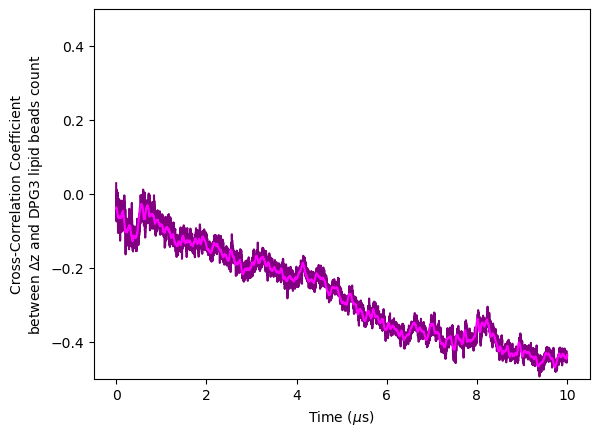

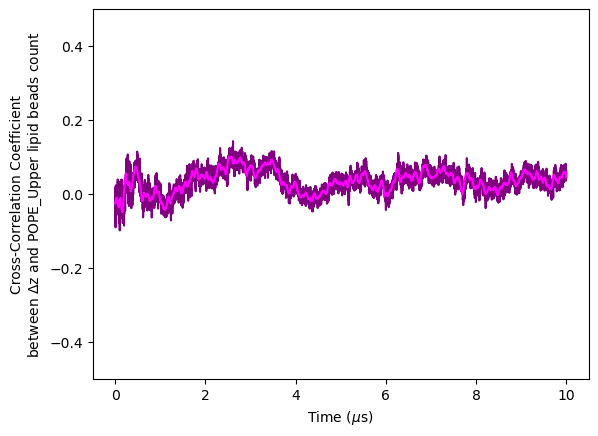

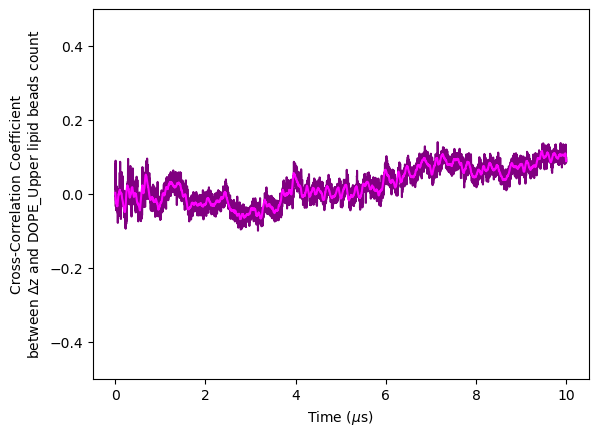

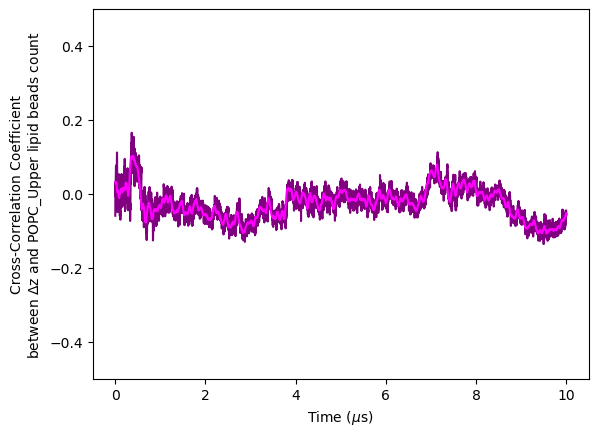

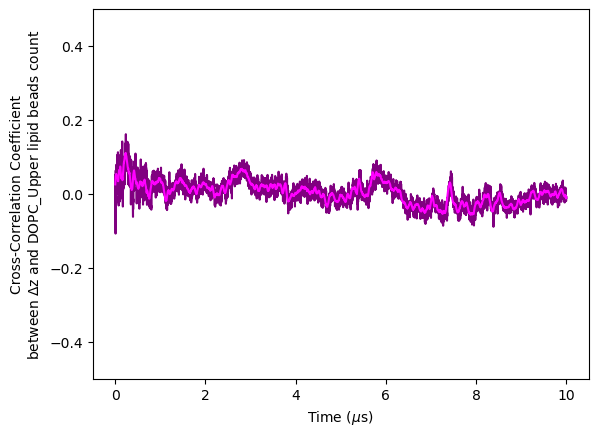

...

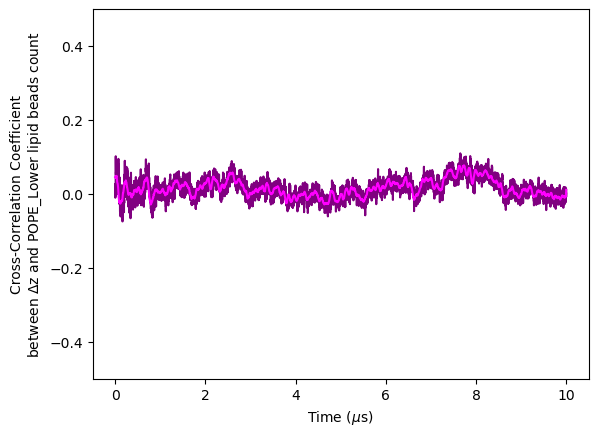

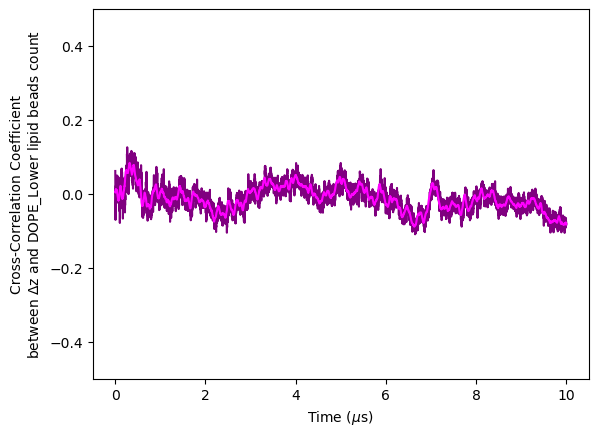

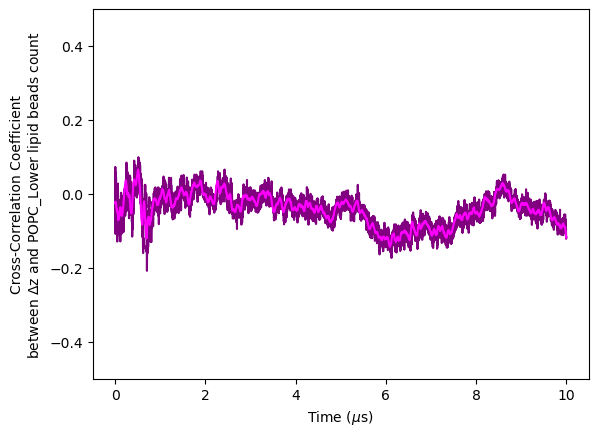

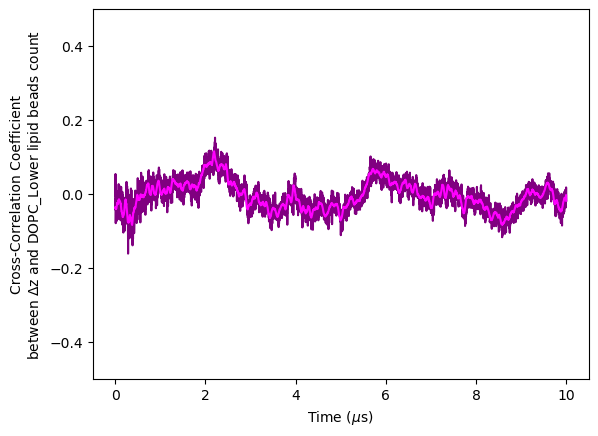

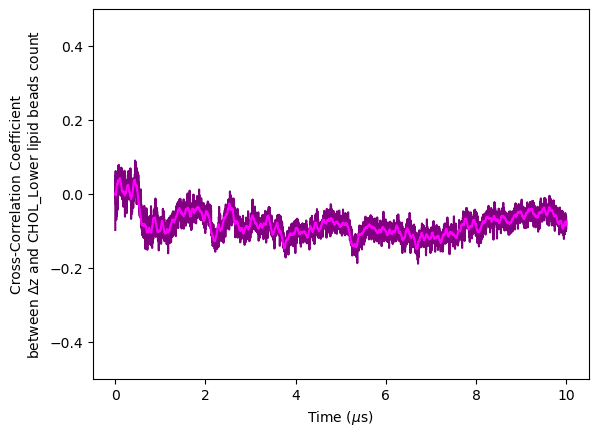

In [33]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m3/v2m3_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m3/v2m3_nosolv.xtc')
Repeat = 3
System = "v2m"

Layer_name = "Upper"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 31021:35243")
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

Layer_name = "Lower"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 35244:39466")
for i in range(6,14): 
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

# AAVR-only

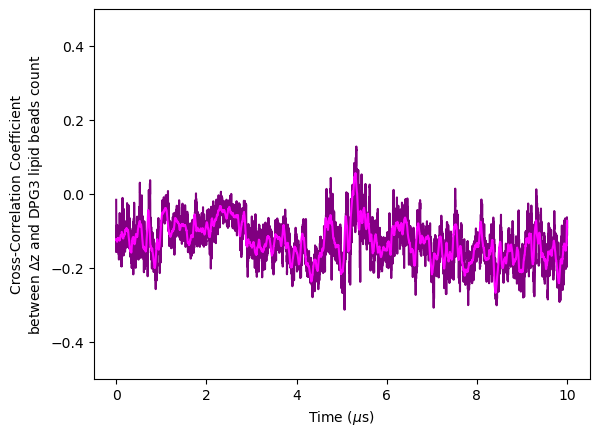

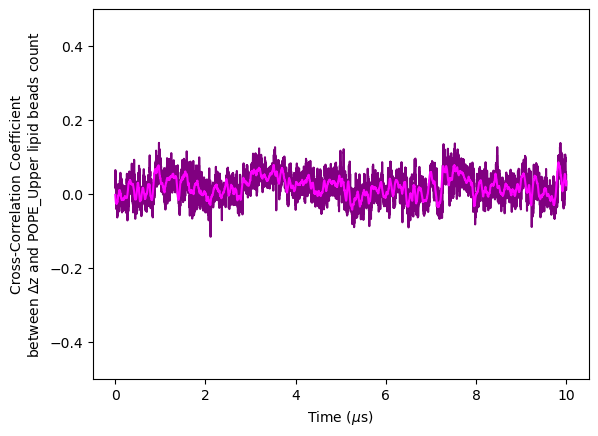

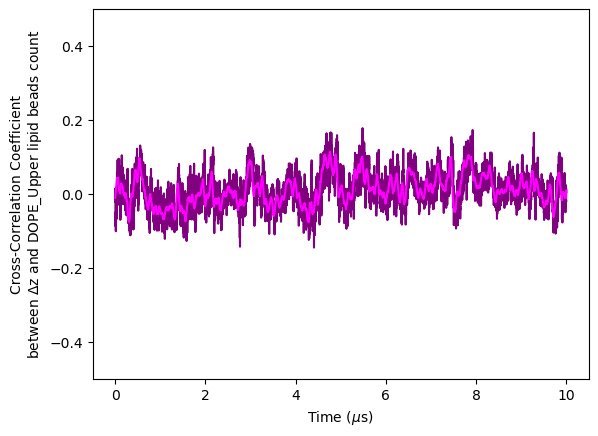

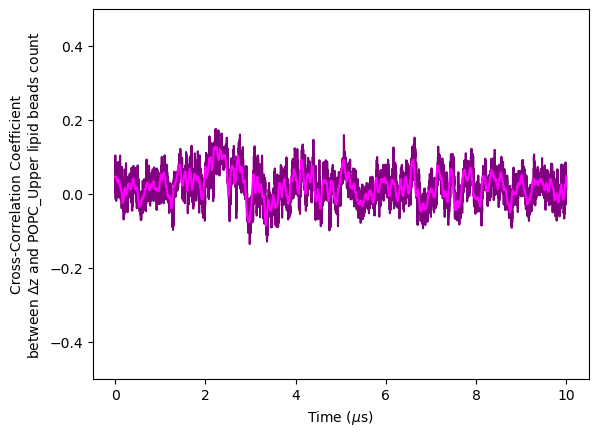

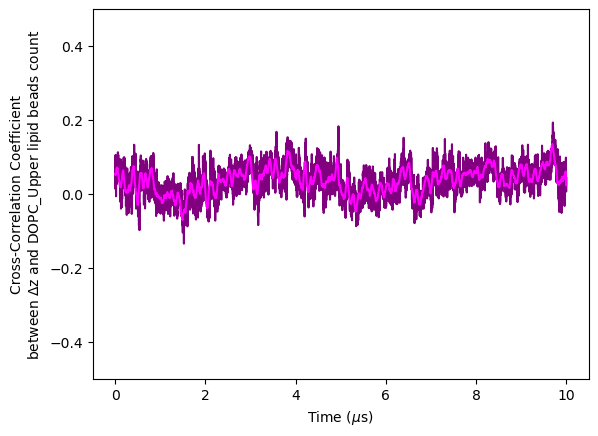

...

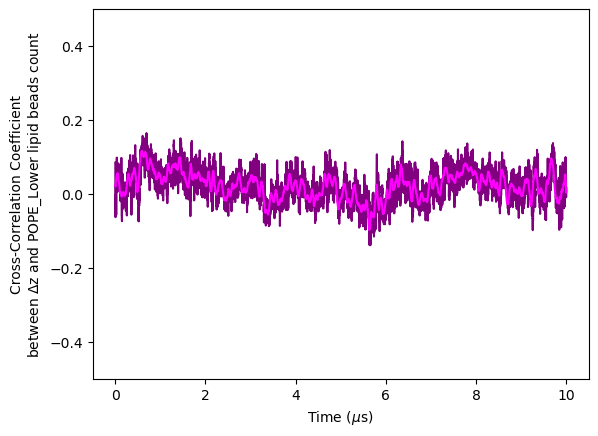

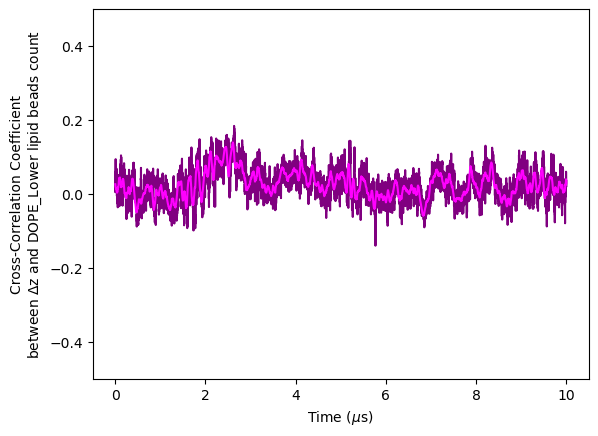

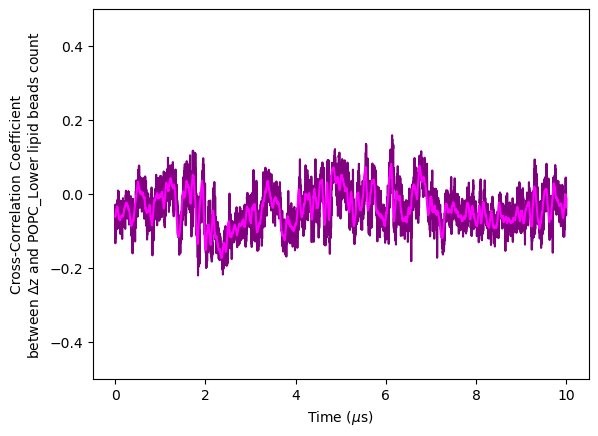

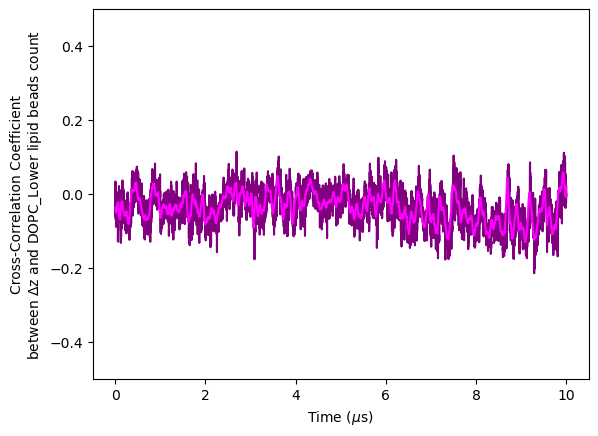

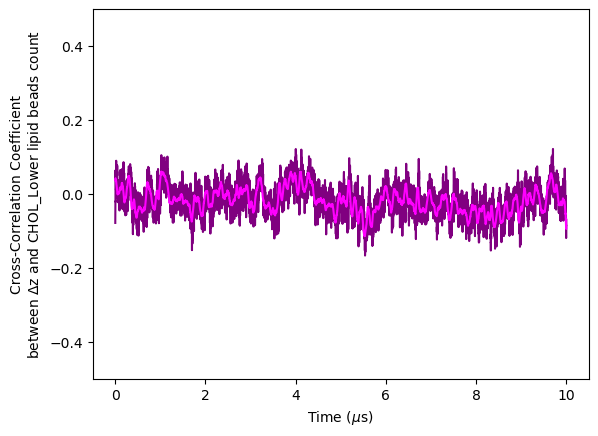

In [35]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m1/r4m1_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m1/r4m1_nosolv.xtc')
Repeat = 1
System = "r4m"

Layer_name = "Upper"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 2625:6590")
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

Layer_name = "Lower"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 6591:10618")
for i in range(6,14): 
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

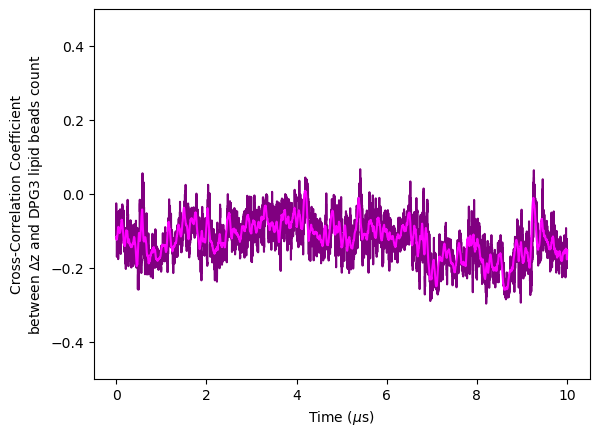

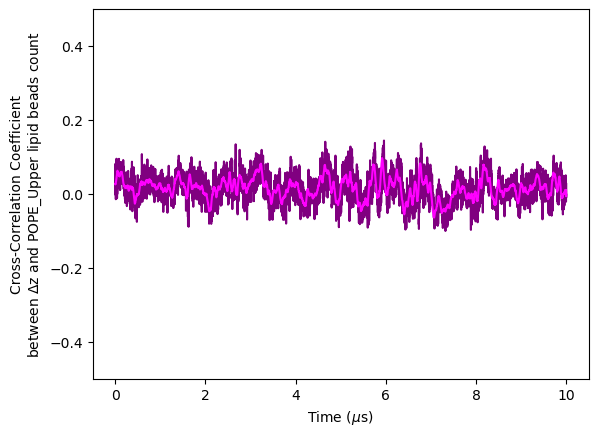

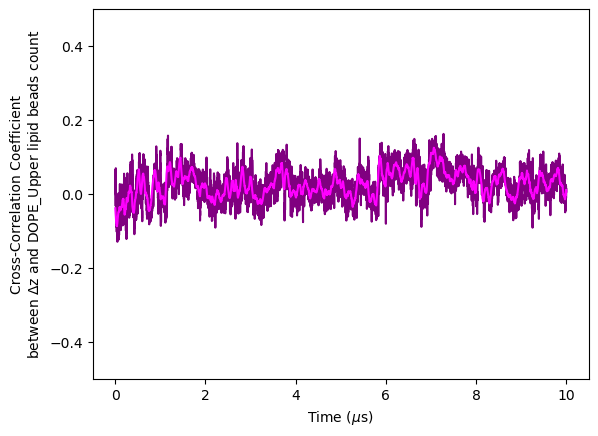

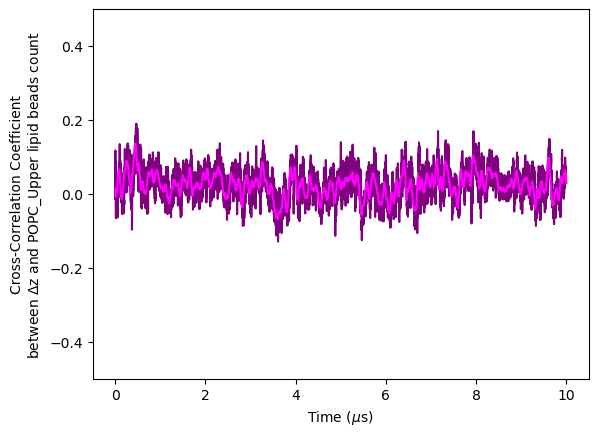

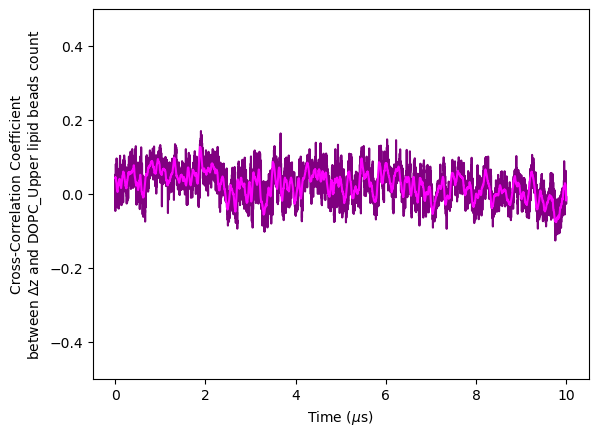

...

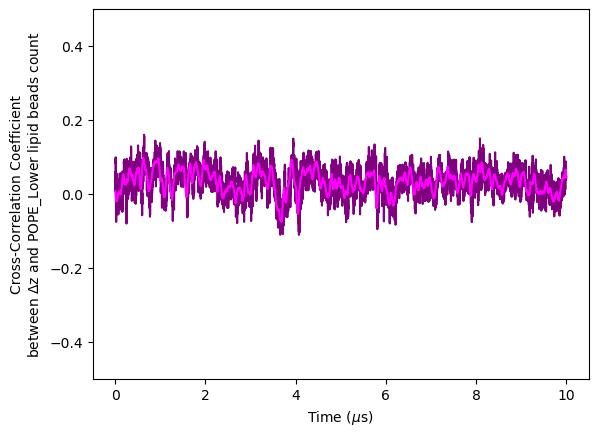

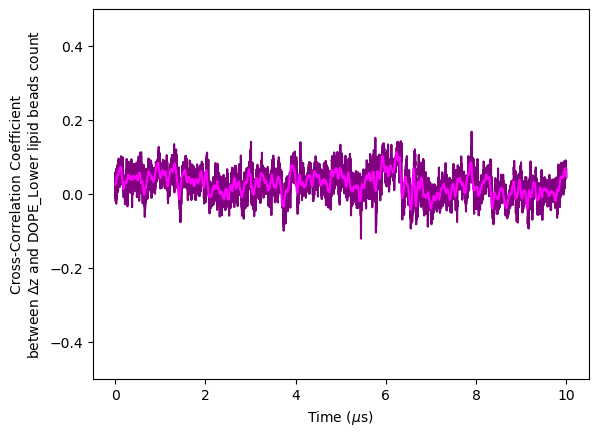

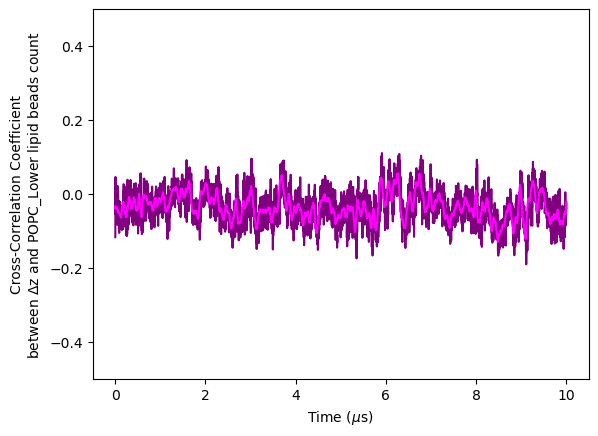

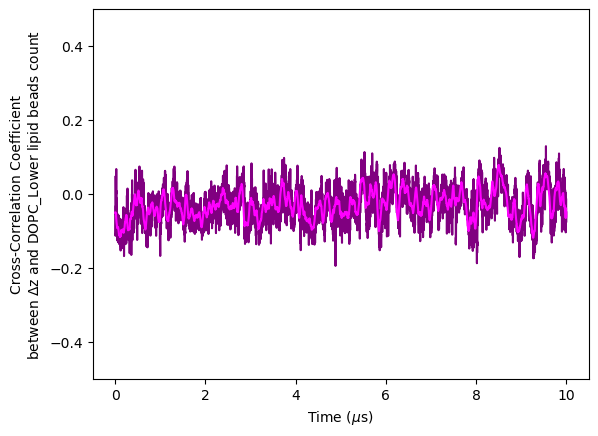

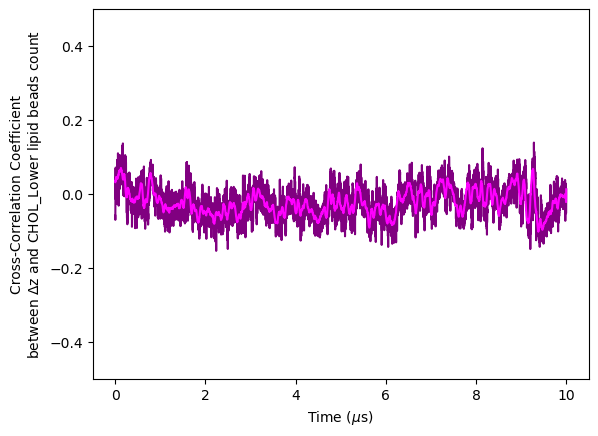

In [36]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m2/r4m2_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m2/r4m2_nosolv.xtc')
Repeat = 2
System = "r4m"

Layer_name = "Upper"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 2625:6590")
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

Layer_name = "Lower"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 6591:10618")
for i in range(6,14): 
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

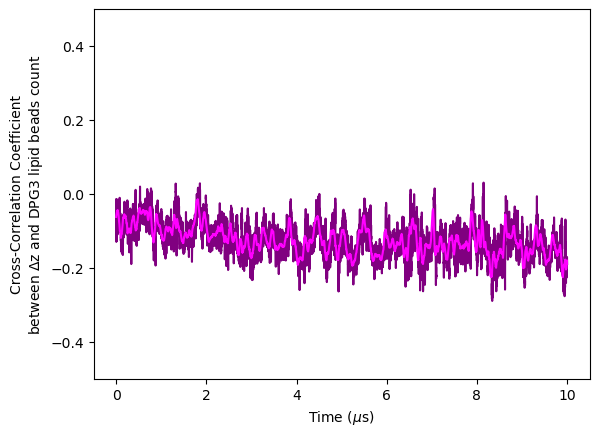

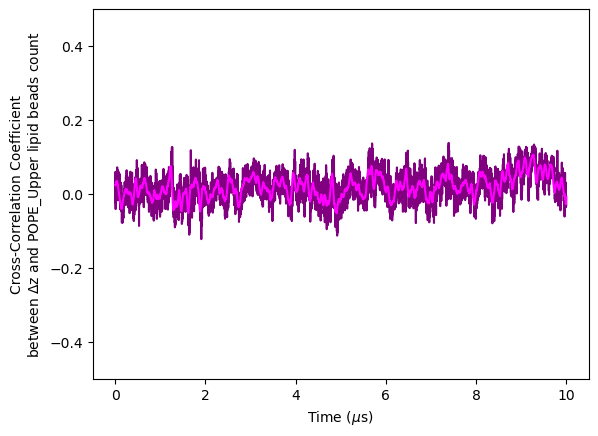

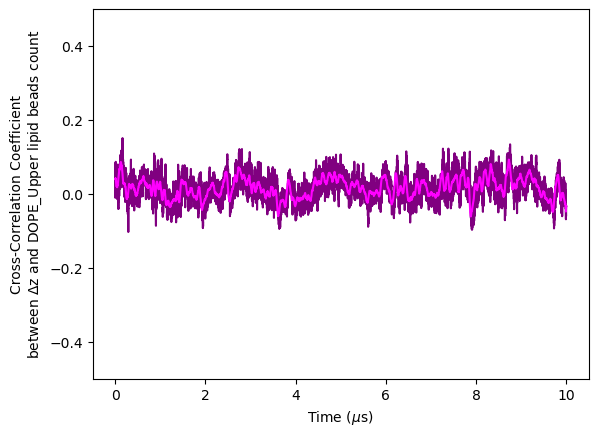

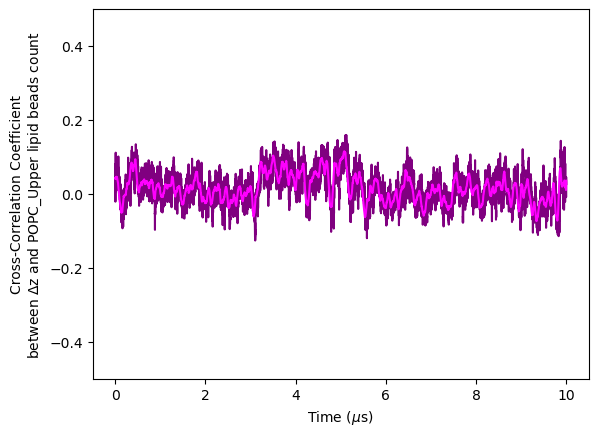

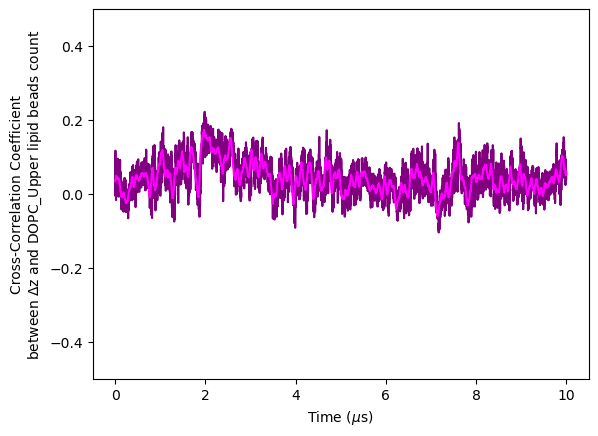

...

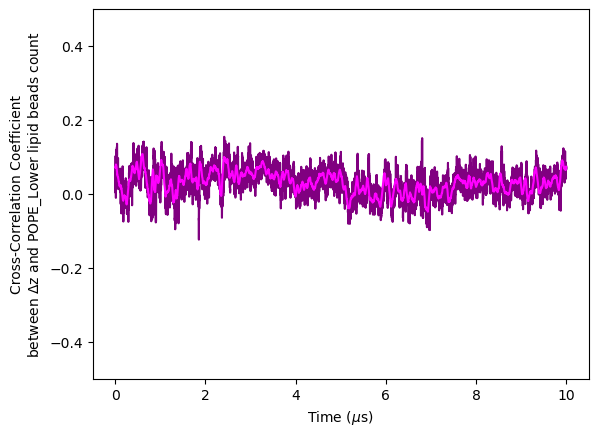

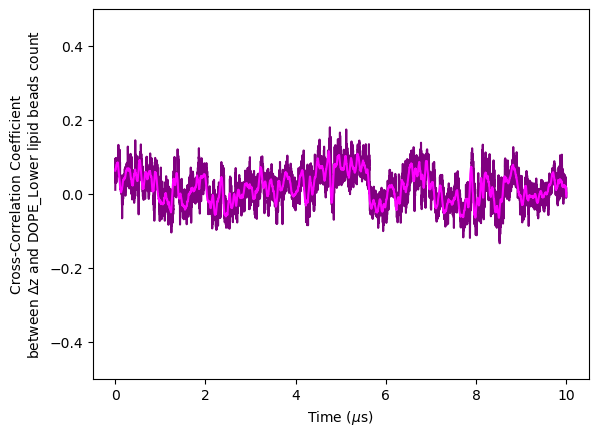

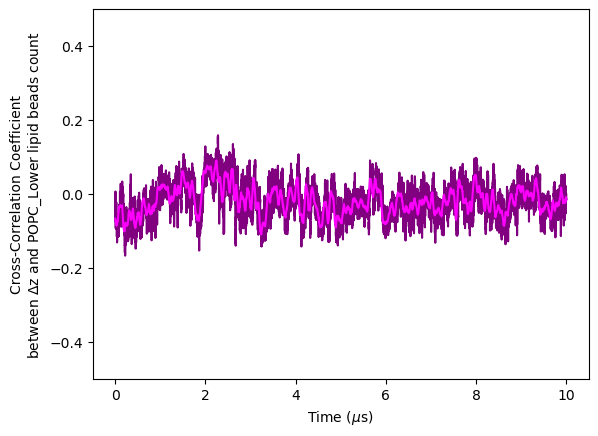

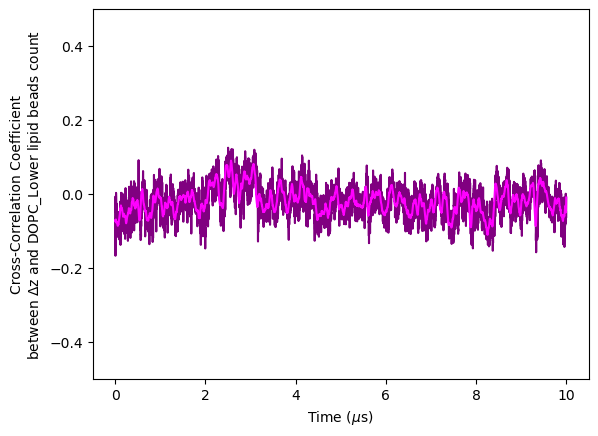

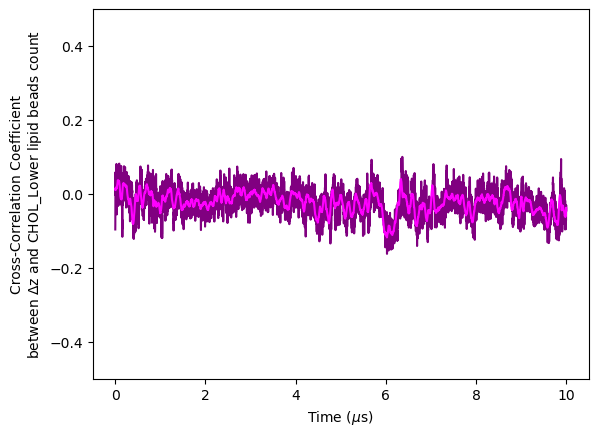

In [37]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m3/r4m3_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m3/r4m3_nosolv.xtc')
Repeat = 3
System = "r4m"

Layer_name = "Upper"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 2625:6590")
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

Layer_name = "Lower"
Layer = assemble_timeseries_array(u=u, selection="name PO4 and resid 6591:10618")
for i in range(6,14): 
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    lipids_count_matrix, zdev_list_matrix, xcorr_matrix = xcorr(Layer,Lipids_of_Interest)
    np.save(f"xcorr/{System}_repeat{Repeat}_{Layer_name}_{name}", xcorr_matrix)
    CCF_plot2(xcorr_matrix, name)

In [38]:
v2r_repeat1_Lower_CHOL_Lower = np.load("xcorr/v2r_repeat1_Lower_CHOL_Lower.npy") 
v2r_repeat1_Lower_POP2       = np.load("xcorr/v2r_repeat1_Lower_POP2.npy") 
v2r_repeat1_Upper_CHOL_Upper = np.load("xcorr/v2r_repeat1_Upper_CHOL_Upper.npy")
v2r_repeat1_Upper_POPC_Upper = np.load("xcorr/v2r_repeat1_Upper_POPC_Upper.npy")
v2r_repeat1_Lower_DOPC_Lower = np.load("xcorr/v2r_repeat1_Lower_DOPC_Lower.npy")
v2r_repeat1_Lower_POPC_Lower = np.load("xcorr/v2r_repeat1_Lower_POPC_Lower.npy")
v2r_repeat1_Upper_DOPC_Upper = np.load("xcorr/v2r_repeat1_Upper_DOPC_Upper.npy")
v2r_repeat1_Upper_POPE_Upper = np.load("xcorr/v2r_repeat1_Upper_POPE_Upper.npy")
v2r_repeat1_Lower_DOPE_Lower = np.load("xcorr/v2r_repeat1_Lower_DOPE_Lower.npy")
v2r_repeat1_Lower_POPE_Lower = np.load("xcorr/v2r_repeat1_Lower_POPE_Lower.npy")
v2r_repeat1_Upper_DOPE_Upper = np.load("xcorr/v2r_repeat1_Upper_DOPE_Upper.npy")
v2r_repeat1_Lower_DOPS       = np.load("xcorr/v2r_repeat1_Lower_DOPS.npy") 
v2r_repeat1_Lower_POPS       = np.load("xcorr/v2r_repeat1_Lower_POPS.npy") 
v2r_repeat1_Upper_DPG3       = np.load("xcorr/v2r_repeat1_Upper_DPG3.npy")

v2r_repeat2_Lower_CHOL_Lower = np.load("xcorr/v2r_repeat2_Lower_CHOL_Lower.npy") 
v2r_repeat2_Lower_POP2       = np.load("xcorr/v2r_repeat2_Lower_POP2.npy") 
v2r_repeat2_Upper_CHOL_Upper = np.load("xcorr/v2r_repeat2_Upper_CHOL_Upper.npy")
v2r_repeat2_Upper_POPC_Upper = np.load("xcorr/v2r_repeat2_Upper_POPC_Upper.npy")
v2r_repeat2_Lower_DOPC_Lower = np.load("xcorr/v2r_repeat2_Lower_DOPC_Lower.npy")
v2r_repeat2_Lower_POPC_Lower = np.load("xcorr/v2r_repeat2_Lower_POPC_Lower.npy")
v2r_repeat2_Upper_DOPC_Upper = np.load("xcorr/v2r_repeat2_Upper_DOPC_Upper.npy")
v2r_repeat2_Upper_POPE_Upper = np.load("xcorr/v2r_repeat2_Upper_POPE_Upper.npy")
v2r_repeat2_Lower_DOPE_Lower = np.load("xcorr/v2r_repeat2_Lower_DOPE_Lower.npy")
v2r_repeat2_Lower_POPE_Lower = np.load("xcorr/v2r_repeat2_Lower_POPE_Lower.npy")
v2r_repeat2_Upper_DOPE_Upper = np.load("xcorr/v2r_repeat2_Upper_DOPE_Upper.npy")
v2r_repeat2_Lower_DOPS       = np.load("xcorr/v2r_repeat2_Lower_DOPS.npy") 
v2r_repeat2_Lower_POPS       = np.load("xcorr/v2r_repeat2_Lower_POPS.npy") 
v2r_repeat2_Upper_DPG3       = np.load("xcorr/v2r_repeat2_Upper_DPG3.npy")

v2r_repeat3_Lower_CHOL_Lower = np.load("xcorr/v2r_repeat3_Lower_CHOL_Lower.npy") 
v2r_repeat3_Lower_POP2       = np.load("xcorr/v2r_repeat3_Lower_POP2.npy") 
v2r_repeat3_Upper_CHOL_Upper = np.load("xcorr/v2r_repeat3_Upper_CHOL_Upper.npy")
v2r_repeat3_Upper_POPC_Upper = np.load("xcorr/v2r_repeat3_Upper_POPC_Upper.npy")
v2r_repeat3_Lower_DOPC_Lower = np.load("xcorr/v2r_repeat3_Lower_DOPC_Lower.npy")
v2r_repeat3_Lower_POPC_Lower = np.load("xcorr/v2r_repeat3_Lower_POPC_Lower.npy")
v2r_repeat3_Upper_DOPC_Upper = np.load("xcorr/v2r_repeat3_Upper_DOPC_Upper.npy")
v2r_repeat3_Upper_POPE_Upper = np.load("xcorr/v2r_repeat3_Upper_POPE_Upper.npy")
v2r_repeat3_Lower_DOPE_Lower = np.load("xcorr/v2r_repeat3_Lower_DOPE_Lower.npy")
v2r_repeat3_Lower_POPE_Lower = np.load("xcorr/v2r_repeat3_Lower_POPE_Lower.npy")
v2r_repeat3_Upper_DOPE_Upper = np.load("xcorr/v2r_repeat3_Upper_DOPE_Upper.npy")
v2r_repeat3_Lower_DOPS       = np.load("xcorr/v2r_repeat3_Lower_DOPS.npy") 
v2r_repeat3_Lower_POPS       = np.load("xcorr/v2r_repeat3_Lower_POPS.npy") 
v2r_repeat3_Upper_DPG3       = np.load("xcorr/v2r_repeat3_Upper_DPG3.npy")

v2m_repeat1_Lower_CHOL_Lower = np.load("xcorr/v2m_repeat1_Lower_CHOL_Lower.npy") 
v2m_repeat1_Lower_POP2       = np.load("xcorr/v2m_repeat1_Lower_POP2.npy") 
v2m_repeat1_Upper_CHOL_Upper = np.load("xcorr/v2m_repeat1_Upper_CHOL_Upper.npy")
v2m_repeat1_Upper_POPC_Upper = np.load("xcorr/v2m_repeat1_Upper_POPC_Upper.npy")
v2m_repeat1_Lower_DOPC_Lower = np.load("xcorr/v2m_repeat1_Lower_DOPC_Lower.npy")
v2m_repeat1_Lower_POPC_Lower = np.load("xcorr/v2m_repeat1_Lower_POPC_Lower.npy")
v2m_repeat1_Upper_DOPC_Upper = np.load("xcorr/v2m_repeat1_Upper_DOPC_Upper.npy")
v2m_repeat1_Upper_POPE_Upper = np.load("xcorr/v2m_repeat1_Upper_POPE_Upper.npy")
v2m_repeat1_Lower_DOPE_Lower = np.load("xcorr/v2m_repeat1_Lower_DOPE_Lower.npy")
v2m_repeat1_Lower_POPE_Lower = np.load("xcorr/v2m_repeat1_Lower_POPE_Lower.npy")
v2m_repeat1_Upper_DOPE_Upper = np.load("xcorr/v2m_repeat1_Upper_DOPE_Upper.npy")
v2m_repeat1_Lower_DOPS       = np.load("xcorr/v2m_repeat1_Lower_DOPS.npy") 
v2m_repeat1_Lower_POPS       = np.load("xcorr/v2m_repeat1_Lower_POPS.npy") 
v2m_repeat1_Upper_DPG3       = np.load("xcorr/v2m_repeat1_Upper_DPG3.npy")

v2m_repeat2_Lower_CHOL_Lower = np.load("xcorr/v2m_repeat2_Lower_CHOL_Lower.npy") 
v2m_repeat2_Lower_POP2       = np.load("xcorr/v2m_repeat2_Lower_POP2.npy") 
v2m_repeat2_Upper_CHOL_Upper = np.load("xcorr/v2m_repeat2_Upper_CHOL_Upper.npy")
v2m_repeat2_Upper_POPC_Upper = np.load("xcorr/v2m_repeat2_Upper_POPC_Upper.npy")
v2m_repeat2_Lower_DOPC_Lower = np.load("xcorr/v2m_repeat2_Lower_DOPC_Lower.npy")
v2m_repeat2_Lower_POPC_Lower = np.load("xcorr/v2m_repeat2_Lower_POPC_Lower.npy")
v2m_repeat2_Upper_DOPC_Upper = np.load("xcorr/v2m_repeat2_Upper_DOPC_Upper.npy")
v2m_repeat2_Upper_POPE_Upper = np.load("xcorr/v2m_repeat2_Upper_POPE_Upper.npy")
v2m_repeat2_Lower_DOPE_Lower = np.load("xcorr/v2m_repeat2_Lower_DOPE_Lower.npy")
v2m_repeat2_Lower_POPE_Lower = np.load("xcorr/v2m_repeat2_Lower_POPE_Lower.npy")
v2m_repeat2_Upper_DOPE_Upper = np.load("xcorr/v2m_repeat2_Upper_DOPE_Upper.npy")
v2m_repeat2_Lower_DOPS       = np.load("xcorr/v2m_repeat2_Lower_DOPS.npy") 
v2m_repeat2_Lower_POPS       = np.load("xcorr/v2m_repeat2_Lower_POPS.npy") 
v2m_repeat2_Upper_DPG3       = np.load("xcorr/v2m_repeat2_Upper_DPG3.npy")

v2m_repeat3_Lower_CHOL_Lower = np.load("xcorr/v2m_repeat3_Lower_CHOL_Lower.npy") 
v2m_repeat3_Lower_POP2       = np.load("xcorr/v2m_repeat3_Lower_POP2.npy") 
v2m_repeat3_Upper_CHOL_Upper = np.load("xcorr/v2m_repeat3_Upper_CHOL_Upper.npy")
v2m_repeat3_Upper_POPC_Upper = np.load("xcorr/v2m_repeat3_Upper_POPC_Upper.npy")
v2m_repeat3_Lower_DOPC_Lower = np.load("xcorr/v2m_repeat3_Lower_DOPC_Lower.npy")
v2m_repeat3_Lower_POPC_Lower = np.load("xcorr/v2m_repeat3_Lower_POPC_Lower.npy")
v2m_repeat3_Upper_DOPC_Upper = np.load("xcorr/v2m_repeat3_Upper_DOPC_Upper.npy")
v2m_repeat3_Upper_POPE_Upper = np.load("xcorr/v2m_repeat3_Upper_POPE_Upper.npy")
v2m_repeat3_Lower_DOPE_Lower = np.load("xcorr/v2m_repeat3_Lower_DOPE_Lower.npy")
v2m_repeat3_Lower_POPE_Lower = np.load("xcorr/v2m_repeat3_Lower_POPE_Lower.npy")
v2m_repeat3_Upper_DOPE_Upper = np.load("xcorr/v2m_repeat3_Upper_DOPE_Upper.npy")
v2m_repeat3_Lower_DOPS       = np.load("xcorr/v2m_repeat3_Lower_DOPS.npy") 
v2m_repeat3_Lower_POPS       = np.load("xcorr/v2m_repeat3_Lower_POPS.npy") 
v2m_repeat3_Upper_DPG3       = np.load("xcorr/v2m_repeat3_Upper_DPG3.npy")

r4m_repeat1_Lower_CHOL_Lower = np.load("xcorr/r4m_repeat1_Lower_CHOL_Lower.npy") 
r4m_repeat1_Lower_POP2       = np.load("xcorr/r4m_repeat1_Lower_POP2.npy") 
r4m_repeat1_Upper_CHOL_Upper = np.load("xcorr/r4m_repeat1_Upper_CHOL_Upper.npy")
r4m_repeat1_Upper_POPC_Upper = np.load("xcorr/r4m_repeat1_Upper_POPC_Upper.npy")
r4m_repeat1_Lower_DOPC_Lower = np.load("xcorr/r4m_repeat1_Lower_DOPC_Lower.npy")
r4m_repeat1_Lower_POPC_Lower = np.load("xcorr/r4m_repeat1_Lower_POPC_Lower.npy")
r4m_repeat1_Upper_DOPC_Upper = np.load("xcorr/r4m_repeat1_Upper_DOPC_Upper.npy")
r4m_repeat1_Upper_POPE_Upper = np.load("xcorr/r4m_repeat1_Upper_POPE_Upper.npy")
r4m_repeat1_Lower_DOPE_Lower = np.load("xcorr/r4m_repeat1_Lower_DOPE_Lower.npy")
r4m_repeat1_Lower_POPE_Lower = np.load("xcorr/r4m_repeat1_Lower_POPE_Lower.npy")
r4m_repeat1_Upper_DOPE_Upper = np.load("xcorr/r4m_repeat1_Upper_DOPE_Upper.npy")
r4m_repeat1_Lower_DOPS       = np.load("xcorr/r4m_repeat1_Lower_DOPS.npy") 
r4m_repeat1_Lower_POPS       = np.load("xcorr/r4m_repeat1_Lower_POPS.npy") 
r4m_repeat1_Upper_DPG3       = np.load("xcorr/r4m_repeat1_Upper_DPG3.npy")

r4m_repeat2_Lower_CHOL_Lower = np.load("xcorr/r4m_repeat2_Lower_CHOL_Lower.npy") 
r4m_repeat2_Lower_POP2       = np.load("xcorr/r4m_repeat2_Lower_POP2.npy") 
r4m_repeat2_Upper_CHOL_Upper = np.load("xcorr/r4m_repeat2_Upper_CHOL_Upper.npy")
r4m_repeat2_Upper_POPC_Upper = np.load("xcorr/r4m_repeat2_Upper_POPC_Upper.npy")
r4m_repeat2_Lower_DOPC_Lower = np.load("xcorr/r4m_repeat2_Lower_DOPC_Lower.npy")
r4m_repeat2_Lower_POPC_Lower = np.load("xcorr/r4m_repeat2_Lower_POPC_Lower.npy")
r4m_repeat2_Upper_DOPC_Upper = np.load("xcorr/r4m_repeat2_Upper_DOPC_Upper.npy")
r4m_repeat2_Upper_POPE_Upper = np.load("xcorr/r4m_repeat2_Upper_POPE_Upper.npy")
r4m_repeat2_Lower_DOPE_Lower = np.load("xcorr/r4m_repeat2_Lower_DOPE_Lower.npy")
r4m_repeat2_Lower_POPE_Lower = np.load("xcorr/r4m_repeat2_Lower_POPE_Lower.npy")
r4m_repeat2_Upper_DOPE_Upper = np.load("xcorr/r4m_repeat2_Upper_DOPE_Upper.npy")
r4m_repeat2_Lower_DOPS       = np.load("xcorr/r4m_repeat2_Lower_DOPS.npy") 
r4m_repeat2_Lower_POPS       = np.load("xcorr/r4m_repeat2_Lower_POPS.npy") 
r4m_repeat2_Upper_DPG3       = np.load("xcorr/r4m_repeat2_Upper_DPG3.npy")

r4m_repeat3_Lower_CHOL_Lower = np.load("xcorr/r4m_repeat3_Lower_CHOL_Lower.npy") 
r4m_repeat3_Lower_POP2       = np.load("xcorr/r4m_repeat3_Lower_POP2.npy") 
r4m_repeat3_Upper_CHOL_Upper = np.load("xcorr/r4m_repeat3_Upper_CHOL_Upper.npy")
r4m_repeat3_Upper_POPC_Upper = np.load("xcorr/r4m_repeat3_Upper_POPC_Upper.npy")
r4m_repeat3_Lower_DOPC_Lower = np.load("xcorr/r4m_repeat3_Lower_DOPC_Lower.npy")
r4m_repeat3_Lower_POPC_Lower = np.load("xcorr/r4m_repeat3_Lower_POPC_Lower.npy")
r4m_repeat3_Upper_DOPC_Upper = np.load("xcorr/r4m_repeat3_Upper_DOPC_Upper.npy")
r4m_repeat3_Upper_POPE_Upper = np.load("xcorr/r4m_repeat3_Upper_POPE_Upper.npy")
r4m_repeat3_Lower_DOPE_Lower = np.load("xcorr/r4m_repeat3_Lower_DOPE_Lower.npy")
r4m_repeat3_Lower_POPE_Lower = np.load("xcorr/r4m_repeat3_Lower_POPE_Lower.npy")
r4m_repeat3_Upper_DOPE_Upper = np.load("xcorr/r4m_repeat3_Upper_DOPE_Upper.npy")
r4m_repeat3_Lower_DOPS       = np.load("xcorr/r4m_repeat3_Lower_DOPS.npy") 
r4m_repeat3_Lower_POPS       = np.load("xcorr/r4m_repeat3_Lower_POPS.npy") 
r4m_repeat3_Upper_DPG3       = np.load("xcorr/r4m_repeat3_Upper_DPG3.npy")

In [43]:
xcorr_matrices = [
v2r_repeat1_Lower_CHOL_Lower,
v2r_repeat1_Lower_POP2      ,
v2r_repeat1_Upper_CHOL_Upper,
v2r_repeat1_Upper_POPC_Upper,
v2r_repeat1_Lower_DOPC_Lower,
v2r_repeat1_Lower_POPC_Lower,
v2r_repeat1_Upper_DOPC_Upper,
v2r_repeat1_Upper_POPE_Upper,
v2r_repeat1_Lower_DOPE_Lower,
v2r_repeat1_Lower_POPE_Lower,
v2r_repeat1_Upper_DOPE_Upper,
v2r_repeat1_Lower_DOPS      ,
v2r_repeat1_Lower_POPS      ,
v2r_repeat1_Upper_DPG3      ,

v2r_repeat2_Lower_CHOL_Lower,
v2r_repeat2_Lower_POP2      ,
v2r_repeat2_Upper_CHOL_Upper,
v2r_repeat2_Upper_POPC_Upper,
v2r_repeat2_Lower_DOPC_Lower,
v2r_repeat2_Lower_POPC_Lower,
v2r_repeat2_Upper_DOPC_Upper,
v2r_repeat2_Upper_POPE_Upper,
v2r_repeat2_Lower_DOPE_Lower,
v2r_repeat2_Lower_POPE_Lower,
v2r_repeat2_Upper_DOPE_Upper,
v2r_repeat2_Lower_DOPS      ,
v2r_repeat2_Lower_POPS      ,
v2r_repeat2_Upper_DPG3      ,

v2r_repeat3_Lower_CHOL_Lower,
v2r_repeat3_Lower_POP2      ,
v2r_repeat3_Upper_CHOL_Upper,
v2r_repeat3_Upper_POPC_Upper,
v2r_repeat3_Lower_DOPC_Lower,
v2r_repeat3_Lower_POPC_Lower,
v2r_repeat3_Upper_DOPC_Upper,
v2r_repeat3_Upper_POPE_Upper,
v2r_repeat3_Lower_DOPE_Lower,
v2r_repeat3_Lower_POPE_Lower,
v2r_repeat3_Upper_DOPE_Upper,
v2r_repeat3_Lower_DOPS      ,
v2r_repeat3_Lower_POPS      ,
v2r_repeat3_Upper_DPG3      ,

v2m_repeat1_Lower_CHOL_Lower,
v2m_repeat1_Lower_POP2      ,
v2m_repeat1_Upper_CHOL_Upper,
v2m_repeat1_Upper_POPC_Upper,
v2m_repeat1_Lower_DOPC_Lower,
v2m_repeat1_Lower_POPC_Lower,
v2m_repeat1_Upper_DOPC_Upper,
v2m_repeat1_Upper_POPE_Upper,
v2m_repeat1_Lower_DOPE_Lower,
v2m_repeat1_Lower_POPE_Lower,
v2m_repeat1_Upper_DOPE_Upper,
v2m_repeat1_Lower_DOPS      ,
v2m_repeat1_Lower_POPS      ,
v2m_repeat1_Upper_DPG3      ,

v2m_repeat2_Lower_CHOL_Lower,
v2m_repeat2_Lower_POP2      ,
v2m_repeat2_Upper_CHOL_Upper,
v2m_repeat2_Upper_POPC_Upper,
v2m_repeat2_Lower_DOPC_Lower,
v2m_repeat2_Lower_POPC_Lower,
v2m_repeat2_Upper_DOPC_Upper,
v2m_repeat2_Upper_POPE_Upper,
v2m_repeat2_Lower_DOPE_Lower,
v2m_repeat2_Lower_POPE_Lower,
v2m_repeat2_Upper_DOPE_Upper,
v2m_repeat2_Lower_DOPS      ,
v2m_repeat2_Lower_POPS      ,
v2m_repeat2_Upper_DPG3      ,

v2m_repeat3_Lower_CHOL_Lower,
v2m_repeat3_Lower_POP2      ,
v2m_repeat3_Upper_CHOL_Upper,
v2m_repeat3_Upper_POPC_Upper,
v2m_repeat3_Lower_DOPC_Lower,
v2m_repeat3_Lower_POPC_Lower,
v2m_repeat3_Upper_DOPC_Upper,
v2m_repeat3_Upper_POPE_Upper,
v2m_repeat3_Lower_DOPE_Lower,
v2m_repeat3_Lower_POPE_Lower,
v2m_repeat3_Upper_DOPE_Upper,
v2m_repeat3_Lower_DOPS      ,
v2m_repeat3_Lower_POPS      ,
v2m_repeat3_Upper_DPG3      ,

r4m_repeat1_Lower_CHOL_Lower,
r4m_repeat1_Lower_POP2      ,
r4m_repeat1_Upper_CHOL_Upper,
r4m_repeat1_Upper_POPC_Upper,
r4m_repeat1_Lower_DOPC_Lower,
r4m_repeat1_Lower_POPC_Lower,
r4m_repeat1_Upper_DOPC_Upper,
r4m_repeat1_Upper_POPE_Upper,
r4m_repeat1_Lower_DOPE_Lower,
r4m_repeat1_Lower_POPE_Lower,
r4m_repeat1_Upper_DOPE_Upper,
r4m_repeat1_Lower_DOPS      ,
r4m_repeat1_Lower_POPS      ,
r4m_repeat1_Upper_DPG3      ,

r4m_repeat2_Lower_CHOL_Lower,
r4m_repeat2_Lower_POP2      ,
r4m_repeat2_Upper_CHOL_Upper,
r4m_repeat2_Upper_POPC_Upper,
r4m_repeat2_Lower_DOPC_Lower,
r4m_repeat2_Lower_POPC_Lower,
r4m_repeat2_Upper_DOPC_Upper,
r4m_repeat2_Upper_POPE_Upper,
r4m_repeat2_Lower_DOPE_Lower,
r4m_repeat2_Lower_POPE_Lower,
r4m_repeat2_Upper_DOPE_Upper,
r4m_repeat2_Lower_DOPS      ,
r4m_repeat2_Lower_POPS      ,
r4m_repeat2_Upper_DPG3      ,

r4m_repeat3_Lower_CHOL_Lower,
r4m_repeat3_Lower_POP2      ,
r4m_repeat3_Upper_CHOL_Upper,
r4m_repeat3_Upper_POPC_Upper,
r4m_repeat3_Lower_DOPC_Lower,
r4m_repeat3_Lower_POPC_Lower,
r4m_repeat3_Upper_DOPC_Upper,
r4m_repeat3_Upper_POPE_Upper,
r4m_repeat3_Lower_DOPE_Lower,
r4m_repeat3_Lower_POPE_Lower,
r4m_repeat3_Upper_DOPE_Upper,
r4m_repeat3_Lower_DOPS      ,
r4m_repeat3_Lower_POPS      ,
r4m_repeat3_Upper_DPG3      ]

xcorr_matrices_names = [
"v2r_repeat1_Lower_CHOL_Lower",
"v2r_repeat1_Lower_POP2      ",
"v2r_repeat1_Upper_CHOL_Upper",
"v2r_repeat1_Upper_POPC_Upper",
"v2r_repeat1_Lower_DOPC_Lower",
"v2r_repeat1_Lower_POPC_Lower",
"v2r_repeat1_Upper_DOPC_Upper",
"v2r_repeat1_Upper_POPE_Upper",
"v2r_repeat1_Lower_DOPE_Lower",
"v2r_repeat1_Lower_POPE_Lower",
"v2r_repeat1_Upper_DOPE_Upper",
"v2r_repeat1_Lower_DOPS      ",
"v2r_repeat1_Lower_POPS      ",
"v2r_repeat1_Upper_DPG3      ",

"v2r_repeat2_Lower_CHOL_Lower",
"v2r_repeat2_Lower_POP2      ",
"v2r_repeat2_Upper_CHOL_Upper",
"v2r_repeat2_Upper_POPC_Upper",
"v2r_repeat2_Lower_DOPC_Lower",
"v2r_repeat2_Lower_POPC_Lower",
"v2r_repeat2_Upper_DOPC_Upper",
"v2r_repeat2_Upper_POPE_Upper",
"v2r_repeat2_Lower_DOPE_Lower",
"v2r_repeat2_Lower_POPE_Lower",
"v2r_repeat2_Upper_DOPE_Upper",
"v2r_repeat2_Lower_DOPS      ",
"v2r_repeat2_Lower_POPS      ",
"v2r_repeat2_Upper_DPG3      ",

"v2r_repeat3_Lower_CHOL_Lower",
"v2r_repeat3_Lower_POP2      ",
"v2r_repeat3_Upper_CHOL_Upper",
"v2r_repeat3_Upper_POPC_Upper",
"v2r_repeat3_Lower_DOPC_Lower",
"v2r_repeat3_Lower_POPC_Lower",
"v2r_repeat3_Upper_DOPC_Upper",
"v2r_repeat3_Upper_POPE_Upper",
"v2r_repeat3_Lower_DOPE_Lower",
"v2r_repeat3_Lower_POPE_Lower",
"v2r_repeat3_Upper_DOPE_Upper",
"v2r_repeat3_Lower_DOPS      ",
"v2r_repeat3_Lower_POPS      ",
"v2r_repeat3_Upper_DPG3      ",

"v2m_repeat1_Lower_CHOL_Lower",
"v2m_repeat1_Lower_POP2      ",
"v2m_repeat1_Upper_CHOL_Upper",
"v2m_repeat1_Upper_POPC_Upper",
"v2m_repeat1_Lower_DOPC_Lower",
"v2m_repeat1_Lower_POPC_Lower",
"v2m_repeat1_Upper_DOPC_Upper",
"v2m_repeat1_Upper_POPE_Upper",
"v2m_repeat1_Lower_DOPE_Lower",
"v2m_repeat1_Lower_POPE_Lower",
"v2m_repeat1_Upper_DOPE_Upper",
"v2m_repeat1_Lower_DOPS      ",
"v2m_repeat1_Lower_POPS      ",
"v2m_repeat1_Upper_DPG3      ",

"v2m_repeat2_Lower_CHOL_Lower",
"v2m_repeat2_Lower_POP2      ",
"v2m_repeat2_Upper_CHOL_Upper",
"v2m_repeat2_Upper_POPC_Upper",
"v2m_repeat2_Lower_DOPC_Lower",
"v2m_repeat2_Lower_POPC_Lower",
"v2m_repeat2_Upper_DOPC_Upper",
"v2m_repeat2_Upper_POPE_Upper",
"v2m_repeat2_Lower_DOPE_Lower",
"v2m_repeat2_Lower_POPE_Lower",
"v2m_repeat2_Upper_DOPE_Upper",
"v2m_repeat2_Lower_DOPS      ",
"v2m_repeat2_Lower_POPS      ",
"v2m_repeat2_Upper_DPG3      ",

"v2m_repeat3_Lower_CHOL_Lower",
"v2m_repeat3_Lower_POP2      ",
"v2m_repeat3_Upper_CHOL_Upper",
"v2m_repeat3_Upper_POPC_Upper",
"v2m_repeat3_Lower_DOPC_Lower",
"v2m_repeat3_Lower_POPC_Lower",
"v2m_repeat3_Upper_DOPC_Upper",
"v2m_repeat3_Upper_POPE_Upper",
"v2m_repeat3_Lower_DOPE_Lower",
"v2m_repeat3_Lower_POPE_Lower",
"v2m_repeat3_Upper_DOPE_Upper",
"v2m_repeat3_Lower_DOPS      ",
"v2m_repeat3_Lower_POPS      ",
"v2m_repeat3_Upper_DPG3      ",

"r4m_repeat1_Lower_CHOL_Lower",
"r4m_repeat1_Lower_POP2      ",
"r4m_repeat1_Upper_CHOL_Upper",
"r4m_repeat1_Upper_POPC_Upper",
"r4m_repeat1_Lower_DOPC_Lower",
"r4m_repeat1_Lower_POPC_Lower",
"r4m_repeat1_Upper_DOPC_Upper",
"r4m_repeat1_Upper_POPE_Upper",
"r4m_repeat1_Lower_DOPE_Lower",
"r4m_repeat1_Lower_POPE_Lower",
"r4m_repeat1_Upper_DOPE_Upper",
"r4m_repeat1_Lower_DOPS      ",
"r4m_repeat1_Lower_POPS      ",
"r4m_repeat1_Upper_DPG3      ",

"r4m_repeat2_Lower_CHOL_Lower",
"r4m_repeat2_Lower_POP2      ",
"r4m_repeat2_Upper_CHOL_Upper",
"r4m_repeat2_Upper_POPC_Upper",
"r4m_repeat2_Lower_DOPC_Lower",
"r4m_repeat2_Lower_POPC_Lower",
"r4m_repeat2_Upper_DOPC_Upper",
"r4m_repeat2_Upper_POPE_Upper",
"r4m_repeat2_Lower_DOPE_Lower",
"r4m_repeat2_Lower_POPE_Lower",
"r4m_repeat2_Upper_DOPE_Upper",
"r4m_repeat2_Lower_DOPS      ",
"r4m_repeat2_Lower_POPS      ",
"r4m_repeat2_Upper_DPG3      ",

"r4m_repeat3_Lower_CHOL_Lower",
"r4m_repeat3_Lower_POP2      ",
"r4m_repeat3_Upper_CHOL_Upper",
"r4m_repeat3_Upper_POPC_Upper",
"r4m_repeat3_Lower_DOPC_Lower",
"r4m_repeat3_Lower_POPC_Lower",
"r4m_repeat3_Upper_DOPC_Upper",
"r4m_repeat3_Upper_POPE_Upper",
"r4m_repeat3_Lower_DOPE_Lower",
"r4m_repeat3_Lower_POPE_Lower",
"r4m_repeat3_Upper_DOPE_Upper",
"r4m_repeat3_Lower_DOPS      ",
"r4m_repeat3_Lower_POPS      ",
"r4m_repeat3_Upper_DPG3      "]

In [55]:
len(xcorr_matrices)

126

In [115]:
fig, axs = plt.subplots(9,14, figsize=(100,80))
stamps = [0,14,28,42,56,70,84,98,112]
pad = 5
for k in range(len(stamps)):
    stamp = stamps[k]
    xcorr_matrices_to_plot = xcorr_matrices[stamp:stamp+14]
    xcorr_matrices_to_plot_names = xcorr_matrices_names[stamp:stamp+14]
    for i in range(14):
        to_plot = xcorr_matrices_to_plot[i]
        CC_rollingav = []
        for j in range(len(to_plot)):
            rollingav = to_plot[j:j+50].mean()
            CC_rollingav.append(rollingav)
        CC_rollingav = np.array(CC_rollingav)
        pre_name = xcorr_matrices_to_plot_names[i].split('_')
        name = pre_name[2] + '_' + pre_name[3]

        axs[k,i].set_ylim(-0.5,0.5)
        axs[k,i].plot(np.arange(0,10.001,0.001),to_plot,color='purple')
        axs[k,i].plot(np.arange(0,10.001,0.001), CC_rollingav,color='magenta')
        axs[k,i].set_xlabel("Time ($\mu$s)")
        axs[k,i].set_ylabel(f"Cross-Correlation Coefficient\nbetween $\Delta$z and {name} lipid beads count")

## Setting Column Names

for l in range(14):

    pre_col_name = xcorr_matrices_to_plot_names[l].split('_')
    col_name = pre_col_name[2] + '_' + pre_col_name[3]
    axs[0,l].annotate(col_name, fontsize=40,
                                xy=(0.5, 1), xytext=(0, pad),
                                xycoords='axes fraction', textcoords='offset points',
                                ha='center', va='baseline')

## Setting Row names

repeat_names = [
"AAV2-AAVR\nRepeat1",
"AAV2-AAVR\nRepeat2",
"AAV2-AAVR\nRepeat3",
"AAV2-only\nRepeat1",
"AAV2-only\nRepeat2",
"AAV2-only\nRepeat3",
"AAVR-only\nRepeat1",
"AAVR-only\nRepeat2",
"AAVR-only\nRepeat3"
]

for m in range(len(repeat_names)):
    row_name = repeat_names[m]
    axs[m,0].annotate(row_name, fontsize=40,
                      xy = (-0.4,0.25), xytext=(pad,0.5),
                      xycoords='axes fraction', textcoords = 'offset points',
                      ha = 'center', va = 'baseline', rotation=90)

plt.savefig("xcorr/xcorr_fig.svg", dpi = 600)

# Clustering with DBSCAN

In [67]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r1/v2r1_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r1/v2r1_nosolv.xtc')
Repeat = 1
System = "v2r"

Layer_name = "Upper"
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

Layer_name = "Lower"
for i in range(6,14): 
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

In [68]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r2/v2r2_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r2/v2r2_nosolv.xtc')
Repeat = 2
System = "v2r"

Layer_name = "Upper"
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

Layer_name = "Lower"
for i in range(6,14): 
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

In [69]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r3/v2r3_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_aavr_scaled_3/dir_v2r3/v2r3_nosolv.xtc')
Repeat = 3
System = "v2r"

Layer_name = "Upper"
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

Layer_name = "Lower"
for i in range(6,14): 
    lipid_selection = lipid_set_v2r[i]
    name = lipid_names_v2r[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

In [70]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m1/v2m1_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m1/v2m1_nosolv.xtc')
Repeat = 1
System = "v2m"

Layer_name = "Upper"
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

Layer_name = "Lower"
for i in range(6,14): 
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

In [71]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m2/v2m2_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m2/v2m2_nosolv.xtc')
Repeat = 2
System = "v2m"

Layer_name = "Upper"
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

Layer_name = "Lower"
for i in range(6,14): 
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

In [72]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m3/v2m3_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aav2_mem_scaled_3/dir_v2m3/v2m3_nosolv.xtc')
Repeat = 3
System = "v2m"

Layer_name = "Upper"
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

Layer_name = "Lower"
for i in range(6,14): 
    lipid_selection = lipid_set_v2m[i]
    name = lipid_names_v2m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

In [74]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m1/r4m1_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m1/r4m1_nosolv.xtc')
Repeat = 1
System = "r4m"

Layer_name = "Upper"
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

Layer_name = "Lower"
for i in range(6,14): 
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

In [75]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m2/r4m2_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m2/r4m2_nosolv.xtc')
Repeat = 2
System = "r4m"

Layer_name = "Upper"
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

Layer_name = "Lower"
for i in range(6,14): 
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

In [76]:
u = mda.Universe('/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m3/r4m3_nosolv.gro', 
                 '/Users/pp420/mres_aav_aavr_project/aavrx4_mem_scaled_2/dir_r4m3/r4m3_nosolv.xtc')
Repeat = 3
System = "r4m"

Layer_name = "Upper"
for i in range(6): ## Upper Layer first
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

Layer_name = "Lower"
for i in range(6,14): 
    lipid_selection = lipid_set_r4m[i]
    name = lipid_names_r4m[i]
    Lipids_of_Interest = assemble_timeseries_array(u=u, selection=lipid_selection)
    Lipids_of_Interest_nclust, Lipids_of_Interest_clustsize = clust_ts(Lipids_of_Interest,eps_b=28,ms_b=5)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_nclust", Lipids_of_Interest_nclust)
    np.save(f"dbscan/{System}_repeat{Repeat}_{Layer_name}_{name}_clustsize", Lipids_of_Interest_clustsize)

/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: A
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: E
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/pp420/miniconda3/envs/mdanalysis/lib/python3.11/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.

# Plotting

## Loading Data

In [120]:
v2r_repeat1_Lower_CHOL_Lower = np.load("xcorr/v2r_repeat1_Lower_CHOL_Lower.npy") 
v2r_repeat1_Lower_POP2       = np.load("xcorr/v2r_repeat1_Lower_POP2.npy") 
v2r_repeat1_Upper_CHOL_Upper = np.load("xcorr/v2r_repeat1_Upper_CHOL_Upper.npy")
v2r_repeat1_Upper_POPC_Upper = np.load("xcorr/v2r_repeat1_Upper_POPC_Upper.npy")
v2r_repeat1_Lower_DOPC_Lower = np.load("xcorr/v2r_repeat1_Lower_DOPC_Lower.npy")
v2r_repeat1_Lower_POPC_Lower = np.load("xcorr/v2r_repeat1_Lower_POPC_Lower.npy")
v2r_repeat1_Upper_DOPC_Upper = np.load("xcorr/v2r_repeat1_Upper_DOPC_Upper.npy")
v2r_repeat1_Upper_POPE_Upper = np.load("xcorr/v2r_repeat1_Upper_POPE_Upper.npy")
v2r_repeat1_Lower_DOPE_Lower = np.load("xcorr/v2r_repeat1_Lower_DOPE_Lower.npy")
v2r_repeat1_Lower_POPE_Lower = np.load("xcorr/v2r_repeat1_Lower_POPE_Lower.npy")
v2r_repeat1_Upper_DOPE_Upper = np.load("xcorr/v2r_repeat1_Upper_DOPE_Upper.npy")
v2r_repeat1_Lower_DOPS       = np.load("xcorr/v2r_repeat1_Lower_DOPS.npy") 
v2r_repeat1_Lower_POPS       = np.load("xcorr/v2r_repeat1_Lower_POPS.npy") 
v2r_repeat1_Upper_DPG3       = np.load("xcorr/v2r_repeat1_Upper_DPG3.npy")

v2r_repeat2_Lower_CHOL_Lower = np.load("xcorr/v2r_repeat2_Lower_CHOL_Lower.npy") 
v2r_repeat2_Lower_POP2       = np.load("xcorr/v2r_repeat2_Lower_POP2.npy") 
v2r_repeat2_Upper_CHOL_Upper = np.load("xcorr/v2r_repeat2_Upper_CHOL_Upper.npy")
v2r_repeat2_Upper_POPC_Upper = np.load("xcorr/v2r_repeat2_Upper_POPC_Upper.npy")
v2r_repeat2_Lower_DOPC_Lower = np.load("xcorr/v2r_repeat2_Lower_DOPC_Lower.npy")
v2r_repeat2_Lower_POPC_Lower = np.load("xcorr/v2r_repeat2_Lower_POPC_Lower.npy")
v2r_repeat2_Upper_DOPC_Upper = np.load("xcorr/v2r_repeat2_Upper_DOPC_Upper.npy")
v2r_repeat2_Upper_POPE_Upper = np.load("xcorr/v2r_repeat2_Upper_POPE_Upper.npy")
v2r_repeat2_Lower_DOPE_Lower = np.load("xcorr/v2r_repeat2_Lower_DOPE_Lower.npy")
v2r_repeat2_Lower_POPE_Lower = np.load("xcorr/v2r_repeat2_Lower_POPE_Lower.npy")
v2r_repeat2_Upper_DOPE_Upper = np.load("xcorr/v2r_repeat2_Upper_DOPE_Upper.npy")
v2r_repeat2_Lower_DOPS       = np.load("xcorr/v2r_repeat2_Lower_DOPS.npy") 
v2r_repeat2_Lower_POPS       = np.load("xcorr/v2r_repeat2_Lower_POPS.npy") 
v2r_repeat2_Upper_DPG3       = np.load("xcorr/v2r_repeat2_Upper_DPG3.npy")

v2r_repeat3_Lower_CHOL_Lower = np.load("xcorr/v2r_repeat3_Lower_CHOL_Lower.npy") 
v2r_repeat3_Lower_POP2       = np.load("xcorr/v2r_repeat3_Lower_POP2.npy") 
v2r_repeat3_Upper_CHOL_Upper = np.load("xcorr/v2r_repeat3_Upper_CHOL_Upper.npy")
v2r_repeat3_Upper_POPC_Upper = np.load("xcorr/v2r_repeat3_Upper_POPC_Upper.npy")
v2r_repeat3_Lower_DOPC_Lower = np.load("xcorr/v2r_repeat3_Lower_DOPC_Lower.npy")
v2r_repeat3_Lower_POPC_Lower = np.load("xcorr/v2r_repeat3_Lower_POPC_Lower.npy")
v2r_repeat3_Upper_DOPC_Upper = np.load("xcorr/v2r_repeat3_Upper_DOPC_Upper.npy")
v2r_repeat3_Upper_POPE_Upper = np.load("xcorr/v2r_repeat3_Upper_POPE_Upper.npy")
v2r_repeat3_Lower_DOPE_Lower = np.load("xcorr/v2r_repeat3_Lower_DOPE_Lower.npy")
v2r_repeat3_Lower_POPE_Lower = np.load("xcorr/v2r_repeat3_Lower_POPE_Lower.npy")
v2r_repeat3_Upper_DOPE_Upper = np.load("xcorr/v2r_repeat3_Upper_DOPE_Upper.npy")
v2r_repeat3_Lower_DOPS       = np.load("xcorr/v2r_repeat3_Lower_DOPS.npy") 
v2r_repeat3_Lower_POPS       = np.load("xcorr/v2r_repeat3_Lower_POPS.npy") 
v2r_repeat3_Upper_DPG3       = np.load("xcorr/v2r_repeat3_Upper_DPG3.npy")

v2m_repeat1_Lower_CHOL_Lower = np.load("xcorr/v2m_repeat1_Lower_CHOL_Lower.npy") 
v2m_repeat1_Lower_POP2       = np.load("xcorr/v2m_repeat1_Lower_POP2.npy") 
v2m_repeat1_Upper_CHOL_Upper = np.load("xcorr/v2m_repeat1_Upper_CHOL_Upper.npy")
v2m_repeat1_Upper_POPC_Upper = np.load("xcorr/v2m_repeat1_Upper_POPC_Upper.npy")
v2m_repeat1_Lower_DOPC_Lower = np.load("xcorr/v2m_repeat1_Lower_DOPC_Lower.npy")
v2m_repeat1_Lower_POPC_Lower = np.load("xcorr/v2m_repeat1_Lower_POPC_Lower.npy")
v2m_repeat1_Upper_DOPC_Upper = np.load("xcorr/v2m_repeat1_Upper_DOPC_Upper.npy")
v2m_repeat1_Upper_POPE_Upper = np.load("xcorr/v2m_repeat1_Upper_POPE_Upper.npy")
v2m_repeat1_Lower_DOPE_Lower = np.load("xcorr/v2m_repeat1_Lower_DOPE_Lower.npy")
v2m_repeat1_Lower_POPE_Lower = np.load("xcorr/v2m_repeat1_Lower_POPE_Lower.npy")
v2m_repeat1_Upper_DOPE_Upper = np.load("xcorr/v2m_repeat1_Upper_DOPE_Upper.npy")
v2m_repeat1_Lower_DOPS       = np.load("xcorr/v2m_repeat1_Lower_DOPS.npy") 
v2m_repeat1_Lower_POPS       = np.load("xcorr/v2m_repeat1_Lower_POPS.npy") 
v2m_repeat1_Upper_DPG3       = np.load("xcorr/v2m_repeat1_Upper_DPG3.npy")

v2m_repeat2_Lower_CHOL_Lower = np.load("xcorr/v2m_repeat2_Lower_CHOL_Lower.npy") 
v2m_repeat2_Lower_POP2       = np.load("xcorr/v2m_repeat2_Lower_POP2.npy") 
v2m_repeat2_Upper_CHOL_Upper = np.load("xcorr/v2m_repeat2_Upper_CHOL_Upper.npy")
v2m_repeat2_Upper_POPC_Upper = np.load("xcorr/v2m_repeat2_Upper_POPC_Upper.npy")
v2m_repeat2_Lower_DOPC_Lower = np.load("xcorr/v2m_repeat2_Lower_DOPC_Lower.npy")
v2m_repeat2_Lower_POPC_Lower = np.load("xcorr/v2m_repeat2_Lower_POPC_Lower.npy")
v2m_repeat2_Upper_DOPC_Upper = np.load("xcorr/v2m_repeat2_Upper_DOPC_Upper.npy")
v2m_repeat2_Upper_POPE_Upper = np.load("xcorr/v2m_repeat2_Upper_POPE_Upper.npy")
v2m_repeat2_Lower_DOPE_Lower = np.load("xcorr/v2m_repeat2_Lower_DOPE_Lower.npy")
v2m_repeat2_Lower_POPE_Lower = np.load("xcorr/v2m_repeat2_Lower_POPE_Lower.npy")
v2m_repeat2_Upper_DOPE_Upper = np.load("xcorr/v2m_repeat2_Upper_DOPE_Upper.npy")
v2m_repeat2_Lower_DOPS       = np.load("xcorr/v2m_repeat2_Lower_DOPS.npy") 
v2m_repeat2_Lower_POPS       = np.load("xcorr/v2m_repeat2_Lower_POPS.npy") 
v2m_repeat2_Upper_DPG3       = np.load("xcorr/v2m_repeat2_Upper_DPG3.npy")

v2m_repeat3_Lower_CHOL_Lower = np.load("xcorr/v2m_repeat3_Lower_CHOL_Lower.npy") 
v2m_repeat3_Lower_POP2       = np.load("xcorr/v2m_repeat3_Lower_POP2.npy") 
v2m_repeat3_Upper_CHOL_Upper = np.load("xcorr/v2m_repeat3_Upper_CHOL_Upper.npy")
v2m_repeat3_Upper_POPC_Upper = np.load("xcorr/v2m_repeat3_Upper_POPC_Upper.npy")
v2m_repeat3_Lower_DOPC_Lower = np.load("xcorr/v2m_repeat3_Lower_DOPC_Lower.npy")
v2m_repeat3_Lower_POPC_Lower = np.load("xcorr/v2m_repeat3_Lower_POPC_Lower.npy")
v2m_repeat3_Upper_DOPC_Upper = np.load("xcorr/v2m_repeat3_Upper_DOPC_Upper.npy")
v2m_repeat3_Upper_POPE_Upper = np.load("xcorr/v2m_repeat3_Upper_POPE_Upper.npy")
v2m_repeat3_Lower_DOPE_Lower = np.load("xcorr/v2m_repeat3_Lower_DOPE_Lower.npy")
v2m_repeat3_Lower_POPE_Lower = np.load("xcorr/v2m_repeat3_Lower_POPE_Lower.npy")
v2m_repeat3_Upper_DOPE_Upper = np.load("xcorr/v2m_repeat3_Upper_DOPE_Upper.npy")
v2m_repeat3_Lower_DOPS       = np.load("xcorr/v2m_repeat3_Lower_DOPS.npy") 
v2m_repeat3_Lower_POPS       = np.load("xcorr/v2m_repeat3_Lower_POPS.npy") 
v2m_repeat3_Upper_DPG3       = np.load("xcorr/v2m_repeat3_Upper_DPG3.npy")

r4m_repeat1_Lower_CHOL_Lower = np.load("xcorr/r4m_repeat1_Lower_CHOL_Lower.npy") 
r4m_repeat1_Lower_POP2       = np.load("xcorr/r4m_repeat1_Lower_POP2.npy") 
r4m_repeat1_Upper_CHOL_Upper = np.load("xcorr/r4m_repeat1_Upper_CHOL_Upper.npy")
r4m_repeat1_Upper_POPC_Upper = np.load("xcorr/r4m_repeat1_Upper_POPC_Upper.npy")
r4m_repeat1_Lower_DOPC_Lower = np.load("xcorr/r4m_repeat1_Lower_DOPC_Lower.npy")
r4m_repeat1_Lower_POPC_Lower = np.load("xcorr/r4m_repeat1_Lower_POPC_Lower.npy")
r4m_repeat1_Upper_DOPC_Upper = np.load("xcorr/r4m_repeat1_Upper_DOPC_Upper.npy")
r4m_repeat1_Upper_POPE_Upper = np.load("xcorr/r4m_repeat1_Upper_POPE_Upper.npy")
r4m_repeat1_Lower_DOPE_Lower = np.load("xcorr/r4m_repeat1_Lower_DOPE_Lower.npy")
r4m_repeat1_Lower_POPE_Lower = np.load("xcorr/r4m_repeat1_Lower_POPE_Lower.npy")
r4m_repeat1_Upper_DOPE_Upper = np.load("xcorr/r4m_repeat1_Upper_DOPE_Upper.npy")
r4m_repeat1_Lower_DOPS       = np.load("xcorr/r4m_repeat1_Lower_DOPS.npy") 
r4m_repeat1_Lower_POPS       = np.load("xcorr/r4m_repeat1_Lower_POPS.npy") 
r4m_repeat1_Upper_DPG3       = np.load("xcorr/r4m_repeat1_Upper_DPG3.npy")

r4m_repeat2_Lower_CHOL_Lower = np.load("xcorr/r4m_repeat2_Lower_CHOL_Lower.npy") 
r4m_repeat2_Lower_POP2       = np.load("xcorr/r4m_repeat2_Lower_POP2.npy") 
r4m_repeat2_Upper_CHOL_Upper = np.load("xcorr/r4m_repeat2_Upper_CHOL_Upper.npy")
r4m_repeat2_Upper_POPC_Upper = np.load("xcorr/r4m_repeat2_Upper_POPC_Upper.npy")
r4m_repeat2_Lower_DOPC_Lower = np.load("xcorr/r4m_repeat2_Lower_DOPC_Lower.npy")
r4m_repeat2_Lower_POPC_Lower = np.load("xcorr/r4m_repeat2_Lower_POPC_Lower.npy")
r4m_repeat2_Upper_DOPC_Upper = np.load("xcorr/r4m_repeat2_Upper_DOPC_Upper.npy")
r4m_repeat2_Upper_POPE_Upper = np.load("xcorr/r4m_repeat2_Upper_POPE_Upper.npy")
r4m_repeat2_Lower_DOPE_Lower = np.load("xcorr/r4m_repeat2_Lower_DOPE_Lower.npy")
r4m_repeat2_Lower_POPE_Lower = np.load("xcorr/r4m_repeat2_Lower_POPE_Lower.npy")
r4m_repeat2_Upper_DOPE_Upper = np.load("xcorr/r4m_repeat2_Upper_DOPE_Upper.npy")
r4m_repeat2_Lower_DOPS       = np.load("xcorr/r4m_repeat2_Lower_DOPS.npy") 
r4m_repeat2_Lower_POPS       = np.load("xcorr/r4m_repeat2_Lower_POPS.npy") 
r4m_repeat2_Upper_DPG3       = np.load("xcorr/r4m_repeat2_Upper_DPG3.npy")

r4m_repeat3_Lower_CHOL_Lower = np.load("xcorr/r4m_repeat3_Lower_CHOL_Lower.npy") 
r4m_repeat3_Lower_POP2       = np.load("xcorr/r4m_repeat3_Lower_POP2.npy") 
r4m_repeat3_Upper_CHOL_Upper = np.load("xcorr/r4m_repeat3_Upper_CHOL_Upper.npy")
r4m_repeat3_Upper_POPC_Upper = np.load("xcorr/r4m_repeat3_Upper_POPC_Upper.npy")
r4m_repeat3_Lower_DOPC_Lower = np.load("xcorr/r4m_repeat3_Lower_DOPC_Lower.npy")
r4m_repeat3_Lower_POPC_Lower = np.load("xcorr/r4m_repeat3_Lower_POPC_Lower.npy")
r4m_repeat3_Upper_DOPC_Upper = np.load("xcorr/r4m_repeat3_Upper_DOPC_Upper.npy")
r4m_repeat3_Upper_POPE_Upper = np.load("xcorr/r4m_repeat3_Upper_POPE_Upper.npy")
r4m_repeat3_Lower_DOPE_Lower = np.load("xcorr/r4m_repeat3_Lower_DOPE_Lower.npy")
r4m_repeat3_Lower_POPE_Lower = np.load("xcorr/r4m_repeat3_Lower_POPE_Lower.npy")
r4m_repeat3_Upper_DOPE_Upper = np.load("xcorr/r4m_repeat3_Upper_DOPE_Upper.npy")
r4m_repeat3_Lower_DOPS       = np.load("xcorr/r4m_repeat3_Lower_DOPS.npy") 
r4m_repeat3_Lower_POPS       = np.load("xcorr/r4m_repeat3_Lower_POPS.npy") 
r4m_repeat3_Upper_DPG3       = np.load("xcorr/r4m_repeat3_Upper_DPG3.npy")
xcorr_matrices = [
v2r_repeat1_Lower_CHOL_Lower,
v2r_repeat1_Lower_POP2      ,
v2r_repeat1_Upper_CHOL_Upper,
v2r_repeat1_Upper_POPC_Upper,
v2r_repeat1_Lower_DOPC_Lower,
v2r_repeat1_Lower_POPC_Lower,
v2r_repeat1_Upper_DOPC_Upper,
v2r_repeat1_Upper_POPE_Upper,
v2r_repeat1_Lower_DOPE_Lower,
v2r_repeat1_Lower_POPE_Lower,
v2r_repeat1_Upper_DOPE_Upper,
v2r_repeat1_Lower_DOPS      ,
v2r_repeat1_Lower_POPS      ,
v2r_repeat1_Upper_DPG3      ,

v2r_repeat2_Lower_CHOL_Lower,
v2r_repeat2_Lower_POP2      ,
v2r_repeat2_Upper_CHOL_Upper,
v2r_repeat2_Upper_POPC_Upper,
v2r_repeat2_Lower_DOPC_Lower,
v2r_repeat2_Lower_POPC_Lower,
v2r_repeat2_Upper_DOPC_Upper,
v2r_repeat2_Upper_POPE_Upper,
v2r_repeat2_Lower_DOPE_Lower,
v2r_repeat2_Lower_POPE_Lower,
v2r_repeat2_Upper_DOPE_Upper,
v2r_repeat2_Lower_DOPS      ,
v2r_repeat2_Lower_POPS      ,
v2r_repeat2_Upper_DPG3      ,

v2r_repeat3_Lower_CHOL_Lower,
v2r_repeat3_Lower_POP2      ,
v2r_repeat3_Upper_CHOL_Upper,
v2r_repeat3_Upper_POPC_Upper,
v2r_repeat3_Lower_DOPC_Lower,
v2r_repeat3_Lower_POPC_Lower,
v2r_repeat3_Upper_DOPC_Upper,
v2r_repeat3_Upper_POPE_Upper,
v2r_repeat3_Lower_DOPE_Lower,
v2r_repeat3_Lower_POPE_Lower,
v2r_repeat3_Upper_DOPE_Upper,
v2r_repeat3_Lower_DOPS      ,
v2r_repeat3_Lower_POPS      ,
v2r_repeat3_Upper_DPG3      ,

v2m_repeat1_Lower_CHOL_Lower,
v2m_repeat1_Lower_POP2      ,
v2m_repeat1_Upper_CHOL_Upper,
v2m_repeat1_Upper_POPC_Upper,
v2m_repeat1_Lower_DOPC_Lower,
v2m_repeat1_Lower_POPC_Lower,
v2m_repeat1_Upper_DOPC_Upper,
v2m_repeat1_Upper_POPE_Upper,
v2m_repeat1_Lower_DOPE_Lower,
v2m_repeat1_Lower_POPE_Lower,
v2m_repeat1_Upper_DOPE_Upper,
v2m_repeat1_Lower_DOPS      ,
v2m_repeat1_Lower_POPS      ,
v2m_repeat1_Upper_DPG3      ,

v2m_repeat2_Lower_CHOL_Lower,
v2m_repeat2_Lower_POP2      ,
v2m_repeat2_Upper_CHOL_Upper,
v2m_repeat2_Upper_POPC_Upper,
v2m_repeat2_Lower_DOPC_Lower,
v2m_repeat2_Lower_POPC_Lower,
v2m_repeat2_Upper_DOPC_Upper,
v2m_repeat2_Upper_POPE_Upper,
v2m_repeat2_Lower_DOPE_Lower,
v2m_repeat2_Lower_POPE_Lower,
v2m_repeat2_Upper_DOPE_Upper,
v2m_repeat2_Lower_DOPS      ,
v2m_repeat2_Lower_POPS      ,
v2m_repeat2_Upper_DPG3      ,

v2m_repeat3_Lower_CHOL_Lower,
v2m_repeat3_Lower_POP2      ,
v2m_repeat3_Upper_CHOL_Upper,
v2m_repeat3_Upper_POPC_Upper,
v2m_repeat3_Lower_DOPC_Lower,
v2m_repeat3_Lower_POPC_Lower,
v2m_repeat3_Upper_DOPC_Upper,
v2m_repeat3_Upper_POPE_Upper,
v2m_repeat3_Lower_DOPE_Lower,
v2m_repeat3_Lower_POPE_Lower,
v2m_repeat3_Upper_DOPE_Upper,
v2m_repeat3_Lower_DOPS      ,
v2m_repeat3_Lower_POPS      ,
v2m_repeat3_Upper_DPG3      ,

r4m_repeat1_Lower_CHOL_Lower,
r4m_repeat1_Lower_POP2      ,
r4m_repeat1_Upper_CHOL_Upper,
r4m_repeat1_Upper_POPC_Upper,
r4m_repeat1_Lower_DOPC_Lower,
r4m_repeat1_Lower_POPC_Lower,
r4m_repeat1_Upper_DOPC_Upper,
r4m_repeat1_Upper_POPE_Upper,
r4m_repeat1_Lower_DOPE_Lower,
r4m_repeat1_Lower_POPE_Lower,
r4m_repeat1_Upper_DOPE_Upper,
r4m_repeat1_Lower_DOPS      ,
r4m_repeat1_Lower_POPS      ,
r4m_repeat1_Upper_DPG3      ,

r4m_repeat2_Lower_CHOL_Lower,
r4m_repeat2_Lower_POP2      ,
r4m_repeat2_Upper_CHOL_Upper,
r4m_repeat2_Upper_POPC_Upper,
r4m_repeat2_Lower_DOPC_Lower,
r4m_repeat2_Lower_POPC_Lower,
r4m_repeat2_Upper_DOPC_Upper,
r4m_repeat2_Upper_POPE_Upper,
r4m_repeat2_Lower_DOPE_Lower,
r4m_repeat2_Lower_POPE_Lower,
r4m_repeat2_Upper_DOPE_Upper,
r4m_repeat2_Lower_DOPS      ,
r4m_repeat2_Lower_POPS      ,
r4m_repeat2_Upper_DPG3      ,

r4m_repeat3_Lower_CHOL_Lower,
r4m_repeat3_Lower_POP2      ,
r4m_repeat3_Upper_CHOL_Upper,
r4m_repeat3_Upper_POPC_Upper,
r4m_repeat3_Lower_DOPC_Lower,
r4m_repeat3_Lower_POPC_Lower,
r4m_repeat3_Upper_DOPC_Upper,
r4m_repeat3_Upper_POPE_Upper,
r4m_repeat3_Lower_DOPE_Lower,
r4m_repeat3_Lower_POPE_Lower,
r4m_repeat3_Upper_DOPE_Upper,
r4m_repeat3_Lower_DOPS      ,
r4m_repeat3_Lower_POPS      ,
r4m_repeat3_Upper_DPG3      ]

xcorr_matrices_names = [
"v2r_repeat1_Lower_CHOL_Lower",
"v2r_repeat1_Lower_POP2      ",
"v2r_repeat1_Upper_CHOL_Upper",
"v2r_repeat1_Upper_POPC_Upper",
"v2r_repeat1_Lower_DOPC_Lower",
"v2r_repeat1_Lower_POPC_Lower",
"v2r_repeat1_Upper_DOPC_Upper",
"v2r_repeat1_Upper_POPE_Upper",
"v2r_repeat1_Lower_DOPE_Lower",
"v2r_repeat1_Lower_POPE_Lower",
"v2r_repeat1_Upper_DOPE_Upper",
"v2r_repeat1_Lower_DOPS      ",
"v2r_repeat1_Lower_POPS      ",
"v2r_repeat1_Upper_DPG3      ",

"v2r_repeat2_Lower_CHOL_Lower",
"v2r_repeat2_Lower_POP2      ",
"v2r_repeat2_Upper_CHOL_Upper",
"v2r_repeat2_Upper_POPC_Upper",
"v2r_repeat2_Lower_DOPC_Lower",
"v2r_repeat2_Lower_POPC_Lower",
"v2r_repeat2_Upper_DOPC_Upper",
"v2r_repeat2_Upper_POPE_Upper",
"v2r_repeat2_Lower_DOPE_Lower",
"v2r_repeat2_Lower_POPE_Lower",
"v2r_repeat2_Upper_DOPE_Upper",
"v2r_repeat2_Lower_DOPS      ",
"v2r_repeat2_Lower_POPS      ",
"v2r_repeat2_Upper_DPG3      ",

"v2r_repeat3_Lower_CHOL_Lower",
"v2r_repeat3_Lower_POP2      ",
"v2r_repeat3_Upper_CHOL_Upper",
"v2r_repeat3_Upper_POPC_Upper",
"v2r_repeat3_Lower_DOPC_Lower",
"v2r_repeat3_Lower_POPC_Lower",
"v2r_repeat3_Upper_DOPC_Upper",
"v2r_repeat3_Upper_POPE_Upper",
"v2r_repeat3_Lower_DOPE_Lower",
"v2r_repeat3_Lower_POPE_Lower",
"v2r_repeat3_Upper_DOPE_Upper",
"v2r_repeat3_Lower_DOPS      ",
"v2r_repeat3_Lower_POPS      ",
"v2r_repeat3_Upper_DPG3      ",

"v2m_repeat1_Lower_CHOL_Lower",
"v2m_repeat1_Lower_POP2      ",
"v2m_repeat1_Upper_CHOL_Upper",
"v2m_repeat1_Upper_POPC_Upper",
"v2m_repeat1_Lower_DOPC_Lower",
"v2m_repeat1_Lower_POPC_Lower",
"v2m_repeat1_Upper_DOPC_Upper",
"v2m_repeat1_Upper_POPE_Upper",
"v2m_repeat1_Lower_DOPE_Lower",
"v2m_repeat1_Lower_POPE_Lower",
"v2m_repeat1_Upper_DOPE_Upper",
"v2m_repeat1_Lower_DOPS      ",
"v2m_repeat1_Lower_POPS      ",
"v2m_repeat1_Upper_DPG3      ",

"v2m_repeat2_Lower_CHOL_Lower",
"v2m_repeat2_Lower_POP2      ",
"v2m_repeat2_Upper_CHOL_Upper",
"v2m_repeat2_Upper_POPC_Upper",
"v2m_repeat2_Lower_DOPC_Lower",
"v2m_repeat2_Lower_POPC_Lower",
"v2m_repeat2_Upper_DOPC_Upper",
"v2m_repeat2_Upper_POPE_Upper",
"v2m_repeat2_Lower_DOPE_Lower",
"v2m_repeat2_Lower_POPE_Lower",
"v2m_repeat2_Upper_DOPE_Upper",
"v2m_repeat2_Lower_DOPS      ",
"v2m_repeat2_Lower_POPS      ",
"v2m_repeat2_Upper_DPG3      ",

"v2m_repeat3_Lower_CHOL_Lower",
"v2m_repeat3_Lower_POP2      ",
"v2m_repeat3_Upper_CHOL_Upper",
"v2m_repeat3_Upper_POPC_Upper",
"v2m_repeat3_Lower_DOPC_Lower",
"v2m_repeat3_Lower_POPC_Lower",
"v2m_repeat3_Upper_DOPC_Upper",
"v2m_repeat3_Upper_POPE_Upper",
"v2m_repeat3_Lower_DOPE_Lower",
"v2m_repeat3_Lower_POPE_Lower",
"v2m_repeat3_Upper_DOPE_Upper",
"v2m_repeat3_Lower_DOPS      ",
"v2m_repeat3_Lower_POPS      ",
"v2m_repeat3_Upper_DPG3      ",

"r4m_repeat1_Lower_CHOL_Lower",
"r4m_repeat1_Lower_POP2      ",
"r4m_repeat1_Upper_CHOL_Upper",
"r4m_repeat1_Upper_POPC_Upper",
"r4m_repeat1_Lower_DOPC_Lower",
"r4m_repeat1_Lower_POPC_Lower",
"r4m_repeat1_Upper_DOPC_Upper",
"r4m_repeat1_Upper_POPE_Upper",
"r4m_repeat1_Lower_DOPE_Lower",
"r4m_repeat1_Lower_POPE_Lower",
"r4m_repeat1_Upper_DOPE_Upper",
"r4m_repeat1_Lower_DOPS      ",
"r4m_repeat1_Lower_POPS      ",
"r4m_repeat1_Upper_DPG3      ",

"r4m_repeat2_Lower_CHOL_Lower",
"r4m_repeat2_Lower_POP2      ",
"r4m_repeat2_Upper_CHOL_Upper",
"r4m_repeat2_Upper_POPC_Upper",
"r4m_repeat2_Lower_DOPC_Lower",
"r4m_repeat2_Lower_POPC_Lower",
"r4m_repeat2_Upper_DOPC_Upper",
"r4m_repeat2_Upper_POPE_Upper",
"r4m_repeat2_Lower_DOPE_Lower",
"r4m_repeat2_Lower_POPE_Lower",
"r4m_repeat2_Upper_DOPE_Upper",
"r4m_repeat2_Lower_DOPS      ",
"r4m_repeat2_Lower_POPS      ",
"r4m_repeat2_Upper_DPG3      ",

"r4m_repeat3_Lower_CHOL_Lower",
"r4m_repeat3_Lower_POP2      ",
"r4m_repeat3_Upper_CHOL_Upper",
"r4m_repeat3_Upper_POPC_Upper",
"r4m_repeat3_Lower_DOPC_Lower",
"r4m_repeat3_Lower_POPC_Lower",
"r4m_repeat3_Upper_DOPC_Upper",
"r4m_repeat3_Upper_POPE_Upper",
"r4m_repeat3_Lower_DOPE_Lower",
"r4m_repeat3_Lower_POPE_Lower",
"r4m_repeat3_Upper_DOPE_Upper",
"r4m_repeat3_Lower_DOPS      ",
"r4m_repeat3_Lower_POPS      ",
"r4m_repeat3_Upper_DPG3      "]
# nclust
v2r_repeat1_Lower_CHOL_Lower_nclust = np.load("dbscan/v2r_repeat1_Lower_CHOL_Lower_nclust.npy") 
v2r_repeat1_Lower_POP2_nclust       = np.load("dbscan/v2r_repeat1_Lower_POP2_nclust.npy") 
v2r_repeat1_Upper_CHOL_Upper_nclust = np.load("dbscan/v2r_repeat1_Upper_CHOL_Upper_nclust.npy")
v2r_repeat1_Upper_POPC_Upper_nclust = np.load("dbscan/v2r_repeat1_Upper_POPC_Upper_nclust.npy")
v2r_repeat1_Lower_DOPC_Lower_nclust = np.load("dbscan/v2r_repeat1_Lower_DOPC_Lower_nclust.npy")
v2r_repeat1_Lower_POPC_Lower_nclust = np.load("dbscan/v2r_repeat1_Lower_POPC_Lower_nclust.npy")
v2r_repeat1_Upper_DOPC_Upper_nclust = np.load("dbscan/v2r_repeat1_Upper_DOPC_Upper_nclust.npy")
v2r_repeat1_Upper_POPE_Upper_nclust = np.load("dbscan/v2r_repeat1_Upper_POPE_Upper_nclust.npy")
v2r_repeat1_Lower_DOPE_Lower_nclust = np.load("dbscan/v2r_repeat1_Lower_DOPE_Lower_nclust.npy")
v2r_repeat1_Lower_POPE_Lower_nclust = np.load("dbscan/v2r_repeat1_Lower_POPE_Lower_nclust.npy")
v2r_repeat1_Upper_DOPE_Upper_nclust = np.load("dbscan/v2r_repeat1_Upper_DOPE_Upper_nclust.npy")
v2r_repeat1_Lower_DOPS_nclust       = np.load("dbscan/v2r_repeat1_Lower_DOPS_nclust.npy") 
v2r_repeat1_Lower_POPS_nclust       = np.load("dbscan/v2r_repeat1_Lower_POPS_nclust.npy") 
v2r_repeat1_Upper_DPG3_nclust       = np.load("dbscan/v2r_repeat1_Upper_DPG3_nclust.npy")

v2r_repeat2_Lower_CHOL_Lower_nclust = np.load("dbscan/v2r_repeat2_Lower_CHOL_Lower_nclust.npy") 
v2r_repeat2_Lower_POP2_nclust       = np.load("dbscan/v2r_repeat2_Lower_POP2_nclust.npy") 
v2r_repeat2_Upper_CHOL_Upper_nclust = np.load("dbscan/v2r_repeat2_Upper_CHOL_Upper_nclust.npy")
v2r_repeat2_Upper_POPC_Upper_nclust = np.load("dbscan/v2r_repeat2_Upper_POPC_Upper_nclust.npy")
v2r_repeat2_Lower_DOPC_Lower_nclust = np.load("dbscan/v2r_repeat2_Lower_DOPC_Lower_nclust.npy")
v2r_repeat2_Lower_POPC_Lower_nclust = np.load("dbscan/v2r_repeat2_Lower_POPC_Lower_nclust.npy")
v2r_repeat2_Upper_DOPC_Upper_nclust = np.load("dbscan/v2r_repeat2_Upper_DOPC_Upper_nclust.npy")
v2r_repeat2_Upper_POPE_Upper_nclust = np.load("dbscan/v2r_repeat2_Upper_POPE_Upper_nclust.npy")
v2r_repeat2_Lower_DOPE_Lower_nclust = np.load("dbscan/v2r_repeat2_Lower_DOPE_Lower_nclust.npy")
v2r_repeat2_Lower_POPE_Lower_nclust = np.load("dbscan/v2r_repeat2_Lower_POPE_Lower_nclust.npy")
v2r_repeat2_Upper_DOPE_Upper_nclust = np.load("dbscan/v2r_repeat2_Upper_DOPE_Upper_nclust.npy")
v2r_repeat2_Lower_DOPS_nclust       = np.load("dbscan/v2r_repeat2_Lower_DOPS_nclust.npy") 
v2r_repeat2_Lower_POPS_nclust       = np.load("dbscan/v2r_repeat2_Lower_POPS_nclust.npy") 
v2r_repeat2_Upper_DPG3_nclust       = np.load("dbscan/v2r_repeat2_Upper_DPG3_nclust.npy")

v2r_repeat3_Lower_CHOL_Lower_nclust = np.load("dbscan/v2r_repeat3_Lower_CHOL_Lower_nclust.npy") 
v2r_repeat3_Lower_POP2_nclust       = np.load("dbscan/v2r_repeat3_Lower_POP2_nclust.npy") 
v2r_repeat3_Upper_CHOL_Upper_nclust = np.load("dbscan/v2r_repeat3_Upper_CHOL_Upper_nclust.npy")
v2r_repeat3_Upper_POPC_Upper_nclust = np.load("dbscan/v2r_repeat3_Upper_POPC_Upper_nclust.npy")
v2r_repeat3_Lower_DOPC_Lower_nclust = np.load("dbscan/v2r_repeat3_Lower_DOPC_Lower_nclust.npy")
v2r_repeat3_Lower_POPC_Lower_nclust = np.load("dbscan/v2r_repeat3_Lower_POPC_Lower_nclust.npy")
v2r_repeat3_Upper_DOPC_Upper_nclust = np.load("dbscan/v2r_repeat3_Upper_DOPC_Upper_nclust.npy")
v2r_repeat3_Upper_POPE_Upper_nclust = np.load("dbscan/v2r_repeat3_Upper_POPE_Upper_nclust.npy")
v2r_repeat3_Lower_DOPE_Lower_nclust = np.load("dbscan/v2r_repeat3_Lower_DOPE_Lower_nclust.npy")
v2r_repeat3_Lower_POPE_Lower_nclust = np.load("dbscan/v2r_repeat3_Lower_POPE_Lower_nclust.npy")
v2r_repeat3_Upper_DOPE_Upper_nclust = np.load("dbscan/v2r_repeat3_Upper_DOPE_Upper_nclust.npy")
v2r_repeat3_Lower_DOPS_nclust       = np.load("dbscan/v2r_repeat3_Lower_DOPS_nclust.npy") 
v2r_repeat3_Lower_POPS_nclust       = np.load("dbscan/v2r_repeat3_Lower_POPS_nclust.npy") 
v2r_repeat3_Upper_DPG3_nclust       = np.load("dbscan/v2r_repeat3_Upper_DPG3_nclust.npy")

v2m_repeat1_Lower_CHOL_Lower_nclust = np.load("dbscan/v2m_repeat1_Lower_CHOL_Lower_nclust.npy") 
v2m_repeat1_Lower_POP2_nclust       = np.load("dbscan/v2m_repeat1_Lower_POP2_nclust.npy") 
v2m_repeat1_Upper_CHOL_Upper_nclust = np.load("dbscan/v2m_repeat1_Upper_CHOL_Upper_nclust.npy")
v2m_repeat1_Upper_POPC_Upper_nclust = np.load("dbscan/v2m_repeat1_Upper_POPC_Upper_nclust.npy")
v2m_repeat1_Lower_DOPC_Lower_nclust = np.load("dbscan/v2m_repeat1_Lower_DOPC_Lower_nclust.npy")
v2m_repeat1_Lower_POPC_Lower_nclust = np.load("dbscan/v2m_repeat1_Lower_POPC_Lower_nclust.npy")
v2m_repeat1_Upper_DOPC_Upper_nclust = np.load("dbscan/v2m_repeat1_Upper_DOPC_Upper_nclust.npy")
v2m_repeat1_Upper_POPE_Upper_nclust = np.load("dbscan/v2m_repeat1_Upper_POPE_Upper_nclust.npy")
v2m_repeat1_Lower_DOPE_Lower_nclust = np.load("dbscan/v2m_repeat1_Lower_DOPE_Lower_nclust.npy")
v2m_repeat1_Lower_POPE_Lower_nclust = np.load("dbscan/v2m_repeat1_Lower_POPE_Lower_nclust.npy")
v2m_repeat1_Upper_DOPE_Upper_nclust = np.load("dbscan/v2m_repeat1_Upper_DOPE_Upper_nclust.npy")
v2m_repeat1_Lower_DOPS_nclust       = np.load("dbscan/v2m_repeat1_Lower_DOPS_nclust.npy") 
v2m_repeat1_Lower_POPS_nclust       = np.load("dbscan/v2m_repeat1_Lower_POPS_nclust.npy") 
v2m_repeat1_Upper_DPG3_nclust       = np.load("dbscan/v2m_repeat1_Upper_DPG3_nclust.npy")

v2m_repeat2_Lower_CHOL_Lower_nclust = np.load("dbscan/v2m_repeat2_Lower_CHOL_Lower_nclust.npy") 
v2m_repeat2_Lower_POP2_nclust       = np.load("dbscan/v2m_repeat2_Lower_POP2_nclust.npy") 
v2m_repeat2_Upper_CHOL_Upper_nclust = np.load("dbscan/v2m_repeat2_Upper_CHOL_Upper_nclust.npy")
v2m_repeat2_Upper_POPC_Upper_nclust = np.load("dbscan/v2m_repeat2_Upper_POPC_Upper_nclust.npy")
v2m_repeat2_Lower_DOPC_Lower_nclust = np.load("dbscan/v2m_repeat2_Lower_DOPC_Lower_nclust.npy")
v2m_repeat2_Lower_POPC_Lower_nclust = np.load("dbscan/v2m_repeat2_Lower_POPC_Lower_nclust.npy")
v2m_repeat2_Upper_DOPC_Upper_nclust = np.load("dbscan/v2m_repeat2_Upper_DOPC_Upper_nclust.npy")
v2m_repeat2_Upper_POPE_Upper_nclust = np.load("dbscan/v2m_repeat2_Upper_POPE_Upper_nclust.npy")
v2m_repeat2_Lower_DOPE_Lower_nclust = np.load("dbscan/v2m_repeat2_Lower_DOPE_Lower_nclust.npy")
v2m_repeat2_Lower_POPE_Lower_nclust = np.load("dbscan/v2m_repeat2_Lower_POPE_Lower_nclust.npy")
v2m_repeat2_Upper_DOPE_Upper_nclust = np.load("dbscan/v2m_repeat2_Upper_DOPE_Upper_nclust.npy")
v2m_repeat2_Lower_DOPS_nclust       = np.load("dbscan/v2m_repeat2_Lower_DOPS_nclust.npy") 
v2m_repeat2_Lower_POPS_nclust       = np.load("dbscan/v2m_repeat2_Lower_POPS_nclust.npy") 
v2m_repeat2_Upper_DPG3_nclust       = np.load("dbscan/v2m_repeat2_Upper_DPG3_nclust.npy")

v2m_repeat3_Lower_CHOL_Lower_nclust = np.load("dbscan/v2m_repeat3_Lower_CHOL_Lower_nclust.npy") 
v2m_repeat3_Lower_POP2_nclust       = np.load("dbscan/v2m_repeat3_Lower_POP2_nclust.npy") 
v2m_repeat3_Upper_CHOL_Upper_nclust = np.load("dbscan/v2m_repeat3_Upper_CHOL_Upper_nclust.npy")
v2m_repeat3_Upper_POPC_Upper_nclust = np.load("dbscan/v2m_repeat3_Upper_POPC_Upper_nclust.npy")
v2m_repeat3_Lower_DOPC_Lower_nclust = np.load("dbscan/v2m_repeat3_Lower_DOPC_Lower_nclust.npy")
v2m_repeat3_Lower_POPC_Lower_nclust = np.load("dbscan/v2m_repeat3_Lower_POPC_Lower_nclust.npy")
v2m_repeat3_Upper_DOPC_Upper_nclust = np.load("dbscan/v2m_repeat3_Upper_DOPC_Upper_nclust.npy")
v2m_repeat3_Upper_POPE_Upper_nclust = np.load("dbscan/v2m_repeat3_Upper_POPE_Upper_nclust.npy")
v2m_repeat3_Lower_DOPE_Lower_nclust = np.load("dbscan/v2m_repeat3_Lower_DOPE_Lower_nclust.npy")
v2m_repeat3_Lower_POPE_Lower_nclust = np.load("dbscan/v2m_repeat3_Lower_POPE_Lower_nclust.npy")
v2m_repeat3_Upper_DOPE_Upper_nclust = np.load("dbscan/v2m_repeat3_Upper_DOPE_Upper_nclust.npy")
v2m_repeat3_Lower_DOPS_nclust       = np.load("dbscan/v2m_repeat3_Lower_DOPS_nclust.npy") 
v2m_repeat3_Lower_POPS_nclust       = np.load("dbscan/v2m_repeat3_Lower_POPS_nclust.npy") 
v2m_repeat3_Upper_DPG3_nclust       = np.load("dbscan/v2m_repeat3_Upper_DPG3_nclust.npy")

r4m_repeat1_Lower_CHOL_Lower_nclust = np.load("dbscan/r4m_repeat1_Lower_CHOL_Lower_nclust.npy") 
r4m_repeat1_Lower_POP2_nclust       = np.load("dbscan/r4m_repeat1_Lower_POP2_nclust.npy") 
r4m_repeat1_Upper_CHOL_Upper_nclust = np.load("dbscan/r4m_repeat1_Upper_CHOL_Upper_nclust.npy")
r4m_repeat1_Upper_POPC_Upper_nclust = np.load("dbscan/r4m_repeat1_Upper_POPC_Upper_nclust.npy")
r4m_repeat1_Lower_DOPC_Lower_nclust = np.load("dbscan/r4m_repeat1_Lower_DOPC_Lower_nclust.npy")
r4m_repeat1_Lower_POPC_Lower_nclust = np.load("dbscan/r4m_repeat1_Lower_POPC_Lower_nclust.npy")
r4m_repeat1_Upper_DOPC_Upper_nclust = np.load("dbscan/r4m_repeat1_Upper_DOPC_Upper_nclust.npy")
r4m_repeat1_Upper_POPE_Upper_nclust = np.load("dbscan/r4m_repeat1_Upper_POPE_Upper_nclust.npy")
r4m_repeat1_Lower_DOPE_Lower_nclust = np.load("dbscan/r4m_repeat1_Lower_DOPE_Lower_nclust.npy")
r4m_repeat1_Lower_POPE_Lower_nclust = np.load("dbscan/r4m_repeat1_Lower_POPE_Lower_nclust.npy")
r4m_repeat1_Upper_DOPE_Upper_nclust = np.load("dbscan/r4m_repeat1_Upper_DOPE_Upper_nclust.npy")
r4m_repeat1_Lower_DOPS_nclust       = np.load("dbscan/r4m_repeat1_Lower_DOPS_nclust.npy") 
r4m_repeat1_Lower_POPS_nclust       = np.load("dbscan/r4m_repeat1_Lower_POPS_nclust.npy") 
r4m_repeat1_Upper_DPG3_nclust       = np.load("dbscan/r4m_repeat1_Upper_DPG3_nclust.npy")

r4m_repeat2_Lower_CHOL_Lower_nclust = np.load("dbscan/r4m_repeat2_Lower_CHOL_Lower_nclust.npy") 
r4m_repeat2_Lower_POP2_nclust       = np.load("dbscan/r4m_repeat2_Lower_POP2_nclust.npy") 
r4m_repeat2_Upper_CHOL_Upper_nclust = np.load("dbscan/r4m_repeat2_Upper_CHOL_Upper_nclust.npy")
r4m_repeat2_Upper_POPC_Upper_nclust = np.load("dbscan/r4m_repeat2_Upper_POPC_Upper_nclust.npy")
r4m_repeat2_Lower_DOPC_Lower_nclust = np.load("dbscan/r4m_repeat2_Lower_DOPC_Lower_nclust.npy")
r4m_repeat2_Lower_POPC_Lower_nclust = np.load("dbscan/r4m_repeat2_Lower_POPC_Lower_nclust.npy")
r4m_repeat2_Upper_DOPC_Upper_nclust = np.load("dbscan/r4m_repeat2_Upper_DOPC_Upper_nclust.npy")
r4m_repeat2_Upper_POPE_Upper_nclust = np.load("dbscan/r4m_repeat2_Upper_POPE_Upper_nclust.npy")
r4m_repeat2_Lower_DOPE_Lower_nclust = np.load("dbscan/r4m_repeat2_Lower_DOPE_Lower_nclust.npy")
r4m_repeat2_Lower_POPE_Lower_nclust = np.load("dbscan/r4m_repeat2_Lower_POPE_Lower_nclust.npy")
r4m_repeat2_Upper_DOPE_Upper_nclust = np.load("dbscan/r4m_repeat2_Upper_DOPE_Upper_nclust.npy")
r4m_repeat2_Lower_DOPS_nclust       = np.load("dbscan/r4m_repeat2_Lower_DOPS_nclust.npy") 
r4m_repeat2_Lower_POPS_nclust       = np.load("dbscan/r4m_repeat2_Lower_POPS_nclust.npy") 
r4m_repeat2_Upper_DPG3_nclust       = np.load("dbscan/r4m_repeat2_Upper_DPG3_nclust.npy")

r4m_repeat3_Lower_CHOL_Lower_nclust = np.load("dbscan/r4m_repeat3_Lower_CHOL_Lower_nclust.npy") 
r4m_repeat3_Lower_POP2_nclust       = np.load("dbscan/r4m_repeat3_Lower_POP2_nclust.npy") 
r4m_repeat3_Upper_CHOL_Upper_nclust = np.load("dbscan/r4m_repeat3_Upper_CHOL_Upper_nclust.npy")
r4m_repeat3_Upper_POPC_Upper_nclust = np.load("dbscan/r4m_repeat3_Upper_POPC_Upper_nclust.npy")
r4m_repeat3_Lower_DOPC_Lower_nclust = np.load("dbscan/r4m_repeat3_Lower_DOPC_Lower_nclust.npy")
r4m_repeat3_Lower_POPC_Lower_nclust = np.load("dbscan/r4m_repeat3_Lower_POPC_Lower_nclust.npy")
r4m_repeat3_Upper_DOPC_Upper_nclust = np.load("dbscan/r4m_repeat3_Upper_DOPC_Upper_nclust.npy")
r4m_repeat3_Upper_POPE_Upper_nclust = np.load("dbscan/r4m_repeat3_Upper_POPE_Upper_nclust.npy")
r4m_repeat3_Lower_DOPE_Lower_nclust = np.load("dbscan/r4m_repeat3_Lower_DOPE_Lower_nclust.npy")
r4m_repeat3_Lower_POPE_Lower_nclust = np.load("dbscan/r4m_repeat3_Lower_POPE_Lower_nclust.npy")
r4m_repeat3_Upper_DOPE_Upper_nclust = np.load("dbscan/r4m_repeat3_Upper_DOPE_Upper_nclust.npy")
r4m_repeat3_Lower_DOPS_nclust       = np.load("dbscan/r4m_repeat3_Lower_DOPS_nclust.npy") 
r4m_repeat3_Lower_POPS_nclust       = np.load("dbscan/r4m_repeat3_Lower_POPS_nclust.npy") 
r4m_repeat3_Upper_DPG3_nclust       = np.load("dbscan/r4m_repeat3_Upper_DPG3_nclust.npy")

# clustsize

v2r_repeat1_Lower_CHOL_Lower_clustsize = np.load("dbscan/v2r_repeat1_Lower_CHOL_Lower_clustsize.npy") 
v2r_repeat1_Lower_POP2_clustsize       = np.load("dbscan/v2r_repeat1_Lower_POP2_clustsize.npy") 
v2r_repeat1_Upper_CHOL_Upper_clustsize = np.load("dbscan/v2r_repeat1_Upper_CHOL_Upper_clustsize.npy")
v2r_repeat1_Upper_POPC_Upper_clustsize = np.load("dbscan/v2r_repeat1_Upper_POPC_Upper_clustsize.npy")
v2r_repeat1_Lower_DOPC_Lower_clustsize = np.load("dbscan/v2r_repeat1_Lower_DOPC_Lower_clustsize.npy")
v2r_repeat1_Lower_POPC_Lower_clustsize = np.load("dbscan/v2r_repeat1_Lower_POPC_Lower_clustsize.npy")
v2r_repeat1_Upper_DOPC_Upper_clustsize = np.load("dbscan/v2r_repeat1_Upper_DOPC_Upper_clustsize.npy")
v2r_repeat1_Upper_POPE_Upper_clustsize = np.load("dbscan/v2r_repeat1_Upper_POPE_Upper_clustsize.npy")
v2r_repeat1_Lower_DOPE_Lower_clustsize = np.load("dbscan/v2r_repeat1_Lower_DOPE_Lower_clustsize.npy")
v2r_repeat1_Lower_POPE_Lower_clustsize = np.load("dbscan/v2r_repeat1_Lower_POPE_Lower_clustsize.npy")
v2r_repeat1_Upper_DOPE_Upper_clustsize = np.load("dbscan/v2r_repeat1_Upper_DOPE_Upper_clustsize.npy")
v2r_repeat1_Lower_DOPS_clustsize       = np.load("dbscan/v2r_repeat1_Lower_DOPS_clustsize.npy") 
v2r_repeat1_Lower_POPS_clustsize       = np.load("dbscan/v2r_repeat1_Lower_POPS_clustsize.npy") 
v2r_repeat1_Upper_DPG3_clustsize       = np.load("dbscan/v2r_repeat1_Upper_DPG3_clustsize.npy")

v2r_repeat2_Lower_CHOL_Lower_clustsize = np.load("dbscan/v2r_repeat2_Lower_CHOL_Lower_clustsize.npy") 
v2r_repeat2_Lower_POP2_clustsize       = np.load("dbscan/v2r_repeat2_Lower_POP2_clustsize.npy") 
v2r_repeat2_Upper_CHOL_Upper_clustsize = np.load("dbscan/v2r_repeat2_Upper_CHOL_Upper_clustsize.npy")
v2r_repeat2_Upper_POPC_Upper_clustsize = np.load("dbscan/v2r_repeat2_Upper_POPC_Upper_clustsize.npy")
v2r_repeat2_Lower_DOPC_Lower_clustsize = np.load("dbscan/v2r_repeat2_Lower_DOPC_Lower_clustsize.npy")
v2r_repeat2_Lower_POPC_Lower_clustsize = np.load("dbscan/v2r_repeat2_Lower_POPC_Lower_clustsize.npy")
v2r_repeat2_Upper_DOPC_Upper_clustsize = np.load("dbscan/v2r_repeat2_Upper_DOPC_Upper_clustsize.npy")
v2r_repeat2_Upper_POPE_Upper_clustsize = np.load("dbscan/v2r_repeat2_Upper_POPE_Upper_clustsize.npy")
v2r_repeat2_Lower_DOPE_Lower_clustsize = np.load("dbscan/v2r_repeat2_Lower_DOPE_Lower_clustsize.npy")
v2r_repeat2_Lower_POPE_Lower_clustsize = np.load("dbscan/v2r_repeat2_Lower_POPE_Lower_clustsize.npy")
v2r_repeat2_Upper_DOPE_Upper_clustsize = np.load("dbscan/v2r_repeat2_Upper_DOPE_Upper_clustsize.npy")
v2r_repeat2_Lower_DOPS_clustsize       = np.load("dbscan/v2r_repeat2_Lower_DOPS_clustsize.npy") 
v2r_repeat2_Lower_POPS_clustsize       = np.load("dbscan/v2r_repeat2_Lower_POPS_clustsize.npy") 
v2r_repeat2_Upper_DPG3_clustsize       = np.load("dbscan/v2r_repeat2_Upper_DPG3_clustsize.npy")

v2r_repeat3_Lower_CHOL_Lower_clustsize = np.load("dbscan/v2r_repeat3_Lower_CHOL_Lower_clustsize.npy") 
v2r_repeat3_Lower_POP2_clustsize       = np.load("dbscan/v2r_repeat3_Lower_POP2_clustsize.npy") 
v2r_repeat3_Upper_CHOL_Upper_clustsize = np.load("dbscan/v2r_repeat3_Upper_CHOL_Upper_clustsize.npy")
v2r_repeat3_Upper_POPC_Upper_clustsize = np.load("dbscan/v2r_repeat3_Upper_POPC_Upper_clustsize.npy")
v2r_repeat3_Lower_DOPC_Lower_clustsize = np.load("dbscan/v2r_repeat3_Lower_DOPC_Lower_clustsize.npy")
v2r_repeat3_Lower_POPC_Lower_clustsize = np.load("dbscan/v2r_repeat3_Lower_POPC_Lower_clustsize.npy")
v2r_repeat3_Upper_DOPC_Upper_clustsize = np.load("dbscan/v2r_repeat3_Upper_DOPC_Upper_clustsize.npy")
v2r_repeat3_Upper_POPE_Upper_clustsize = np.load("dbscan/v2r_repeat3_Upper_POPE_Upper_clustsize.npy")
v2r_repeat3_Lower_DOPE_Lower_clustsize = np.load("dbscan/v2r_repeat3_Lower_DOPE_Lower_clustsize.npy")
v2r_repeat3_Lower_POPE_Lower_clustsize = np.load("dbscan/v2r_repeat3_Lower_POPE_Lower_clustsize.npy")
v2r_repeat3_Upper_DOPE_Upper_clustsize = np.load("dbscan/v2r_repeat3_Upper_DOPE_Upper_clustsize.npy")
v2r_repeat3_Lower_DOPS_clustsize       = np.load("dbscan/v2r_repeat3_Lower_DOPS_clustsize.npy") 
v2r_repeat3_Lower_POPS_clustsize       = np.load("dbscan/v2r_repeat3_Lower_POPS_clustsize.npy") 
v2r_repeat3_Upper_DPG3_clustsize       = np.load("dbscan/v2r_repeat3_Upper_DPG3_clustsize.npy")

v2m_repeat1_Lower_CHOL_Lower_clustsize = np.load("dbscan/v2m_repeat1_Lower_CHOL_Lower_clustsize.npy") 
v2m_repeat1_Lower_POP2_clustsize       = np.load("dbscan/v2m_repeat1_Lower_POP2_clustsize.npy") 
v2m_repeat1_Upper_CHOL_Upper_clustsize = np.load("dbscan/v2m_repeat1_Upper_CHOL_Upper_clustsize.npy")
v2m_repeat1_Upper_POPC_Upper_clustsize = np.load("dbscan/v2m_repeat1_Upper_POPC_Upper_clustsize.npy")
v2m_repeat1_Lower_DOPC_Lower_clustsize = np.load("dbscan/v2m_repeat1_Lower_DOPC_Lower_clustsize.npy")
v2m_repeat1_Lower_POPC_Lower_clustsize = np.load("dbscan/v2m_repeat1_Lower_POPC_Lower_clustsize.npy")
v2m_repeat1_Upper_DOPC_Upper_clustsize = np.load("dbscan/v2m_repeat1_Upper_DOPC_Upper_clustsize.npy")
v2m_repeat1_Upper_POPE_Upper_clustsize = np.load("dbscan/v2m_repeat1_Upper_POPE_Upper_clustsize.npy")
v2m_repeat1_Lower_DOPE_Lower_clustsize = np.load("dbscan/v2m_repeat1_Lower_DOPE_Lower_clustsize.npy")
v2m_repeat1_Lower_POPE_Lower_clustsize = np.load("dbscan/v2m_repeat1_Lower_POPE_Lower_clustsize.npy")
v2m_repeat1_Upper_DOPE_Upper_clustsize = np.load("dbscan/v2m_repeat1_Upper_DOPE_Upper_clustsize.npy")
v2m_repeat1_Lower_DOPS_clustsize       = np.load("dbscan/v2m_repeat1_Lower_DOPS_clustsize.npy") 
v2m_repeat1_Lower_POPS_clustsize       = np.load("dbscan/v2m_repeat1_Lower_POPS_clustsize.npy") 
v2m_repeat1_Upper_DPG3_clustsize       = np.load("dbscan/v2m_repeat1_Upper_DPG3_clustsize.npy")

v2m_repeat2_Lower_CHOL_Lower_clustsize = np.load("dbscan/v2m_repeat2_Lower_CHOL_Lower_clustsize.npy") 
v2m_repeat2_Lower_POP2_clustsize       = np.load("dbscan/v2m_repeat2_Lower_POP2_clustsize.npy") 
v2m_repeat2_Upper_CHOL_Upper_clustsize = np.load("dbscan/v2m_repeat2_Upper_CHOL_Upper_clustsize.npy")
v2m_repeat2_Upper_POPC_Upper_clustsize = np.load("dbscan/v2m_repeat2_Upper_POPC_Upper_clustsize.npy")
v2m_repeat2_Lower_DOPC_Lower_clustsize = np.load("dbscan/v2m_repeat2_Lower_DOPC_Lower_clustsize.npy")
v2m_repeat2_Lower_POPC_Lower_clustsize = np.load("dbscan/v2m_repeat2_Lower_POPC_Lower_clustsize.npy")
v2m_repeat2_Upper_DOPC_Upper_clustsize = np.load("dbscan/v2m_repeat2_Upper_DOPC_Upper_clustsize.npy")
v2m_repeat2_Upper_POPE_Upper_clustsize = np.load("dbscan/v2m_repeat2_Upper_POPE_Upper_clustsize.npy")
v2m_repeat2_Lower_DOPE_Lower_clustsize = np.load("dbscan/v2m_repeat2_Lower_DOPE_Lower_clustsize.npy")
v2m_repeat2_Lower_POPE_Lower_clustsize = np.load("dbscan/v2m_repeat2_Lower_POPE_Lower_clustsize.npy")
v2m_repeat2_Upper_DOPE_Upper_clustsize = np.load("dbscan/v2m_repeat2_Upper_DOPE_Upper_clustsize.npy")
v2m_repeat2_Lower_DOPS_clustsize       = np.load("dbscan/v2m_repeat2_Lower_DOPS_clustsize.npy") 
v2m_repeat2_Lower_POPS_clustsize       = np.load("dbscan/v2m_repeat2_Lower_POPS_clustsize.npy") 
v2m_repeat2_Upper_DPG3_clustsize       = np.load("dbscan/v2m_repeat2_Upper_DPG3_clustsize.npy")

v2m_repeat3_Lower_CHOL_Lower_clustsize = np.load("dbscan/v2m_repeat3_Lower_CHOL_Lower_clustsize.npy") 
v2m_repeat3_Lower_POP2_clustsize       = np.load("dbscan/v2m_repeat3_Lower_POP2_clustsize.npy") 
v2m_repeat3_Upper_CHOL_Upper_clustsize = np.load("dbscan/v2m_repeat3_Upper_CHOL_Upper_clustsize.npy")
v2m_repeat3_Upper_POPC_Upper_clustsize = np.load("dbscan/v2m_repeat3_Upper_POPC_Upper_clustsize.npy")
v2m_repeat3_Lower_DOPC_Lower_clustsize = np.load("dbscan/v2m_repeat3_Lower_DOPC_Lower_clustsize.npy")
v2m_repeat3_Lower_POPC_Lower_clustsize = np.load("dbscan/v2m_repeat3_Lower_POPC_Lower_clustsize.npy")
v2m_repeat3_Upper_DOPC_Upper_clustsize = np.load("dbscan/v2m_repeat3_Upper_DOPC_Upper_clustsize.npy")
v2m_repeat3_Upper_POPE_Upper_clustsize = np.load("dbscan/v2m_repeat3_Upper_POPE_Upper_clustsize.npy")
v2m_repeat3_Lower_DOPE_Lower_clustsize = np.load("dbscan/v2m_repeat3_Lower_DOPE_Lower_clustsize.npy")
v2m_repeat3_Lower_POPE_Lower_clustsize = np.load("dbscan/v2m_repeat3_Lower_POPE_Lower_clustsize.npy")
v2m_repeat3_Upper_DOPE_Upper_clustsize = np.load("dbscan/v2m_repeat3_Upper_DOPE_Upper_clustsize.npy")
v2m_repeat3_Lower_DOPS_clustsize       = np.load("dbscan/v2m_repeat3_Lower_DOPS_clustsize.npy") 
v2m_repeat3_Lower_POPS_clustsize       = np.load("dbscan/v2m_repeat3_Lower_POPS_clustsize.npy") 
v2m_repeat3_Upper_DPG3_clustsize       = np.load("dbscan/v2m_repeat3_Upper_DPG3_clustsize.npy")

r4m_repeat1_Lower_CHOL_Lower_clustsize = np.load("dbscan/r4m_repeat1_Lower_CHOL_Lower_clustsize.npy") 
r4m_repeat1_Lower_POP2_clustsize       = np.load("dbscan/r4m_repeat1_Lower_POP2_clustsize.npy") 
r4m_repeat1_Upper_CHOL_Upper_clustsize = np.load("dbscan/r4m_repeat1_Upper_CHOL_Upper_clustsize.npy")
r4m_repeat1_Upper_POPC_Upper_clustsize = np.load("dbscan/r4m_repeat1_Upper_POPC_Upper_clustsize.npy")
r4m_repeat1_Lower_DOPC_Lower_clustsize = np.load("dbscan/r4m_repeat1_Lower_DOPC_Lower_clustsize.npy")
r4m_repeat1_Lower_POPC_Lower_clustsize = np.load("dbscan/r4m_repeat1_Lower_POPC_Lower_clustsize.npy")
r4m_repeat1_Upper_DOPC_Upper_clustsize = np.load("dbscan/r4m_repeat1_Upper_DOPC_Upper_clustsize.npy")
r4m_repeat1_Upper_POPE_Upper_clustsize = np.load("dbscan/r4m_repeat1_Upper_POPE_Upper_clustsize.npy")
r4m_repeat1_Lower_DOPE_Lower_clustsize = np.load("dbscan/r4m_repeat1_Lower_DOPE_Lower_clustsize.npy")
r4m_repeat1_Lower_POPE_Lower_clustsize = np.load("dbscan/r4m_repeat1_Lower_POPE_Lower_clustsize.npy")
r4m_repeat1_Upper_DOPE_Upper_clustsize = np.load("dbscan/r4m_repeat1_Upper_DOPE_Upper_clustsize.npy")
r4m_repeat1_Lower_DOPS_clustsize       = np.load("dbscan/r4m_repeat1_Lower_DOPS_clustsize.npy") 
r4m_repeat1_Lower_POPS_clustsize       = np.load("dbscan/r4m_repeat1_Lower_POPS_clustsize.npy") 
r4m_repeat1_Upper_DPG3_clustsize       = np.load("dbscan/r4m_repeat1_Upper_DPG3_clustsize.npy")

r4m_repeat2_Lower_CHOL_Lower_clustsize = np.load("dbscan/r4m_repeat2_Lower_CHOL_Lower_clustsize.npy") 
r4m_repeat2_Lower_POP2_clustsize       = np.load("dbscan/r4m_repeat2_Lower_POP2_clustsize.npy") 
r4m_repeat2_Upper_CHOL_Upper_clustsize = np.load("dbscan/r4m_repeat2_Upper_CHOL_Upper_clustsize.npy")
r4m_repeat2_Upper_POPC_Upper_clustsize = np.load("dbscan/r4m_repeat2_Upper_POPC_Upper_clustsize.npy")
r4m_repeat2_Lower_DOPC_Lower_clustsize = np.load("dbscan/r4m_repeat2_Lower_DOPC_Lower_clustsize.npy")
r4m_repeat2_Lower_POPC_Lower_clustsize = np.load("dbscan/r4m_repeat2_Lower_POPC_Lower_clustsize.npy")
r4m_repeat2_Upper_DOPC_Upper_clustsize = np.load("dbscan/r4m_repeat2_Upper_DOPC_Upper_clustsize.npy")
r4m_repeat2_Upper_POPE_Upper_clustsize = np.load("dbscan/r4m_repeat2_Upper_POPE_Upper_clustsize.npy")
r4m_repeat2_Lower_DOPE_Lower_clustsize = np.load("dbscan/r4m_repeat2_Lower_DOPE_Lower_clustsize.npy")
r4m_repeat2_Lower_POPE_Lower_clustsize = np.load("dbscan/r4m_repeat2_Lower_POPE_Lower_clustsize.npy")
r4m_repeat2_Upper_DOPE_Upper_clustsize = np.load("dbscan/r4m_repeat2_Upper_DOPE_Upper_clustsize.npy")
r4m_repeat2_Lower_DOPS_clustsize       = np.load("dbscan/r4m_repeat2_Lower_DOPS_clustsize.npy") 
r4m_repeat2_Lower_POPS_clustsize       = np.load("dbscan/r4m_repeat2_Lower_POPS_clustsize.npy") 
r4m_repeat2_Upper_DPG3_clustsize       = np.load("dbscan/r4m_repeat2_Upper_DPG3_clustsize.npy")

r4m_repeat3_Lower_CHOL_Lower_clustsize = np.load("dbscan/r4m_repeat3_Lower_CHOL_Lower_clustsize.npy") 
r4m_repeat3_Lower_POP2_clustsize       = np.load("dbscan/r4m_repeat3_Lower_POP2_clustsize.npy") 
r4m_repeat3_Upper_CHOL_Upper_clustsize = np.load("dbscan/r4m_repeat3_Upper_CHOL_Upper_clustsize.npy")
r4m_repeat3_Upper_POPC_Upper_clustsize = np.load("dbscan/r4m_repeat3_Upper_POPC_Upper_clustsize.npy")
r4m_repeat3_Lower_DOPC_Lower_clustsize = np.load("dbscan/r4m_repeat3_Lower_DOPC_Lower_clustsize.npy")
r4m_repeat3_Lower_POPC_Lower_clustsize = np.load("dbscan/r4m_repeat3_Lower_POPC_Lower_clustsize.npy")
r4m_repeat3_Upper_DOPC_Upper_clustsize = np.load("dbscan/r4m_repeat3_Upper_DOPC_Upper_clustsize.npy")
r4m_repeat3_Upper_POPE_Upper_clustsize = np.load("dbscan/r4m_repeat3_Upper_POPE_Upper_clustsize.npy")
r4m_repeat3_Lower_DOPE_Lower_clustsize = np.load("dbscan/r4m_repeat3_Lower_DOPE_Lower_clustsize.npy")
r4m_repeat3_Lower_POPE_Lower_clustsize = np.load("dbscan/r4m_repeat3_Lower_POPE_Lower_clustsize.npy")
r4m_repeat3_Upper_DOPE_Upper_clustsize = np.load("dbscan/r4m_repeat3_Upper_DOPE_Upper_clustsize.npy")
r4m_repeat3_Lower_DOPS_clustsize       = np.load("dbscan/r4m_repeat3_Lower_DOPS_clustsize.npy") 
r4m_repeat3_Lower_POPS_clustsize       = np.load("dbscan/r4m_repeat3_Lower_POPS_clustsize.npy") 
r4m_repeat3_Upper_DPG3_clustsize       = np.load("dbscan/r4m_repeat3_Upper_DPG3_clustsize.npy")



clust_var_list = [
v2r_repeat1_Lower_CHOL_Lower_nclust 
,v2r_repeat1_Lower_POP2_nclust       
,v2r_repeat1_Upper_CHOL_Upper_nclust 
,v2r_repeat1_Upper_POPC_Upper_nclust 
,v2r_repeat1_Lower_DOPC_Lower_nclust 
,v2r_repeat1_Lower_POPC_Lower_nclust 
,v2r_repeat1_Upper_DOPC_Upper_nclust 
,v2r_repeat1_Upper_POPE_Upper_nclust 
,v2r_repeat1_Lower_DOPE_Lower_nclust 
,v2r_repeat1_Lower_POPE_Lower_nclust 
,v2r_repeat1_Upper_DOPE_Upper_nclust 
,v2r_repeat1_Lower_DOPS_nclust       
,v2r_repeat1_Lower_POPS_nclust       
,v2r_repeat1_Upper_DPG3_nclust       
,
v2r_repeat2_Lower_CHOL_Lower_nclust 
,v2r_repeat2_Lower_POP2_nclust       
,v2r_repeat2_Upper_CHOL_Upper_nclust 
,v2r_repeat2_Upper_POPC_Upper_nclust 
,v2r_repeat2_Lower_DOPC_Lower_nclust 
,v2r_repeat2_Lower_POPC_Lower_nclust 
,v2r_repeat2_Upper_DOPC_Upper_nclust 
,v2r_repeat2_Upper_POPE_Upper_nclust 
,v2r_repeat2_Lower_DOPE_Lower_nclust 
,v2r_repeat2_Lower_POPE_Lower_nclust 
,v2r_repeat2_Upper_DOPE_Upper_nclust 
,v2r_repeat2_Lower_DOPS_nclust       
,v2r_repeat2_Lower_POPS_nclust       
,v2r_repeat2_Upper_DPG3_nclust       
,
v2r_repeat3_Lower_CHOL_Lower_nclust 
,v2r_repeat3_Lower_POP2_nclust       
,v2r_repeat3_Upper_CHOL_Upper_nclust 
,v2r_repeat3_Upper_POPC_Upper_nclust 
,v2r_repeat3_Lower_DOPC_Lower_nclust 
,v2r_repeat3_Lower_POPC_Lower_nclust 
,v2r_repeat3_Upper_DOPC_Upper_nclust 
,v2r_repeat3_Upper_POPE_Upper_nclust 
,v2r_repeat3_Lower_DOPE_Lower_nclust 
,v2r_repeat3_Lower_POPE_Lower_nclust 
,v2r_repeat3_Upper_DOPE_Upper_nclust 
,v2r_repeat3_Lower_DOPS_nclust       
,v2r_repeat3_Lower_POPS_nclust       
,v2r_repeat3_Upper_DPG3_nclust       
,
v2m_repeat1_Lower_CHOL_Lower_nclust 
,v2m_repeat1_Lower_POP2_nclust       
,v2m_repeat1_Upper_CHOL_Upper_nclust 
,v2m_repeat1_Upper_POPC_Upper_nclust 
,v2m_repeat1_Lower_DOPC_Lower_nclust 
,v2m_repeat1_Lower_POPC_Lower_nclust 
,v2m_repeat1_Upper_DOPC_Upper_nclust 
,v2m_repeat1_Upper_POPE_Upper_nclust 
,v2m_repeat1_Lower_DOPE_Lower_nclust 
,v2m_repeat1_Lower_POPE_Lower_nclust 
,v2m_repeat1_Upper_DOPE_Upper_nclust 
,v2m_repeat1_Lower_DOPS_nclust       
,v2m_repeat1_Lower_POPS_nclust       
,v2m_repeat1_Upper_DPG3_nclust       
,
v2m_repeat2_Lower_CHOL_Lower_nclust 
,v2m_repeat2_Lower_POP2_nclust       
,v2m_repeat2_Upper_CHOL_Upper_nclust 
,v2m_repeat2_Upper_POPC_Upper_nclust 
,v2m_repeat2_Lower_DOPC_Lower_nclust 
,v2m_repeat2_Lower_POPC_Lower_nclust 
,v2m_repeat2_Upper_DOPC_Upper_nclust 
,v2m_repeat2_Upper_POPE_Upper_nclust 
,v2m_repeat2_Lower_DOPE_Lower_nclust 
,v2m_repeat2_Lower_POPE_Lower_nclust 
,v2m_repeat2_Upper_DOPE_Upper_nclust 
,v2m_repeat2_Lower_DOPS_nclust       
,v2m_repeat2_Lower_POPS_nclust       
,v2m_repeat2_Upper_DPG3_nclust       
,
v2m_repeat3_Lower_CHOL_Lower_nclust 
,v2m_repeat3_Lower_POP2_nclust       
,v2m_repeat3_Upper_CHOL_Upper_nclust 
,v2m_repeat3_Upper_POPC_Upper_nclust 
,v2m_repeat3_Lower_DOPC_Lower_nclust 
,v2m_repeat3_Lower_POPC_Lower_nclust 
,v2m_repeat3_Upper_DOPC_Upper_nclust 
,v2m_repeat3_Upper_POPE_Upper_nclust 
,v2m_repeat3_Lower_DOPE_Lower_nclust 
,v2m_repeat3_Lower_POPE_Lower_nclust 
,v2m_repeat3_Upper_DOPE_Upper_nclust 
,v2m_repeat3_Lower_DOPS_nclust       
,v2m_repeat3_Lower_POPS_nclust       
,v2m_repeat3_Upper_DPG3_nclust       
,
r4m_repeat1_Lower_CHOL_Lower_nclust 
,r4m_repeat1_Lower_POP2_nclust       
,r4m_repeat1_Upper_CHOL_Upper_nclust 
,r4m_repeat1_Upper_POPC_Upper_nclust 
,r4m_repeat1_Lower_DOPC_Lower_nclust 
,r4m_repeat1_Lower_POPC_Lower_nclust 
,r4m_repeat1_Upper_DOPC_Upper_nclust 
,r4m_repeat1_Upper_POPE_Upper_nclust 
,r4m_repeat1_Lower_DOPE_Lower_nclust 
,r4m_repeat1_Lower_POPE_Lower_nclust 
,r4m_repeat1_Upper_DOPE_Upper_nclust 
,r4m_repeat1_Lower_DOPS_nclust       
,r4m_repeat1_Lower_POPS_nclust       
,r4m_repeat1_Upper_DPG3_nclust       
,
r4m_repeat2_Lower_CHOL_Lower_nclust 
,r4m_repeat2_Lower_POP2_nclust       
,r4m_repeat2_Upper_CHOL_Upper_nclust 
,r4m_repeat2_Upper_POPC_Upper_nclust 
,r4m_repeat2_Lower_DOPC_Lower_nclust 
,r4m_repeat2_Lower_POPC_Lower_nclust 
,r4m_repeat2_Upper_DOPC_Upper_nclust 
,r4m_repeat2_Upper_POPE_Upper_nclust 
,r4m_repeat2_Lower_DOPE_Lower_nclust 
,r4m_repeat2_Lower_POPE_Lower_nclust 
,r4m_repeat2_Upper_DOPE_Upper_nclust 
,r4m_repeat2_Lower_DOPS_nclust       
,r4m_repeat2_Lower_POPS_nclust       
,r4m_repeat2_Upper_DPG3_nclust       
,
r4m_repeat3_Lower_CHOL_Lower_nclust 
,r4m_repeat3_Lower_POP2_nclust       
,r4m_repeat3_Upper_CHOL_Upper_nclust 
,r4m_repeat3_Upper_POPC_Upper_nclust 
,r4m_repeat3_Lower_DOPC_Lower_nclust 
,r4m_repeat3_Lower_POPC_Lower_nclust 
,r4m_repeat3_Upper_DOPC_Upper_nclust 
,r4m_repeat3_Upper_POPE_Upper_nclust 
,r4m_repeat3_Lower_DOPE_Lower_nclust 
,r4m_repeat3_Lower_POPE_Lower_nclust 
,r4m_repeat3_Upper_DOPE_Upper_nclust 
,r4m_repeat3_Lower_DOPS_nclust       
,r4m_repeat3_Lower_POPS_nclust       
,r4m_repeat3_Upper_DPG3_nclust       
,


v2r_repeat1_Lower_CHOL_Lower_clustsize,
v2r_repeat1_Lower_POP2_clustsize      ,
v2r_repeat1_Upper_CHOL_Upper_clustsize,
v2r_repeat1_Upper_POPC_Upper_clustsize,
v2r_repeat1_Lower_DOPC_Lower_clustsize,
v2r_repeat1_Lower_POPC_Lower_clustsize,
v2r_repeat1_Upper_DOPC_Upper_clustsize,
v2r_repeat1_Upper_POPE_Upper_clustsize,
v2r_repeat1_Lower_DOPE_Lower_clustsize,
v2r_repeat1_Lower_POPE_Lower_clustsize,
v2r_repeat1_Upper_DOPE_Upper_clustsize,
v2r_repeat1_Lower_DOPS_clustsize      ,
v2r_repeat1_Lower_POPS_clustsize      ,
v2r_repeat1_Upper_DPG3_clustsize      ,

v2r_repeat2_Lower_CHOL_Lower_clustsize,
v2r_repeat2_Lower_POP2_clustsize      ,
v2r_repeat2_Upper_CHOL_Upper_clustsize,
v2r_repeat2_Upper_POPC_Upper_clustsize,
v2r_repeat2_Lower_DOPC_Lower_clustsize,
v2r_repeat2_Lower_POPC_Lower_clustsize,
v2r_repeat2_Upper_DOPC_Upper_clustsize,
v2r_repeat2_Upper_POPE_Upper_clustsize,
v2r_repeat2_Lower_DOPE_Lower_clustsize,
v2r_repeat2_Lower_POPE_Lower_clustsize,
v2r_repeat2_Upper_DOPE_Upper_clustsize,
v2r_repeat2_Lower_DOPS_clustsize      ,
v2r_repeat2_Lower_POPS_clustsize      ,
v2r_repeat2_Upper_DPG3_clustsize      ,

v2r_repeat3_Lower_CHOL_Lower_clustsize,
v2r_repeat3_Lower_POP2_clustsize      ,
v2r_repeat3_Upper_CHOL_Upper_clustsize,
v2r_repeat3_Upper_POPC_Upper_clustsize,
v2r_repeat3_Lower_DOPC_Lower_clustsize,
v2r_repeat3_Lower_POPC_Lower_clustsize,
v2r_repeat3_Upper_DOPC_Upper_clustsize,
v2r_repeat3_Upper_POPE_Upper_clustsize,
v2r_repeat3_Lower_DOPE_Lower_clustsize,
v2r_repeat3_Lower_POPE_Lower_clustsize,
v2r_repeat3_Upper_DOPE_Upper_clustsize,
v2r_repeat3_Lower_DOPS_clustsize      ,
v2r_repeat3_Lower_POPS_clustsize      ,
v2r_repeat3_Upper_DPG3_clustsize      ,

v2m_repeat1_Lower_CHOL_Lower_clustsize,
v2m_repeat1_Lower_POP2_clustsize      ,
v2m_repeat1_Upper_CHOL_Upper_clustsize,
v2m_repeat1_Upper_POPC_Upper_clustsize,
v2m_repeat1_Lower_DOPC_Lower_clustsize,
v2m_repeat1_Lower_POPC_Lower_clustsize,
v2m_repeat1_Upper_DOPC_Upper_clustsize,
v2m_repeat1_Upper_POPE_Upper_clustsize,
v2m_repeat1_Lower_DOPE_Lower_clustsize,
v2m_repeat1_Lower_POPE_Lower_clustsize,
v2m_repeat1_Upper_DOPE_Upper_clustsize,
v2m_repeat1_Lower_DOPS_clustsize      ,
v2m_repeat1_Lower_POPS_clustsize      ,
v2m_repeat1_Upper_DPG3_clustsize      ,

v2m_repeat2_Lower_CHOL_Lower_clustsize,
v2m_repeat2_Lower_POP2_clustsize      ,
v2m_repeat2_Upper_CHOL_Upper_clustsize,
v2m_repeat2_Upper_POPC_Upper_clustsize,
v2m_repeat2_Lower_DOPC_Lower_clustsize,
v2m_repeat2_Lower_POPC_Lower_clustsize,
v2m_repeat2_Upper_DOPC_Upper_clustsize,
v2m_repeat2_Upper_POPE_Upper_clustsize,
v2m_repeat2_Lower_DOPE_Lower_clustsize,
v2m_repeat2_Lower_POPE_Lower_clustsize,
v2m_repeat2_Upper_DOPE_Upper_clustsize,
v2m_repeat2_Lower_DOPS_clustsize      ,
v2m_repeat2_Lower_POPS_clustsize      ,
v2m_repeat2_Upper_DPG3_clustsize      ,

v2m_repeat3_Lower_CHOL_Lower_clustsize,
v2m_repeat3_Lower_POP2_clustsize      ,
v2m_repeat3_Upper_CHOL_Upper_clustsize,
v2m_repeat3_Upper_POPC_Upper_clustsize,
v2m_repeat3_Lower_DOPC_Lower_clustsize,
v2m_repeat3_Lower_POPC_Lower_clustsize,
v2m_repeat3_Upper_DOPC_Upper_clustsize,
v2m_repeat3_Upper_POPE_Upper_clustsize,
v2m_repeat3_Lower_DOPE_Lower_clustsize,
v2m_repeat3_Lower_POPE_Lower_clustsize,
v2m_repeat3_Upper_DOPE_Upper_clustsize,
v2m_repeat3_Lower_DOPS_clustsize      ,
v2m_repeat3_Lower_POPS_clustsize      ,
v2m_repeat3_Upper_DPG3_clustsize      ,

r4m_repeat1_Lower_CHOL_Lower_clustsize,
r4m_repeat1_Lower_POP2_clustsize      ,
r4m_repeat1_Upper_CHOL_Upper_clustsize,
r4m_repeat1_Upper_POPC_Upper_clustsize,
r4m_repeat1_Lower_DOPC_Lower_clustsize,
r4m_repeat1_Lower_POPC_Lower_clustsize,
r4m_repeat1_Upper_DOPC_Upper_clustsize,
r4m_repeat1_Upper_POPE_Upper_clustsize,
r4m_repeat1_Lower_DOPE_Lower_clustsize,
r4m_repeat1_Lower_POPE_Lower_clustsize,
r4m_repeat1_Upper_DOPE_Upper_clustsize,
r4m_repeat1_Lower_DOPS_clustsize      ,
r4m_repeat1_Lower_POPS_clustsize      ,
r4m_repeat1_Upper_DPG3_clustsize      ,

r4m_repeat2_Lower_CHOL_Lower_clustsize,
r4m_repeat2_Lower_POP2_clustsize      ,
r4m_repeat2_Upper_CHOL_Upper_clustsize,
r4m_repeat2_Upper_POPC_Upper_clustsize,
r4m_repeat2_Lower_DOPC_Lower_clustsize,
r4m_repeat2_Lower_POPC_Lower_clustsize,
r4m_repeat2_Upper_DOPC_Upper_clustsize,
r4m_repeat2_Upper_POPE_Upper_clustsize,
r4m_repeat2_Lower_DOPE_Lower_clustsize,
r4m_repeat2_Lower_POPE_Lower_clustsize,
r4m_repeat2_Upper_DOPE_Upper_clustsize,
r4m_repeat2_Lower_DOPS_clustsize      ,
r4m_repeat2_Lower_POPS_clustsize      ,
r4m_repeat2_Upper_DPG3_clustsize      ,

r4m_repeat3_Lower_CHOL_Lower_clustsize,
r4m_repeat3_Lower_POP2_clustsize      ,
r4m_repeat3_Upper_CHOL_Upper_clustsize,
r4m_repeat3_Upper_POPC_Upper_clustsize,
r4m_repeat3_Lower_DOPC_Lower_clustsize,
r4m_repeat3_Lower_POPC_Lower_clustsize,
r4m_repeat3_Upper_DOPC_Upper_clustsize,
r4m_repeat3_Upper_POPE_Upper_clustsize,
r4m_repeat3_Lower_DOPE_Lower_clustsize,
r4m_repeat3_Lower_POPE_Lower_clustsize,
r4m_repeat3_Upper_DOPE_Upper_clustsize,
r4m_repeat3_Lower_DOPS_clustsize      ,
r4m_repeat3_Lower_POPS_clustsize      ,
r4m_repeat3_Upper_DPG3_clustsize      
]
clust_var_names = [
"v2r_repeat1_Lower_CHOL_Lower_nclust", 
"v2r_repeat1_Lower_POP2_nclust"      ,   
"v2r_repeat1_Upper_CHOL_Upper_nclust",   
"v2r_repeat1_Upper_POPC_Upper_nclust",   
"v2r_repeat1_Lower_DOPC_Lower_nclust",   
"v2r_repeat1_Lower_POPC_Lower_nclust",   
"v2r_repeat1_Upper_DOPC_Upper_nclust",   
"v2r_repeat1_Upper_POPE_Upper_nclust",   
"v2r_repeat1_Lower_DOPE_Lower_nclust",   
"v2r_repeat1_Lower_POPE_Lower_nclust",   
"v2r_repeat1_Upper_DOPE_Upper_nclust",   
"v2r_repeat1_Lower_DOPS_nclust"      ,    
"v2r_repeat1_Lower_POPS_nclust"      ,    
"v2r_repeat1_Upper_DPG3_nclust"      , 

"v2r_repeat2_Lower_CHOL_Lower_nclust", 
"v2r_repeat2_Lower_POP2_nclust"      , 
"v2r_repeat2_Upper_CHOL_Upper_nclust", 
"v2r_repeat2_Upper_POPC_Upper_nclust", 
"v2r_repeat2_Lower_DOPC_Lower_nclust", 
"v2r_repeat2_Lower_POPC_Lower_nclust", 
"v2r_repeat2_Upper_DOPC_Upper_nclust", 
"v2r_repeat2_Upper_POPE_Upper_nclust", 
"v2r_repeat2_Lower_DOPE_Lower_nclust", 
"v2r_repeat2_Lower_POPE_Lower_nclust", 
"v2r_repeat2_Upper_DOPE_Upper_nclust", 
"v2r_repeat2_Lower_DOPS_nclust"      , 
"v2r_repeat2_Lower_POPS_nclust"      , 
"v2r_repeat2_Upper_DPG3_nclust"      ,

"v2r_repeat3_Lower_CHOL_Lower_nclust", 
"v2r_repeat3_Lower_POP2_nclust"      , 
"v2r_repeat3_Upper_CHOL_Upper_nclust", 
"v2r_repeat3_Upper_POPC_Upper_nclust", 
"v2r_repeat3_Lower_DOPC_Lower_nclust", 
"v2r_repeat3_Lower_POPC_Lower_nclust", 
"v2r_repeat3_Upper_DOPC_Upper_nclust", 
"v2r_repeat3_Upper_POPE_Upper_nclust", 
"v2r_repeat3_Lower_DOPE_Lower_nclust", 
"v2r_repeat3_Lower_POPE_Lower_nclust", 
"v2r_repeat3_Upper_DOPE_Upper_nclust", 
"v2r_repeat3_Lower_DOPS_nclust"      , 
"v2r_repeat3_Lower_POPS_nclust"      , 
"v2r_repeat3_Upper_DPG3_nclust"      , 

"v2m_repeat1_Lower_CHOL_Lower_nclust", 
"v2m_repeat1_Lower_POP2_nclust"      ,   
"v2m_repeat1_Upper_CHOL_Upper_nclust",   
"v2m_repeat1_Upper_POPC_Upper_nclust",   
"v2m_repeat1_Lower_DOPC_Lower_nclust",   
"v2m_repeat1_Lower_POPC_Lower_nclust",   
"v2m_repeat1_Upper_DOPC_Upper_nclust",   
"v2m_repeat1_Upper_POPE_Upper_nclust",   
"v2m_repeat1_Lower_DOPE_Lower_nclust",   
"v2m_repeat1_Lower_POPE_Lower_nclust",   
"v2m_repeat1_Upper_DOPE_Upper_nclust",   
"v2m_repeat1_Lower_DOPS_nclust"      ,    
"v2m_repeat1_Lower_POPS_nclust"      ,    
"v2m_repeat1_Upper_DPG3_nclust"      , 

"v2m_repeat2_Lower_CHOL_Lower_nclust", 
"v2m_repeat2_Lower_POP2_nclust"      , 
"v2m_repeat2_Upper_CHOL_Upper_nclust", 
"v2m_repeat2_Upper_POPC_Upper_nclust", 
"v2m_repeat2_Lower_DOPC_Lower_nclust", 
"v2m_repeat2_Lower_POPC_Lower_nclust", 
"v2m_repeat2_Upper_DOPC_Upper_nclust", 
"v2m_repeat2_Upper_POPE_Upper_nclust", 
"v2m_repeat2_Lower_DOPE_Lower_nclust", 
"v2m_repeat2_Lower_POPE_Lower_nclust", 
"v2m_repeat2_Upper_DOPE_Upper_nclust", 
"v2m_repeat2_Lower_DOPS_nclust"      , 
"v2m_repeat2_Lower_POPS_nclust"      , 
"v2m_repeat2_Upper_DPG3_nclust"      ,

"v2m_repeat3_Lower_CHOL_Lower_nclust", 
"v2m_repeat3_Lower_POP2_nclust"      , 
"v2m_repeat3_Upper_CHOL_Upper_nclust", 
"v2m_repeat3_Upper_POPC_Upper_nclust", 
"v2m_repeat3_Lower_DOPC_Lower_nclust", 
"v2m_repeat3_Lower_POPC_Lower_nclust", 
"v2m_repeat3_Upper_DOPC_Upper_nclust", 
"v2m_repeat3_Upper_POPE_Upper_nclust", 
"v2m_repeat3_Lower_DOPE_Lower_nclust", 
"v2m_repeat3_Lower_POPE_Lower_nclust", 
"v2m_repeat3_Upper_DOPE_Upper_nclust", 
"v2m_repeat3_Lower_DOPS_nclust"      , 
"v2m_repeat3_Lower_POPS_nclust"      , 
"v2m_repeat3_Upper_DPG3_nclust"      ,

"r4m_repeat1_Lower_CHOL_Lower_nclust", 
"r4m_repeat1_Lower_POP2_nclust"      ,   
"r4m_repeat1_Upper_CHOL_Upper_nclust",   
"r4m_repeat1_Upper_POPC_Upper_nclust",   
"r4m_repeat1_Lower_DOPC_Lower_nclust",   
"r4m_repeat1_Lower_POPC_Lower_nclust",   
"r4m_repeat1_Upper_DOPC_Upper_nclust",   
"r4m_repeat1_Upper_POPE_Upper_nclust",   
"r4m_repeat1_Lower_DOPE_Lower_nclust",   
"r4m_repeat1_Lower_POPE_Lower_nclust",   
"r4m_repeat1_Upper_DOPE_Upper_nclust",   
"r4m_repeat1_Lower_DOPS_nclust"      ,    
"r4m_repeat1_Lower_POPS_nclust"      ,    
"r4m_repeat1_Upper_DPG3_nclust"      , 

"r4m_repeat2_Lower_CHOL_Lower_nclust", 
"r4m_repeat2_Lower_POP2_nclust"      , 
"r4m_repeat2_Upper_CHOL_Upper_nclust", 
"r4m_repeat2_Upper_POPC_Upper_nclust", 
"r4m_repeat2_Lower_DOPC_Lower_nclust", 
"r4m_repeat2_Lower_POPC_Lower_nclust", 
"r4m_repeat2_Upper_DOPC_Upper_nclust", 
"r4m_repeat2_Upper_POPE_Upper_nclust", 
"r4m_repeat2_Lower_DOPE_Lower_nclust", 
"r4m_repeat2_Lower_POPE_Lower_nclust", 
"r4m_repeat2_Upper_DOPE_Upper_nclust", 
"r4m_repeat2_Lower_DOPS_nclust"      , 
"r4m_repeat2_Lower_POPS_nclust"      , 
"r4m_repeat2_Upper_DPG3_nclust"      ,

"r4m_repeat3_Lower_CHOL_Lower_nclust", 
"r4m_repeat3_Lower_POP2_nclust"      , 
"r4m_repeat3_Upper_CHOL_Upper_nclust", 
"r4m_repeat3_Upper_POPC_Upper_nclust", 
"r4m_repeat3_Lower_DOPC_Lower_nclust", 
"r4m_repeat3_Lower_POPC_Lower_nclust", 
"r4m_repeat3_Upper_DOPC_Upper_nclust", 
"r4m_repeat3_Upper_POPE_Upper_nclust", 
"r4m_repeat3_Lower_DOPE_Lower_nclust", 
"r4m_repeat3_Lower_POPE_Lower_nclust", 
"r4m_repeat3_Upper_DOPE_Upper_nclust", 
"r4m_repeat3_Lower_DOPS_nclust"      , 
"r4m_repeat3_Lower_POPS_nclust"      , 
"r4m_repeat3_Upper_DPG3_nclust"      ,

"v2r_repeat1_Lower_CHOL_Lower_clustsize", 
"v2r_repeat1_Lower_POP2_clustsize"      ,   
"v2r_repeat1_Upper_CHOL_Upper_clustsize",   
"v2r_repeat1_Upper_POPC_Upper_clustsize",   
"v2r_repeat1_Lower_DOPC_Lower_clustsize",   
"v2r_repeat1_Lower_POPC_Lower_clustsize",   
"v2r_repeat1_Upper_DOPC_Upper_clustsize",   
"v2r_repeat1_Upper_POPE_Upper_clustsize",   
"v2r_repeat1_Lower_DOPE_Lower_clustsize",   
"v2r_repeat1_Lower_POPE_Lower_clustsize",   
"v2r_repeat1_Upper_DOPE_Upper_clustsize",   
"v2r_repeat1_Lower_DOPS_clustsize"      ,    
"v2r_repeat1_Lower_POPS_clustsize"      ,    
"v2r_repeat1_Upper_DPG3_clustsize"      , 

"v2r_repeat2_Lower_CHOL_Lower_clustsize", 
"v2r_repeat2_Lower_POP2_clustsize"      ,   
"v2r_repeat2_Upper_CHOL_Upper_clustsize",   
"v2r_repeat2_Upper_POPC_Upper_clustsize",   
"v2r_repeat2_Lower_DOPC_Lower_clustsize",   
"v2r_repeat2_Lower_POPC_Lower_clustsize",   
"v2r_repeat2_Upper_DOPC_Upper_clustsize",   
"v2r_repeat2_Upper_POPE_Upper_clustsize",   
"v2r_repeat2_Lower_DOPE_Lower_clustsize",   
"v2r_repeat2_Lower_POPE_Lower_clustsize",   
"v2r_repeat2_Upper_DOPE_Upper_clustsize",   
"v2r_repeat2_Lower_DOPS_clustsize"      ,    
"v2r_repeat2_Lower_POPS_clustsize"      ,    
"v2r_repeat2_Upper_DPG3_clustsize"      , 

"v2r_repeat3_Lower_CHOL_Lower_clustsize", 
"v2r_repeat3_Lower_POP2_clustsize"      ,   
"v2r_repeat3_Upper_CHOL_Upper_clustsize",   
"v2r_repeat3_Upper_POPC_Upper_clustsize",   
"v2r_repeat3_Lower_DOPC_Lower_clustsize",   
"v2r_repeat3_Lower_POPC_Lower_clustsize",   
"v2r_repeat3_Upper_DOPC_Upper_clustsize",   
"v2r_repeat3_Upper_POPE_Upper_clustsize",   
"v2r_repeat3_Lower_DOPE_Lower_clustsize",   
"v2r_repeat3_Lower_POPE_Lower_clustsize",   
"v2r_repeat3_Upper_DOPE_Upper_clustsize",   
"v2r_repeat3_Lower_DOPS_clustsize"      ,    
"v2r_repeat3_Lower_POPS_clustsize"      ,    
"v2r_repeat3_Upper_DPG3_clustsize"      , 

"v2m_repeat1_Lower_CHOL_Lower_clustsize", 
"v2m_repeat1_Lower_POP2_clustsize"      ,   
"v2m_repeat1_Upper_CHOL_Upper_clustsize",   
"v2m_repeat1_Upper_POPC_Upper_clustsize",   
"v2m_repeat1_Lower_DOPC_Lower_clustsize",   
"v2m_repeat1_Lower_POPC_Lower_clustsize",   
"v2m_repeat1_Upper_DOPC_Upper_clustsize",   
"v2m_repeat1_Upper_POPE_Upper_clustsize",   
"v2m_repeat1_Lower_DOPE_Lower_clustsize",   
"v2m_repeat1_Lower_POPE_Lower_clustsize",   
"v2m_repeat1_Upper_DOPE_Upper_clustsize",   
"v2m_repeat1_Lower_DOPS_clustsize"      ,    
"v2m_repeat1_Lower_POPS_clustsize"      ,    
"v2m_repeat1_Upper_DPG3_clustsize"      , 

"v2m_repeat2_Lower_CHOL_Lower_clustsize", 
"v2m_repeat2_Lower_POP2_clustsize"      ,   
"v2m_repeat2_Upper_CHOL_Upper_clustsize",   
"v2m_repeat2_Upper_POPC_Upper_clustsize",   
"v2m_repeat2_Lower_DOPC_Lower_clustsize",   
"v2m_repeat2_Lower_POPC_Lower_clustsize",   
"v2m_repeat2_Upper_DOPC_Upper_clustsize",   
"v2m_repeat2_Upper_POPE_Upper_clustsize",   
"v2m_repeat2_Lower_DOPE_Lower_clustsize",   
"v2m_repeat2_Lower_POPE_Lower_clustsize",   
"v2m_repeat2_Upper_DOPE_Upper_clustsize",   
"v2m_repeat2_Lower_DOPS_clustsize"      ,    
"v2m_repeat2_Lower_POPS_clustsize"      ,    
"v2m_repeat2_Upper_DPG3_clustsize"      , 

"v2m_repeat3_Lower_CHOL_Lower_clustsize", 
"v2m_repeat3_Lower_POP2_clustsize"      ,   
"v2m_repeat3_Upper_CHOL_Upper_clustsize",   
"v2m_repeat3_Upper_POPC_Upper_clustsize",   
"v2m_repeat3_Lower_DOPC_Lower_clustsize",   
"v2m_repeat3_Lower_POPC_Lower_clustsize",   
"v2m_repeat3_Upper_DOPC_Upper_clustsize",   
"v2m_repeat3_Upper_POPE_Upper_clustsize",   
"v2m_repeat3_Lower_DOPE_Lower_clustsize",   
"v2m_repeat3_Lower_POPE_Lower_clustsize",   
"v2m_repeat3_Upper_DOPE_Upper_clustsize",   
"v2m_repeat3_Lower_DOPS_clustsize"      ,    
"v2m_repeat3_Lower_POPS_clustsize"      ,    
"v2m_repeat3_Upper_DPG3_clustsize"      , 

"r4m_repeat1_Lower_CHOL_Lower_clustsize", 
"r4m_repeat1_Lower_POP2_clustsize"      ,   
"r4m_repeat1_Upper_CHOL_Upper_clustsize",   
"r4m_repeat1_Upper_POPC_Upper_clustsize",   
"r4m_repeat1_Lower_DOPC_Lower_clustsize",   
"r4m_repeat1_Lower_POPC_Lower_clustsize",   
"r4m_repeat1_Upper_DOPC_Upper_clustsize",   
"r4m_repeat1_Upper_POPE_Upper_clustsize",   
"r4m_repeat1_Lower_DOPE_Lower_clustsize",   
"r4m_repeat1_Lower_POPE_Lower_clustsize",   
"r4m_repeat1_Upper_DOPE_Upper_clustsize",   
"r4m_repeat1_Lower_DOPS_clustsize"      ,    
"r4m_repeat1_Lower_POPS_clustsize"      ,    
"r4m_repeat1_Upper_DPG3_clustsize"      , 

"r4m_repeat2_Lower_CHOL_Lower_clustsize", 
"r4m_repeat2_Lower_POP2_clustsize"      ,   
"r4m_repeat2_Upper_CHOL_Upper_clustsize",   
"r4m_repeat2_Upper_POPC_Upper_clustsize",   
"r4m_repeat2_Lower_DOPC_Lower_clustsize",   
"r4m_repeat2_Lower_POPC_Lower_clustsize",   
"r4m_repeat2_Upper_DOPC_Upper_clustsize",   
"r4m_repeat2_Upper_POPE_Upper_clustsize",   
"r4m_repeat2_Lower_DOPE_Lower_clustsize",   
"r4m_repeat2_Lower_POPE_Lower_clustsize",   
"r4m_repeat2_Upper_DOPE_Upper_clustsize",   
"r4m_repeat2_Lower_DOPS_clustsize"      ,    
"r4m_repeat2_Lower_POPS_clustsize"      ,    
"r4m_repeat2_Upper_DPG3_clustsize"      , 

"r4m_repeat3_Lower_CHOL_Lower_clustsize", 
"r4m_repeat3_Lower_POP2_clustsize"      ,   
"r4m_repeat3_Upper_CHOL_Upper_clustsize",   
"r4m_repeat3_Upper_POPC_Upper_clustsize",   
"r4m_repeat3_Lower_DOPC_Lower_clustsize",   
"r4m_repeat3_Lower_POPC_Lower_clustsize",   
"r4m_repeat3_Upper_DOPC_Upper_clustsize",   
"r4m_repeat3_Upper_POPE_Upper_clustsize",   
"r4m_repeat3_Lower_DOPE_Lower_clustsize",   
"r4m_repeat3_Lower_POPE_Lower_clustsize",   
"r4m_repeat3_Upper_DOPE_Upper_clustsize",   
"r4m_repeat3_Lower_DOPS_clustsize"      ,    
"r4m_repeat3_Lower_POPS_clustsize"      ,    
"r4m_repeat3_Upper_DPG3_clustsize"      , 
]

## Plots

In [124]:
fig, axs = plt.subplots(9,14, figsize=(100,80))
stamps = [0,14,28,42,56,70,84,98,112]
pad = 5
window = 200 ## For rolling average
for k in range(len(stamps)):
    stamp = stamps[k]
    xcorr_matrices_to_plot = xcorr_matrices[stamp:stamp+14]
    xcorr_matrices_to_plot_names = xcorr_matrices_names[stamp:stamp+14]
    for i in range(14):
        to_plot = xcorr_matrices_to_plot[i]
        CC_rollingav = []
        for j in range(len(to_plot)):
            rollingav = to_plot[j:j+window].mean()
            CC_rollingav.append(rollingav)
        CC_rollingav = np.array(CC_rollingav)
        pre_name = xcorr_matrices_to_plot_names[i].split('_')
        name = pre_name[2] + '_' + pre_name[3]

        axs[k,i].set_ylim(-0.5,0.5)
        axs[k,i].plot(np.arange(0,10.001,0.001),to_plot,color='purple')
        axs[k,i].plot(np.arange(0,10.001,0.001), CC_rollingav,color='magenta')
        axs[k,i].set_xlabel("Time ($\mu$s)")
        axs[k,i].set_ylabel(f"Cross-Correlation Coefficient\nbetween $\Delta$z and {name} lipid beads count")

## Setting Column Names

for l in range(14):

    pre_col_name = xcorr_matrices_to_plot_names[l].split('_')
    col_name = pre_col_name[2] + '_' + pre_col_name[3]
    axs[0,l].annotate(col_name, fontsize=40,
                                xy=(0.5, 1), xytext=(0, pad),
                                xycoords='axes fraction', textcoords='offset points',
                                ha='center', va='baseline')

## Setting Row names

repeat_names = [
"AAV2-AAVR\nRepeat1",
"AAV2-AAVR\nRepeat2",
"AAV2-AAVR\nRepeat3",
"AAV2-only\nRepeat1",
"AAV2-only\nRepeat2",
"AAV2-only\nRepeat3",
"AAVR-only\nRepeat1",
"AAVR-only\nRepeat2",
"AAVR-only\nRepeat3"
]

for m in range(len(repeat_names)):
    row_name = repeat_names[m]
    axs[m,0].annotate(row_name, fontsize=40,
                      xy = (-0.4,0.25), xytext=(pad,0.5),
                      xycoords='axes fraction', textcoords = 'offset points',
                      ha = 'center', va = 'baseline', rotation=90)

plt.savefig("xcorr/xcorr_fig.svg", dpi = 600)

In [122]:
fig, axs = plt.subplots(9,14, figsize=(100,80))
window = 200 # for rolling average
stamps = [0,14,28,42,56,70,84,98,112]
for k in range(len(stamps)):
    stamp = stamps[k]
    clust_var_to_plot = clust_var_list[stamp:stamp+14]
    clust_var_to_plot_names = clust_var_names[stamp:stamp+14]
    for i in range(14):
        to_plot = clust_var_to_plot[i]
        rollingav = []
        for j in range(len(to_plot)):
            av = to_plot[j:j+window].mean()
            rollingav.append(av)
        rollingav = np.array(rollingav)
        pre_name = clust_var_to_plot_names[i].split('_')
        name = pre_name[2] + '_' + pre_name[3]

        axs[k,i].set_ylim(0,50)
        axs[k,i].plot(np.arange(0,10.001,0.001),to_plot,color='green')
        axs[k,i].plot(np.arange(0,10.001,0.001), rollingav,color='lightgreen')
        axs[k,i].set_xlabel("Time ($\mu$s)")
        axs[k,i].set_ylabel(f"Number of {name} Clusters")

## Setting Column Names

for l in range(14):

    pre_col_name = xcorr_matrices_to_plot_names[l].split('_')
    col_name = pre_col_name[2] + '_' + pre_col_name[3]
    axs[0,l].annotate(col_name, fontsize=40,
                                xy=(0.5, 1), xytext=(0, pad),
                                xycoords='axes fraction', textcoords='offset points',
                                ha='center', va='baseline')

## Setting Row names

repeat_names = [
"AAV2-AAVR\nRepeat1",
"AAV2-AAVR\nRepeat2",
"AAV2-AAVR\nRepeat3",
"AAV2-only\nRepeat1",
"AAV2-only\nRepeat2",
"AAV2-only\nRepeat3",
"AAVR-only\nRepeat1",
"AAVR-only\nRepeat2",
"AAVR-only\nRepeat3"
]

for m in range(len(repeat_names)):
    row_name = repeat_names[m]
    axs[m,0].annotate(row_name, fontsize=40,
                      xy = (-0.4,0.25), xytext=(pad,0.5),
                      xycoords='axes fraction', textcoords = 'offset points',
                      ha = 'center', va = 'baseline', rotation=90)

plt.savefig("dbscan/nclust_fig.pdf", dpi = 600)

In [123]:
fig, axs = plt.subplots(9,14, figsize=(100,80))
window = 200 # for rolling average
stamps = np.array([0,14,28,42,56,70,84,98,112]) +126
for k in range(len(stamps)):
    stamp = stamps[k]
    clust_var_to_plot = clust_var_list[stamp:stamp+14]
    clust_var_to_plot_names = clust_var_names[stamp:stamp+14]
    for i in range(14):
        to_plot = clust_var_to_plot[i]
        rollingav = []
        for j in range(len(to_plot)):
            av = to_plot[j:j+window].mean()
            rollingav.append(av)
        rollingav = np.array(rollingav)
        pre_name = clust_var_to_plot_names[i].split('_')
        name = pre_name[2] + '_' + pre_name[3]

        axs[k,i].set_ylim(0,150)
        axs[k,i].plot(np.arange(0,10.001,0.001),to_plot,color='darkblue')
        axs[k,i].plot(np.arange(0,10.001,0.001), rollingav,color='lightblue')
        axs[k,i].set_xlabel("Time ($\mu$s)")
        axs[k,i].set_ylabel(f"{name} Average Cluster Size")

## Setting Column Names

for l in range(14):

    pre_col_name = xcorr_matrices_to_plot_names[l].split('_')
    col_name = pre_col_name[2] + '_' + pre_col_name[3]
    axs[0,l].annotate(col_name, fontsize=40,
                                xy=(0.5, 1), xytext=(0, pad),
                                xycoords='axes fraction', textcoords='offset points',
                                ha='center', va='baseline')

## Setting Row names

repeat_names = [
"AAV2-AAVR\nRepeat1",
"AAV2-AAVR\nRepeat2",
"AAV2-AAVR\nRepeat3",
"AAV2-only\nRepeat1",
"AAV2-only\nRepeat2",
"AAV2-only\nRepeat3",
"AAVR-only\nRepeat1",
"AAVR-only\nRepeat2",
"AAVR-only\nRepeat3"
]

for m in range(len(repeat_names)):
    row_name = repeat_names[m]
    axs[m,0].annotate(row_name, fontsize=40,
                      xy = (-0.4,0.25), xytext=(pad,0.5),
                      xycoords='axes fraction', textcoords = 'offset points',
                      ha = 'center', va = 'baseline', rotation=90)

plt.savefig("dbscan/clustsize_fig.pdf", dpi = 600)